[nltk_data] Error loading stopwords: <urlopen error [Errno -3]
[nltk_data]     Temporary failure in name resolution>


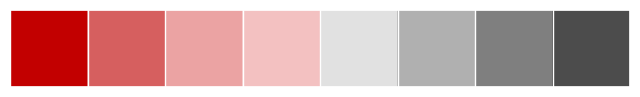

In [2]:
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
import os
import re
import time
import nltk
import torch
import timeit
import string
import random
import zipfile
import datetime
import textwrap
import torchtext
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import Image
from tqdm import tqdm
import tensorflow as tf
import matplotlib as mpl
import scipy.stats as st
import missingno as msno
from tqdm.auto import tqdm
from rich.text import Text
import plotly.express as px
from tensorflow import keras
from bs4 import BeautifulSoup
from string import punctuation
from collections import Counter
import matplotlib.pyplot as plt
from rich.console import Console
from sklearn.utils import shuffle
from nltk.corpus import stopwords
from transformers import pipeline
import matplotlib.ticker as ticker 
import tensorflow_datasets as tfds
from keras.models import Sequential
from torchtext import data, datasets
from keras.layers import Dense, Dropout
from IPython.display import display, HTML
from ydata_profiling import ProfileReport
from wordcloud import WordCloud, STOPWORDS
from matplotlib.ticker import NullFormatter
from matplotlib.ticker import FuncFormatter
from IPython.display import HTML, display, Markdown
from tensorflow.keras import regularizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from torch.utils.data import TensorDataset, DataLoader, RandomSampler, SequentialSampler, TensorDataset
from tensorflow.keras.layers import Embedding, SpatialDropout1D, Bidirectional, LSTM, Dense, Dropout
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import ToktokTokenizer
from nltk.stem.porter import PorterStemmer
from nltk.tokenize.toktok import ToktokTokenizer
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer,TfidfTransformer
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from transformers import DistilBertForSequenceClassification, AdamW, DistilBertTokenizer, BertTokenizer, BertForSequenceClassification, AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
nltk.download('stopwords')
sns.set(color_codes = True)   
sns.set_palette(palette = 'RdGy', n_colors = 8)
colors = ["#C20000", "#D65F5F", "#EBA3A3", "#F3C1C1", "#E1E1E1", "#B0B0B0", "#7F7F7F", "#4C4C4C"]
sns.palplot(sns.color_palette(colors))
sns.set(style="whitegrid")

In [3]:
data = pd.read_csv('/kaggle/input/sephora-products-and-skincare-reviews/product_info.csv')

In [4]:
df = pd.DataFrame(data)
df

,product_id,product_name,brand_id,brand_name,loves_count,rating,reviews,size,variation_type,variation_value,...,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price
0,P473671,Fragrance Discovery Set,6342,19-69,6320,3.6364,11.0,NaN,NaN,NaN,...,1,0,0,"['Unisex/ Genderless Scent', 'Warm &Spicy Scen...",Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
1,P473668,La Habana Eau de Parfum,6342,19-69,3827,4.1538,13.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,85.0,30.0
2,P473662,Rainbow Bar Eau de Parfum,6342,19-69,3253,4.2500,16.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
3,P473660,Kasbah Eau de Parfum,6342,19-69,3018,4.4762,21.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
4,P473658,Purple Haze Eau de Parfum,6342,19-69,2691,3.2308,13.0,3.4 oz/ 100 mL,Size + Concentration + Formulation,3.4 oz/ 100 mL,...,1,0,0,"['Unisex/ Genderless Scent', 'Layerable Scent'...",Fragrance,Women,Perfume,2,75.0,30.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8489,P467659,Couture Clutch Eyeshadow Palette,1070,Yves Saint Laurent,2790,4.4286,7.0,NaN,NaN,NaN,...,0,0,0,NaN,Makeup,Eye,Eye Palettes,0,NaN,NaN
8490,P500874,L'Homme Eau de Parfum,1070,Yves Saint Laurent,2319,4.6367,556.0,2 oz / 60 mL,Size + Concentration + Formulation,2 oz / 60 mL eau de parfum spray,...,0,0,0,"['Layerable Scent', 'Woody & Earthy Scent']",Fragrance,Men,Cologne,1,129.0,129.0
8491,P504428,Mon Paris Eau de Parfum Gift Set,1070,Yves Saint Laurent,1475,5.0000,2.0,NaN,NaN,NaN,...,1,1,0,NaN,Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
8492,P504448,Y Eau de Parfum Gift Set,1070,Yves Saint Laurent,840,NaN,NaN,NaN,NaN,NaN,...,1,0,0,NaN,Fragrance,Value & Gift Sets,Cologne Gift Sets,0,NaN,NaN


In [5]:
# separating the skincare-related data from other categories such as makeup to ensure precise analysis and insights
string_to_check =['Remover' , 'remover' , 'Cleanser' , 'cleanser' , 'Make up cleanser' , 'bb cream' , 'bbcream' , 'BB' , 'Mask' , 'Masks' , 'mask' , 'Lip balm' , 'lip balm' , 'balm' , 'Gel' , 'gel' , 'make up remover' , 'Make up remover' ,'Hairdresser', 'Curl','Repair','Thickening',"Hairdresser",'Heat' ,'shampoo','Shampoo','hair','haircare','Haircare','Style','Styler','style','scalp','Scalp','Conditioner','conditioner','Frizz']
df = df[df['product_name'].str.contains('|'.join(string_to_check))]
df.reset_index()

,index,product_id,product_name,brand_id,brand_name,loves_count,rating,reviews,size,variation_type,...,online_only,out_of_stock,sephora_exclusive,highlights,primary_category,secondary_category,tertiary_category,child_count,child_max_price,child_min_price
0,18,P483068,ABBOTT Sampler Set,6485,ABBOTT,4493,4.8163,49.0,NaN,NaN,...,0,1,0,"['Vegan', 'Woody & Earthy Scent', 'Clean + Pla...",Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN
1,47,P474806,Blue Tansy Reparative Mask,6321,adwoa beauty,14660,4.7581,492.0,16 oz/ 453 mg,Size,...,0,0,1,"['Good for: Damage', 'Good for: Color Care', '...",Hair,Hair Styling & Treatments,Hair Masks,0,NaN,NaN
2,48,P457233,Baomint Leave In Conditioning Styler,6321,adwoa beauty,13333,4.3472,144.0,14 oz/ 414 mL,Size,...,0,0,1,"['Clean at Sephora', 'All Hair Types', 'Curl-E...",Hair,Hair Styling & Treatments,Leave-In Conditioner,1,13.0,13.0
3,49,P474808,Blue Tansy Leave in Conditioning Styler,6321,adwoa beauty,11674,4.5762,210.0,14 oz/ 414 mL,Size,...,0,0,0,"['Good for: Damage', 'Vegan', 'Clean at Sephor...",Hair,Hair Styling & Treatments,Leave-In Conditioner,0,NaN,NaN
4,50,P457234,Baomint Moisturizing Shampoo,6321,adwoa beauty,11122,4.1324,136.0,14 oz/ 414 mL,Size,...,0,0,1,"['Unisex/ Genderless Scent', 'Clean at Sephora...",Hair,Shampoo & Conditioner,Shampoo,1,12.0,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1808,8404,P440307,Superberry Hydrate + Glow Dream Night Mask wit...,6169,Youth To The People,248887,4.3237,2354.0,2 oz/ 59 mL,Size,...,0,0,0,"['Vegan', 'Good for: Dullness/Uneven Texture',...",Skincare,Masks,Face Masks,1,18.0,18.0
1809,8405,P461555,Mini Superberry Hydrate + Glow Dream Mask,6169,Youth To The People,79524,4.3237,2354.0,0.5 oz/ 15 mL,Size,...,0,0,0,"['Good for: Dullness/Uneven Texture', 'allure ...",Skincare,Mini Size,NaN,0,NaN,NaN
1810,8418,P470065,Superclay Purify + Clear Power Mask with Niaci...,6169,Youth To The People,62672,4.4595,346.0,2.0 oz/ 60 mL,Size,...,0,0,0,"['Vegan', 'Best for Oily Skin', 'Good for: Por...",Skincare,Masks,Face Masks,0,NaN,NaN
1811,8460,P502049,Libre Eau de Parfum Lifestyle Gift Set,1070,Yves Saint Laurent,16392,4.0000,4.0,NaN,NaN,...,0,1,0,NaN,Fragrance,Value & Gift Sets,Perfume Gift Sets,0,NaN,NaN


In [6]:
df.columns

Index(['product_id', 'product_name', 'brand_id', 'brand_name', 'loves_count',
       'rating', 'reviews', 'size', 'variation_type', 'variation_value',
       'variation_desc', 'ingredients', 'price_usd', 'value_price_usd',
       'sale_price_usd', 'limited_edition', 'new', 'online_only',
       'out_of_stock', 'sephora_exclusive', 'highlights', 'primary_category',
       'secondary_category', 'tertiary_category', 'child_count',
       'child_max_price', 'child_min_price'],
      dtype='object')

In [7]:
df.shape

(1813, 27)

In [8]:
def check_df(df: object, head: object = 5) -> object:
    print("\nShape")
    print(df.shape)
    print("\nTypes")
    print(df.dtypes)
    print("\nNANs")
    print(df.isnull().sum())
    print("\nInfo")
    print(df.info())
check_df(df)


Shape
(1813, 27)

Types
product_id             object
product_name           object
brand_id                int64
brand_name             object
loves_count             int64
rating                float64
reviews               float64
size                   object
variation_type         object
variation_value        object
variation_desc         object
ingredients            object
price_usd             float64
value_price_usd       float64
sale_price_usd        float64
limited_edition         int64
new                     int64
online_only             int64
out_of_stock            int64
sephora_exclusive       int64
highlights             object
primary_category       object
secondary_category     object
tertiary_category      object
child_count             int64
child_max_price       float64
child_min_price       float64
dtype: object

NANs
product_id               0
product_name             0
brand_id                 0
brand_name               0
loves_count              0
rating    

In [9]:
print('Number of duplicated rows: ' , len(df[df.duplicated()]))

Number of duplicated rows:  0


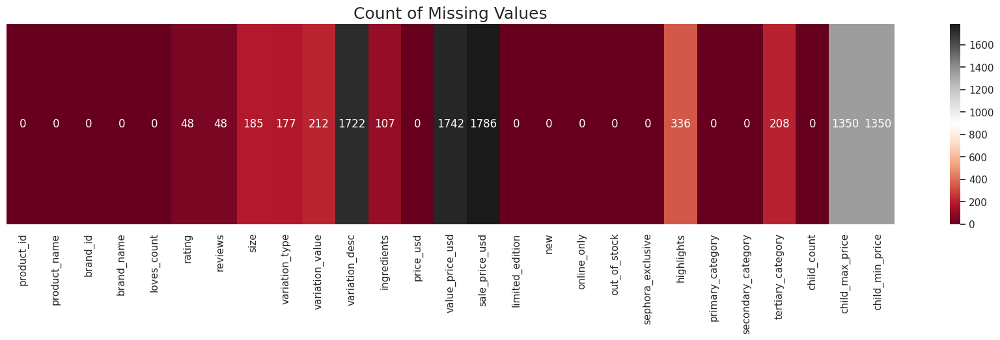

In [10]:
plt.figure(figsize=(22,4))
sns.heatmap((df.isna().sum()).to_frame(name='').T,cmap='RdGy', annot=True,
             fmt='0.0f').set_title('Count of Missing Values', fontsize=18)
plt.show()

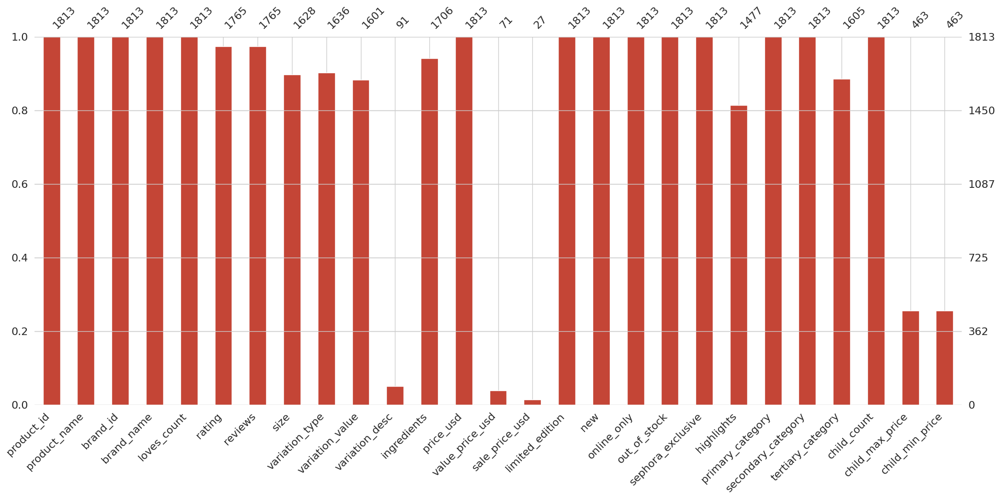

In [11]:
msno.bar(df, color='#C44536')
plt.show()

In [12]:
df.describe().T.style.background_gradient(cmap='RdGy', axis=1)

,count,mean,std,min,25%,50%,75%,max
brand_id,1813.000000,5840.567568,1239.040577,1065.000000,5972.000000,6201.000000,6346.000000,8020.000000
loves_count,1813.000000,20632.468836,45781.130164,0.000000,2966.000000,7877.000000,19870.000000,1081315.000000
rating,1765.000000,4.210648,0.502511,1.000000,4.000000,4.300000,4.546100,5.000000
reviews,1765.000000,387.971105,816.226752,1.000000,35.000000,138.000000,386.000000,16118.000000
price_usd,1813.000000,39.982791,55.011441,3.500000,22.000000,31.000000,44.000000,1900.000000
value_price_usd,71.000000,80.098592,54.563961,20.000000,46.000000,62.000000,90.500000,290.000000
sale_price_usd,27.000000,12.944074,8.219116,3.000000,7.000000,10.500000,18.995000,32.250000
limited_edition,1813.000000,0.028130,0.165390,0.000000,0.000000,0.000000,0.000000,1.000000
new,1813.000000,0.069498,0.254369,0.000000,0.000000,0.000000,0.000000,1.000000
online_only,1813.000000,0.258687,0.438034,0.000000,0.000000,0.000000,1.000000,1.000000


In [13]:
# finding unique data
df.apply(lambda x: len(x.unique()))

product_id            1813
product_name          1796
brand_id               196
brand_name             196
loves_count           1735
rating                1289
reviews                662
size                   537
variation_type           7
variation_value        551
variation_desc          75
ingredients           1490
price_usd              154
value_price_usd         46
sale_price_usd          20
limited_edition          2
new                      2
online_only              2
out_of_stock             2
sephora_exclusive        2
highlights            1107
primary_category         8
secondary_category      34
tertiary_category       80
child_count             18
child_max_price         99
child_min_price         79
dtype: int64

In [14]:
# Converting int DataYypes to boolean
df['limited_edition'] = df['limited_edition'].astype(bool)
df['new']= df['new'].astype(bool)
df['online_only']= df['online_only'].astype(bool)
df['out_of_stock'] = df['out_of_stock'].astype(bool)
df['sephora_exclusive'] = df['sephora_exclusive'].astype(bool)
df[['limited_edition', 'new', 'online_only', 'out_of_stock', 'sephora_exclusive']]

,limited_edition,new,online_only,out_of_stock,sephora_exclusive
18,False,False,False,True,False
47,False,False,False,False,True
48,False,False,False,False,True
49,False,False,False,False,False
50,False,False,False,False,True
...,...,...,...,...,...
8404,False,False,False,False,False
8405,False,False,False,False,False
8418,False,False,False,False,False
8460,True,False,False,True,False


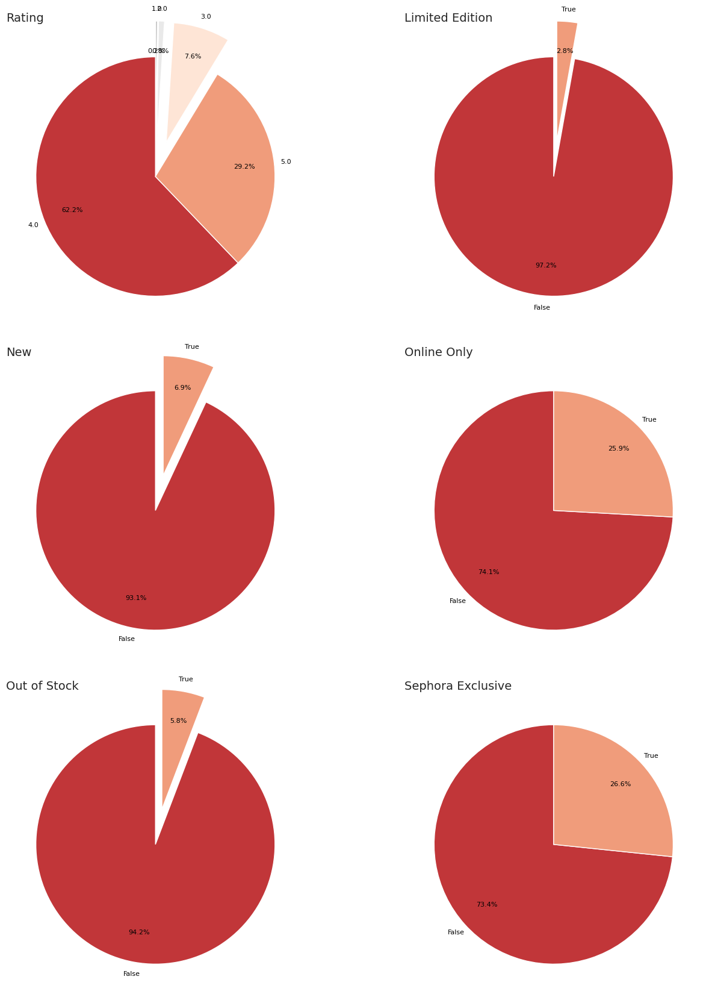

In [15]:
df5 = df.copy()
df5['rounded_rating'] = df5['rating'].round()
fig, ax = plt.subplots(figsize=(15, 17), nrows=3, ncols=2)
sns.set_palette("RdGy")
columns = ['rounded_rating', 'limited_edition', 'new', 'online_only', 'out_of_stock', 'sephora_exclusive']
titles = ['Rating', 'Limited Edition', 'New', 'Online Only', 'Out of Stock', 'Sephora Exclusive']
def get_explode(values, threshold=10):
    total = sum(values)
    return [0.3 if (v / total) * 100 < threshold else 0 for v in values]

for i, column in enumerate(columns):
    row = i // 2
    col = i % 2
    values = df5[column].value_counts()
    explode = get_explode(values)
    values.plot.pie(
        autopct='%1.1f%%', ax=ax[row, col], startangle=90,
        textprops={'color': 'black', 'fontsize': 8, 'ha': 'center', 'va': 'center'},
        pctdistance=0.75,
        explode=explode
    )
    ax[row, col].set_title(titles[i], fontsize=14, loc='left')
    ax[row, col].set_ylabel('')
plt.tight_layout(pad=2.0)
plt.show()

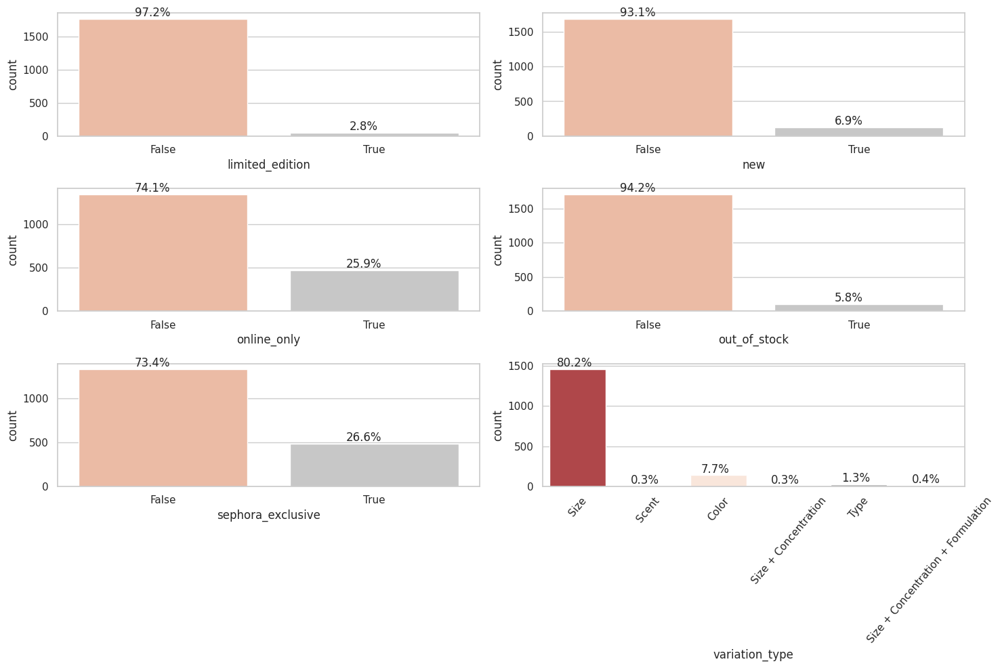

In [16]:
figure, axes = plt.subplots(3, 2, figsize=(15, 10))
dfff = ['limited_edition', 'new', 'online_only', 'out_of_stock', 'sephora_exclusive','variation_type']
palette = 'RdGy'
for i, genre in enumerate(dfff):
    row = i // 2
    col = i % 2
    ax = sns.countplot(ax=axes[row, col], x=df[genre], palette=palette)
    total = len(df[genre])
    for p in ax.patches:
        percentage = '{:.1f}%'.format(100 * p.get_height() / total)
        x = p.get_x() + p.get_width() / 2 - 0.05
        y = p.get_height()
        ax.annotate(percentage, (x, y), ha='center', va='bottom')
plt.xticks(rotation=50)
plt.tight_layout()
plt.show()

In [17]:
unique = df.nunique().sort_values()
unique_values = df.apply(lambda x: x.unique())
pd.DataFrame({'Number of Unique Values': unique, 'Unique Values': unique_values})

,Number of Unique Values,Unique Values
brand_id,196,"[6485, 6321, 7054, 6018, 6283, 6312, 5998, 710..."
brand_name,196,"[ABBOTT, adwoa beauty, AERIN, Algenist, Alpha-..."
child_count,18,"[0, 1, 2, 6, 15, 4, 25, 9, 5, 3, 10, 7, 13, 17..."
child_max_price,98,"[nan, 13.0, 12.0, 14.0, 23.0, 54.0, 36.0, 55.0..."
child_min_price,78,"[nan, 13.0, 12.0, 14.0, 23.0, 54.0, 36.0, 55.0..."
highlights,1106,"[['Vegan', 'Woody & Earthy Scent', 'Clean + Pl..."
ingredients,1489,"[['Big Sky:', 'Water, Denatured Ethyl Alcohol,..."
limited_edition,2,"[False, True]"
loves_count,1735,"[4493, 14660, 13333, 11674, 11122, 10753, 9921..."
new,2,"[False, True]"


In [18]:
ProfileReport(df, title='Products Dataset Report', minimal=True, progress_bar=False, samples=None, correlations=None, interactions=None, explorative=True, dark_mode=True, notebook={'iframe':{'height': '600px'}}, html={'style':{'primary_color': '#C44536'}}, missing_diagrams={'heatmap': False, 'dendrogram': False}).to_notebook_iframe()

In [19]:
# Dropping non-numerical data
hm = df.drop(columns=['limited_edition', 'new', 'online_only',
       'out_of_stock', 'sephora_exclusive', 'highlights', 'primary_category',
       'secondary_category', 'tertiary_category', 'child_count',
       'child_max_price', 'child_min_price', 'product_name', 'brand_name', 'ingredients', 'variation_type', 'variation_value', 'variation_desc'])

In [20]:
hm.corr(numeric_only=True).T.style.background_gradient(cmap='RdGy', axis=1)

,brand_id,loves_count,rating,reviews,price_usd,value_price_usd,sale_price_usd
brand_id,1.000000,-0.018246,0.014293,-0.086881,-0.018328,-0.136205,0.147111
loves_count,-0.018246,1.000000,0.034695,0.765419,-0.035963,-0.156915,-0.156811
rating,0.014293,0.034695,1.000000,0.100490,0.018267,-0.010512,-0.361697
reviews,-0.086881,0.765419,0.100490,1.000000,-0.034668,0.173900,-0.139509
price_usd,-0.018328,-0.035963,0.018267,-0.034668,1.000000,0.742785,0.943712
value_price_usd,-0.136205,-0.156915,-0.010512,0.173900,0.742785,1.000000,0.800261
sale_price_usd,0.147111,-0.156811,-0.361697,-0.139509,0.943712,0.800261,1.000000


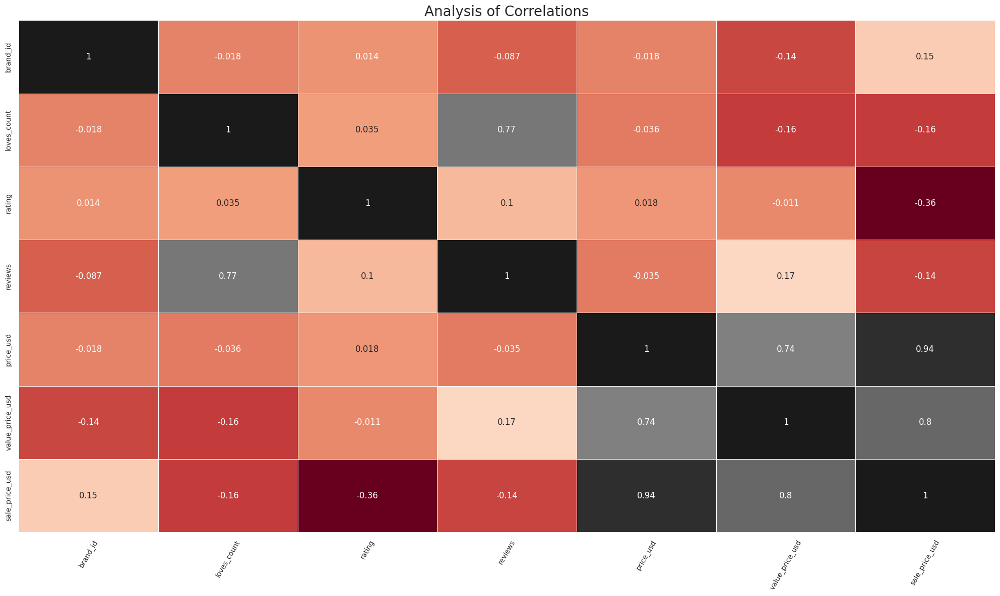

In [21]:
plt.figure(figsize=(20, 12))
sns.heatmap(hm.corr(numeric_only=True), cmap="RdGy", annot=True, linewidths=.6 , cbar = False)
plt.xticks(rotation=60, size=10)
plt.yticks(size=10)
plt.title('Analysis of Correlations', size=20)
plt.tight_layout()
plt.show()

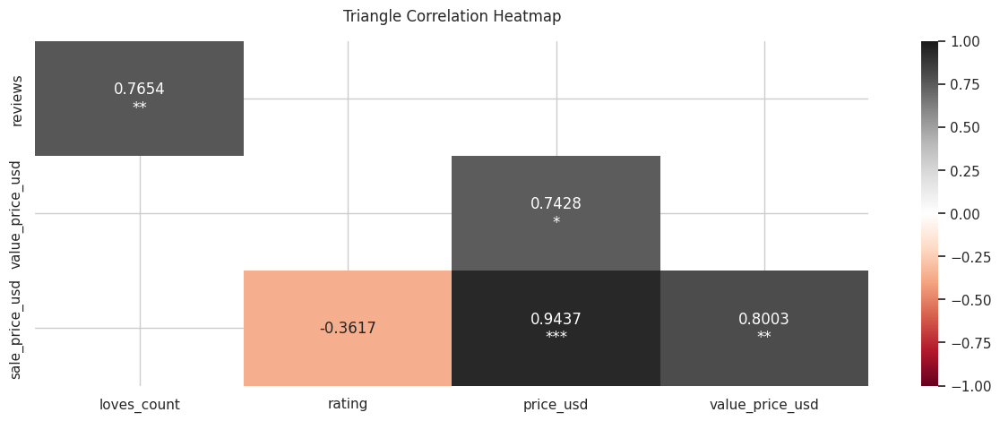

In [22]:
corr = hm.corr(numeric_only=True)
f, ax = plt.subplots(figsize=(15, 5))
mask = np.triu(np.ones_like(corr, dtype=bool))
cut_off = 0.25
extreme_1 = 0.5
extreme_2 = 0.75
extreme_3 = 0.9
mask |= np.abs(corr) < cut_off
corr = corr[~mask]
remove_empty_rows_and_cols = True
if remove_empty_rows_and_cols:
    wanted_cols = np.flatnonzero(np.count_nonzero(~mask, axis=1))
    wanted_rows = np.flatnonzero(np.count_nonzero(~mask, axis=0))
    corr = corr.iloc[wanted_cols, wanted_rows]

annot = [[f"{val:.4f}"
          + ('' if abs(val) < extreme_1 else '\n*')
          + ('' if abs(val) < extreme_2 else '*')
          + ('' if abs(val) < extreme_3 else '*')
          for val in row] for row in corr.to_numpy()]
heatmap = sns.heatmap(corr, vmin=-1, vmax=1, annot=annot, fmt='', cmap='RdGy')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize': 12}, pad=16)
plt.show()

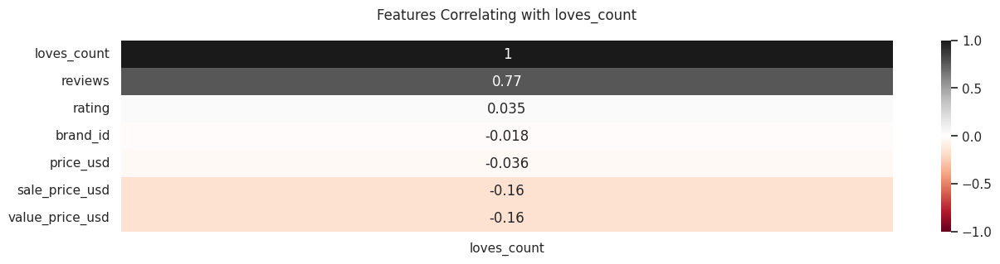

In [23]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['loves_count']].sort_values (by = 'loves_count', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with loves_count', fontdict = {'fontsize':12} , pad = 18);

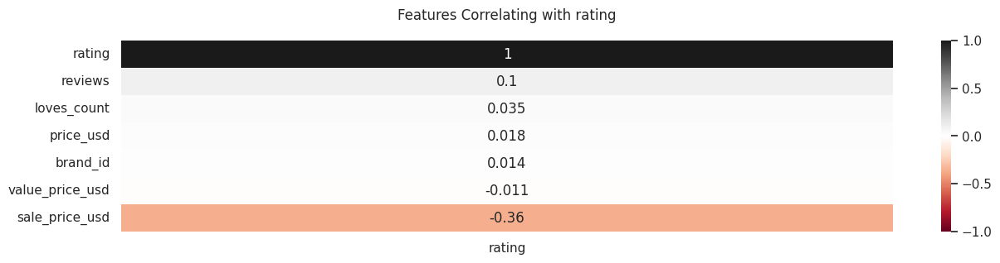

In [24]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['rating']].sort_values (by = 'rating', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with rating', fontdict = {'fontsize':12} , pad = 18);

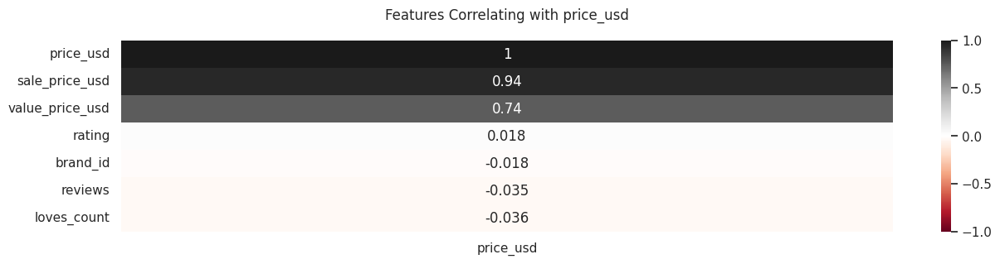

In [25]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['price_usd']].sort_values (by = 'price_usd', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with price_usd', fontdict = {'fontsize':12} , pad = 18);

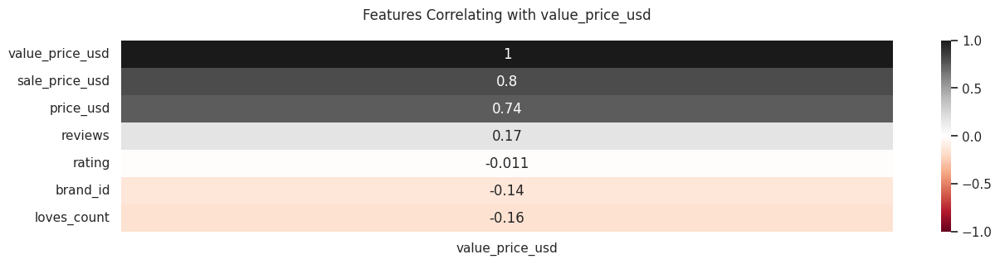

In [26]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hm.corr(numeric_only=True)[['value_price_usd']].sort_values (by = 'value_price_usd', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with value_price_usd', fontdict = {'fontsize':12} , pad = 18);

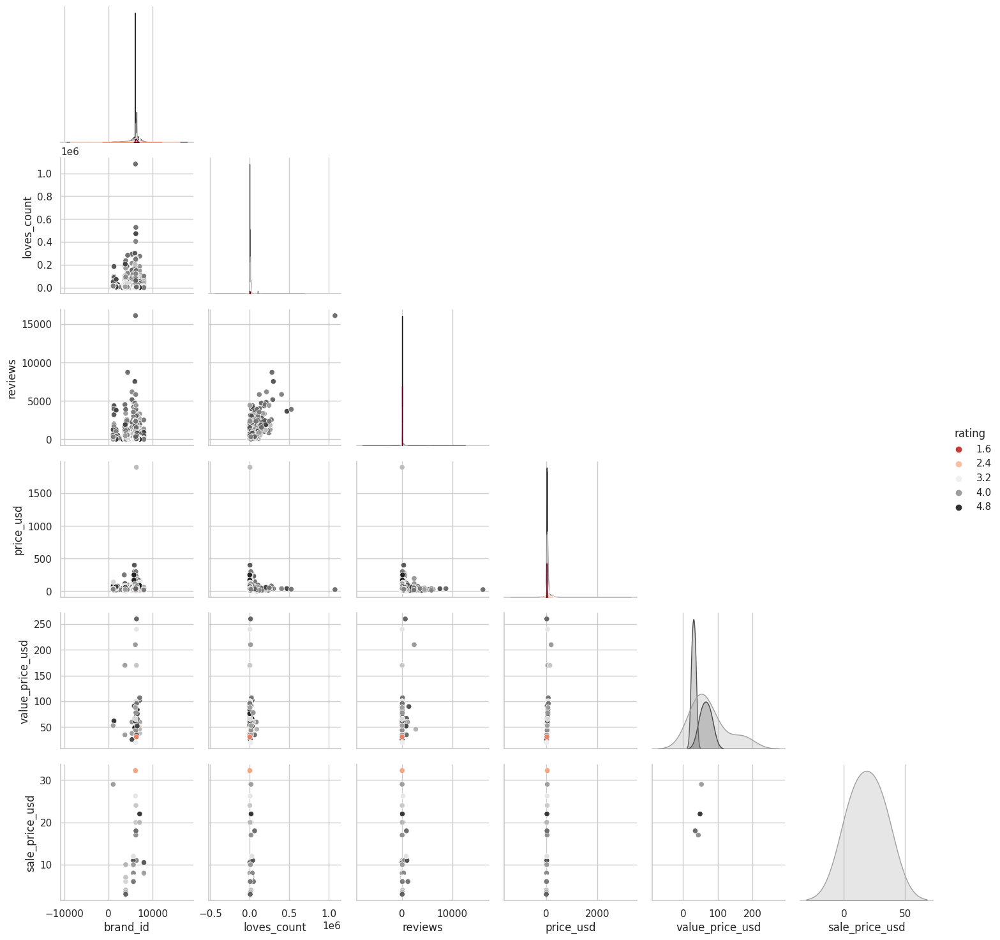

In [27]:
sns.pairplot(data=hm, diag_kind='kde', hue='rating', palette='RdGy',corner=True)
plt.show()

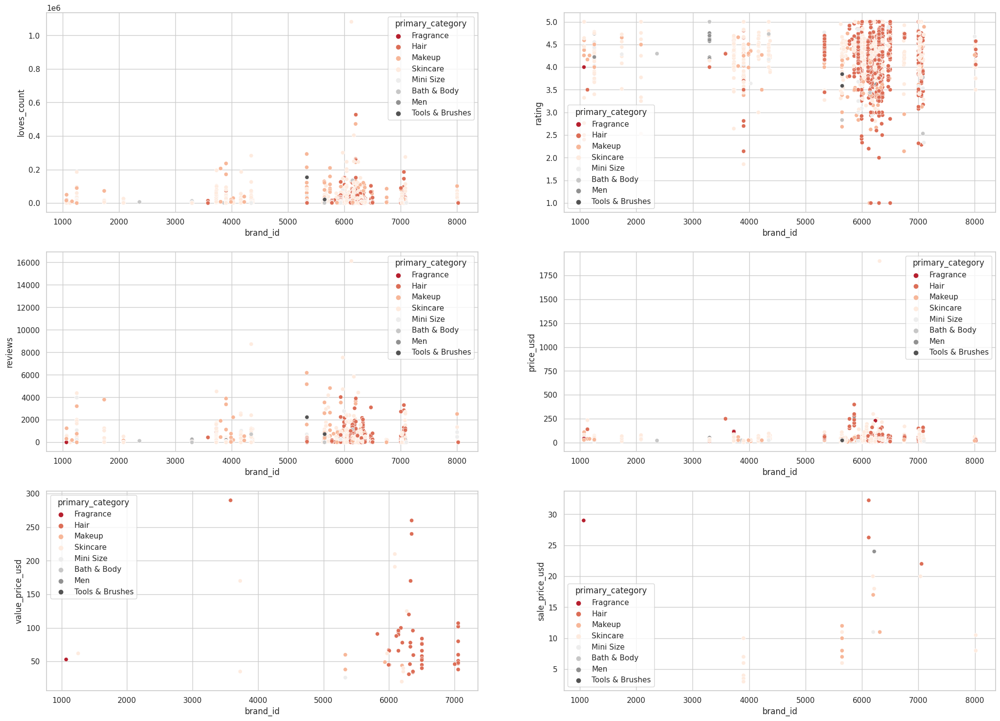

In [28]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='brand_id',y=col,hue='primary_category',data=df,palette="RdGy")

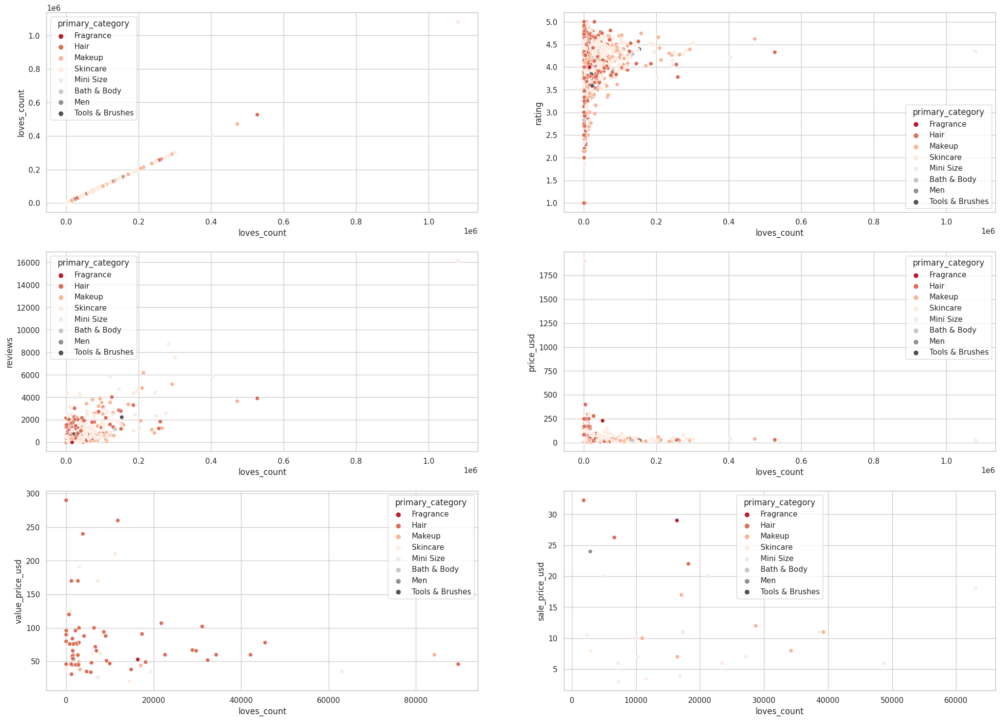

In [29]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='loves_count',y=col,hue='primary_category',data=df,palette="RdGy")

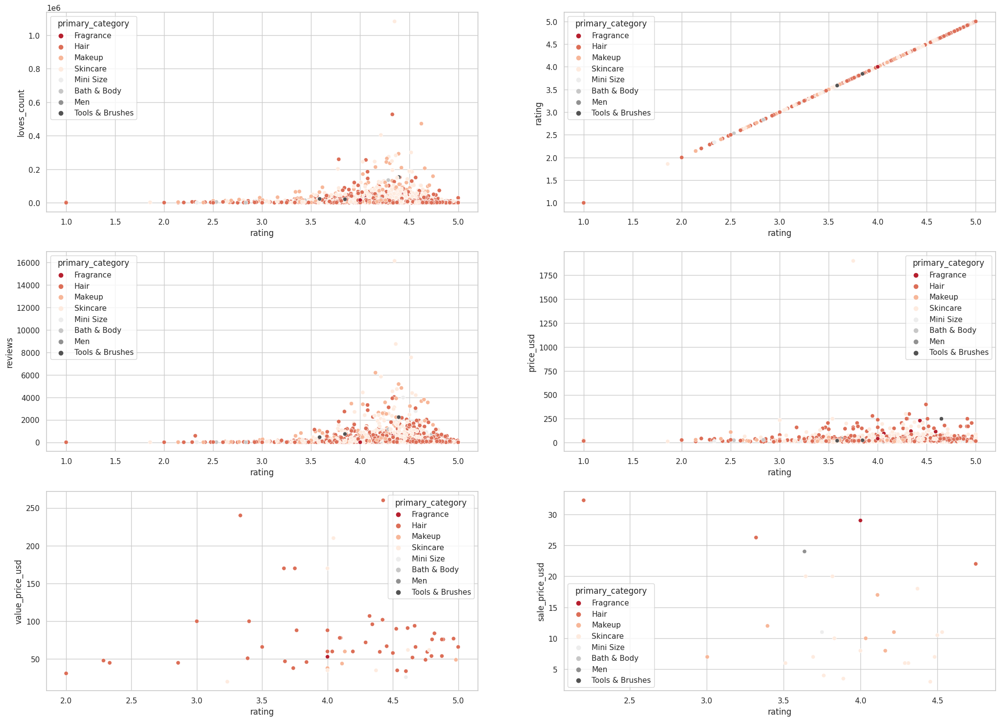

In [30]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='rating',y=col,hue='primary_category',data=df,palette="RdGy")

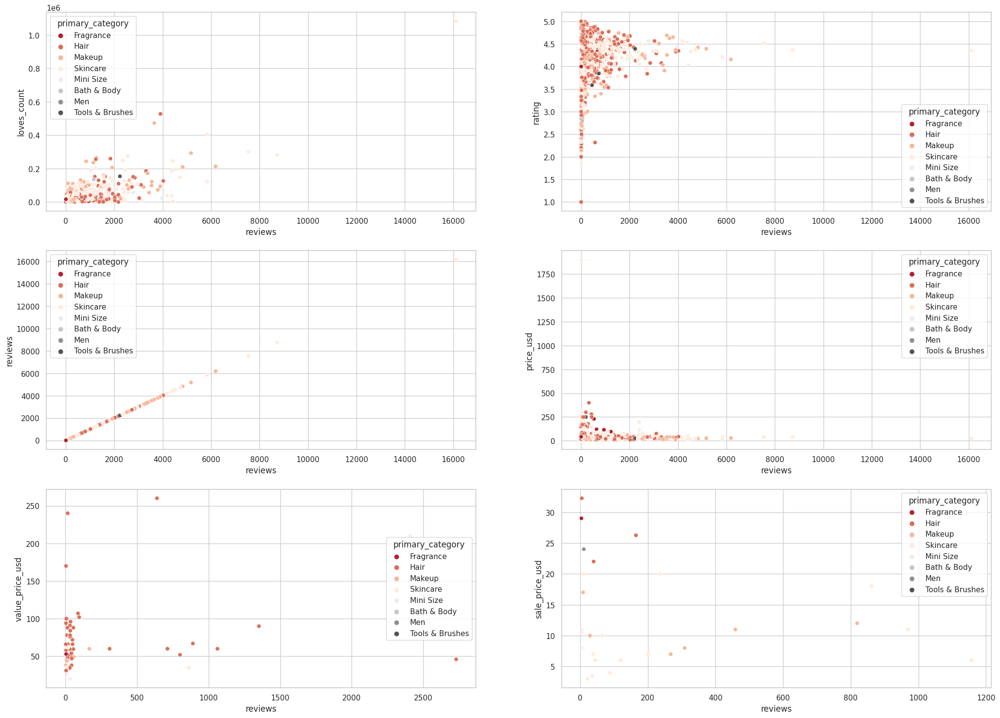

In [31]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='reviews',y=col,hue='primary_category',data=df,palette="RdGy")

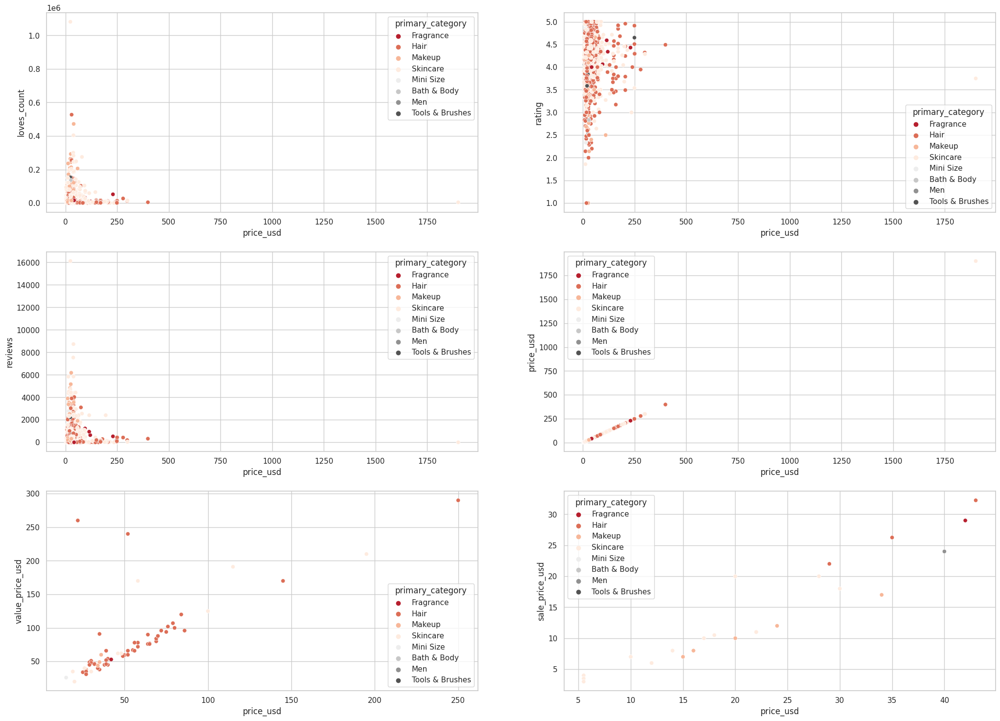

In [32]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='price_usd',y=col,hue='primary_category',data=df,palette="RdGy")

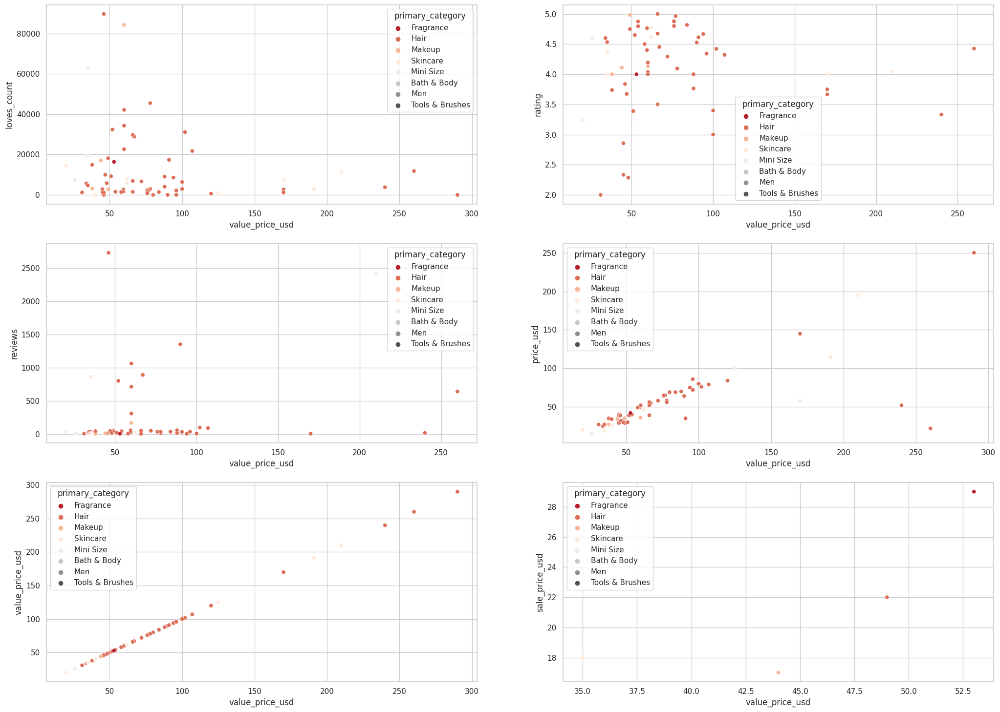

In [33]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='value_price_usd',y=col,hue='primary_category',data=df,palette="RdGy")

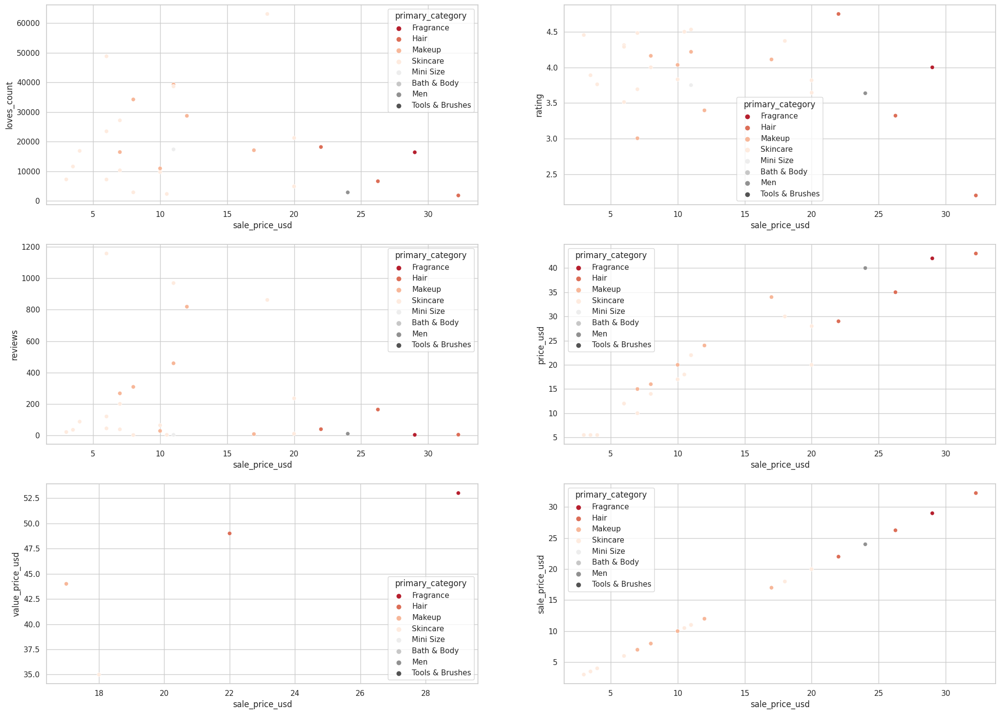

In [34]:
ff = ['loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='sale_price_usd',y=col,hue='primary_category',data=df,palette="RdGy")

In [35]:
fig = px.scatter_3d(df, x='loves_count', y='rating', z='reviews', color='primary_category', color_continuous_scale="RdGy", template = 'plotly_white')
fig.update_traces(marker=dict(size=5))
fig.show()

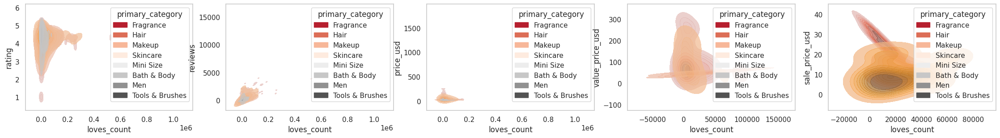

In [36]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='loves_count', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='loves_count', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='loves_count', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='loves_count', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='loves_count', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

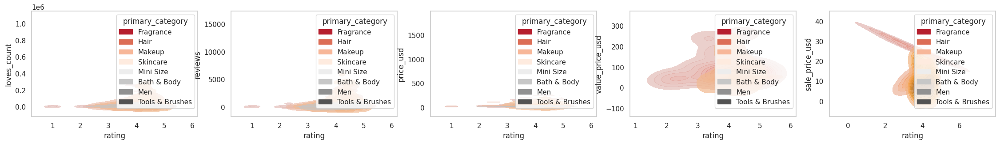

In [37]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='rating', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='rating', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='rating', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='rating', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='rating', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

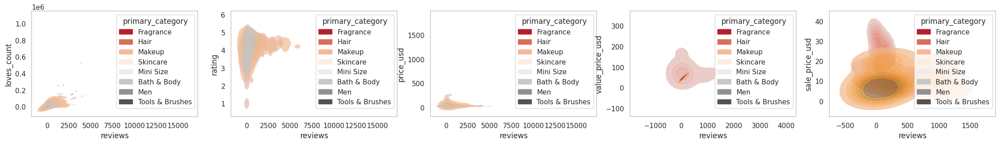

In [38]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='reviews', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='reviews', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='reviews', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='reviews', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='reviews', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

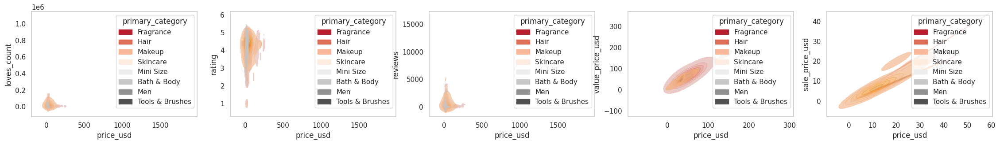

In [39]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(28,18))
plt.subplot(5,5,1)
sns.kdeplot(data=df,x='price_usd', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,2)
sns.kdeplot(data=df,x='price_usd', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,3)
sns.kdeplot(data=df,x='price_usd', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,4)
sns.kdeplot(data=df,x='price_usd', y='value_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(5,5,5)
sns.kdeplot(data=df,x='price_usd', y='sale_price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

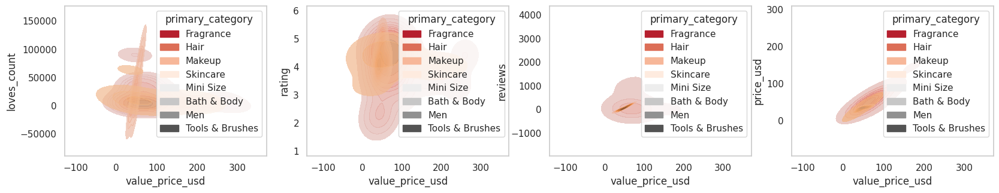

In [40]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(20,15))
plt.subplot(4,4,1)
sns.kdeplot(data=df,x='value_price_usd', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(4,4,2)
sns.kdeplot(data=df,x='value_price_usd', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(4,4,3)
sns.kdeplot(data=df,x='value_price_usd', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(4,4,4)
sns.kdeplot(data=df,x='value_price_usd', y='price_usd', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

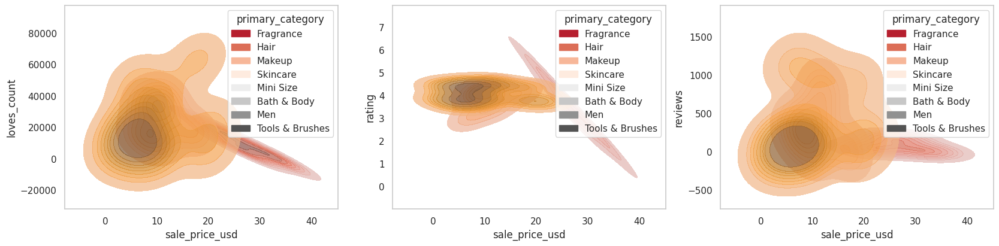

In [41]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(20,15))
plt.subplot(3,3,1)
sns.kdeplot(data=df,x='sale_price_usd', y='loves_count', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(3,3,2)
sns.kdeplot(data=df,x='sale_price_usd', y='rating', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()
plt.subplot(3,3,3)
sns.kdeplot(data=df,x='sale_price_usd', y='reviews', hue='primary_category',color='r',alpha=.7,weights=None,fill=True,multiple='fill',palette='RdGy')
plt.grid()

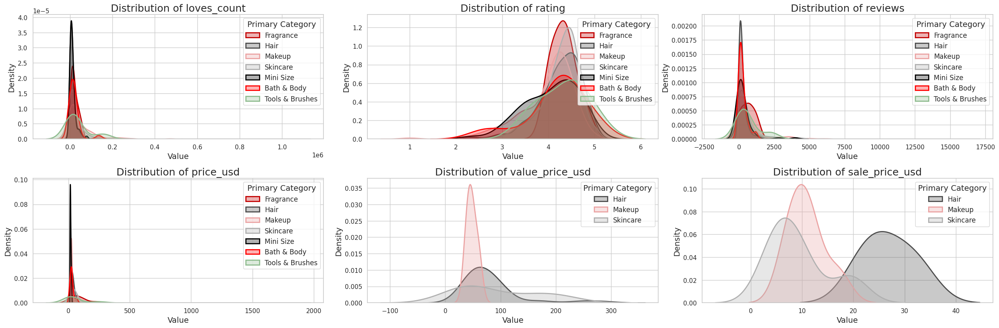

In [42]:
sns.set(style="whitegrid")
fig = plt.figure(figsize=(25, 20))
colors = {
    'Fragrance': '#C20000',
    'Hair': '#4C4C4C',
    'Makeup': '#EBA3A3',
    'Skincare': '#B0B0B0',
    'Mini Size': 'black',
    'Bath & Body': 'red',
    'Tools & Brushes': 'darkseagreen'}
for i, col in enumerate(ff):
    ax = fig.add_subplot(5, 3, i + 1)
    for category, color in colors.items():
        category_data = df[df['primary_category'] == category][col]
        if not category_data.empty:
            sns.kdeplot(
                category_data,
                color=color,
                label=category,
                linewidth=2,
                fill=True,
                alpha=0.3)
    ax.set_title(f'Distribution of {col}', fontsize=18)
    ax.set_xlabel("Value", fontsize=14)
    ax.set_ylabel("Density", fontsize=14)
    ax.legend(title='Primary Category', fontsize=12, title_fontsize=14)
plt.tight_layout()
plt.show()

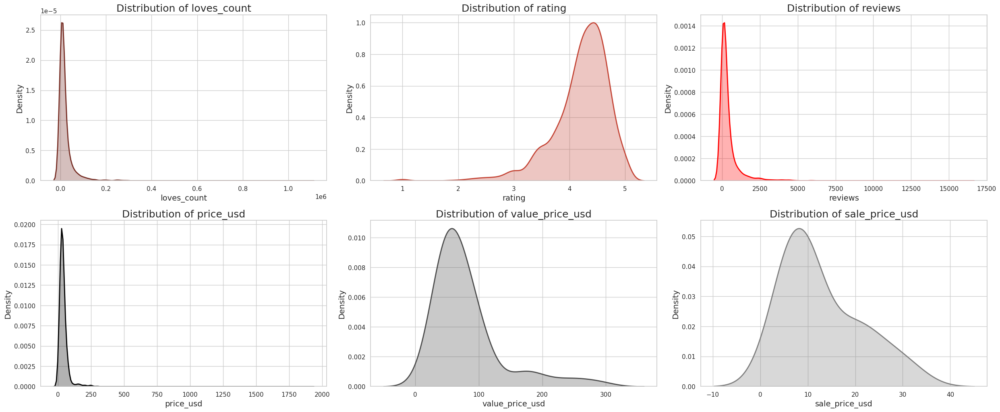

In [43]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(25, 15))
colors = {
    'loves_count': '#772E25',
    'rating': '#C44536',
    'reviews': 'red',
    'price_usd': '#000000',
    'value_price_usd': '#4C4C4C',
    'sale_price_usd': '#7F7F7F'}
features = ['loves_count', 'rating', 'reviews', 'price_usd', 'value_price_usd', 'sale_price_usd']
for i, feature in enumerate(features):
    ax = plt.subplot(3, 3, i + 1)  
    sns.kdeplot(df[feature], color=colors[feature], linewidth=2, fill=True, alpha=0.3)
    ax.set_title(f'Distribution of {feature}', fontsize=18)
    ax.set_xlabel(feature, fontsize=14)
    ax.set_ylabel('Density', fontsize=14)
plt.tight_layout()
plt.show()

In [44]:
# measure of skewness
df[ff].skew(axis = 0, skipna = True) 

loves_count        10.104482
rating             -1.585977
reviews             7.260202
price_usd          22.253801
value_price_usd     2.107245
sale_price_usd      0.910900
dtype: float64

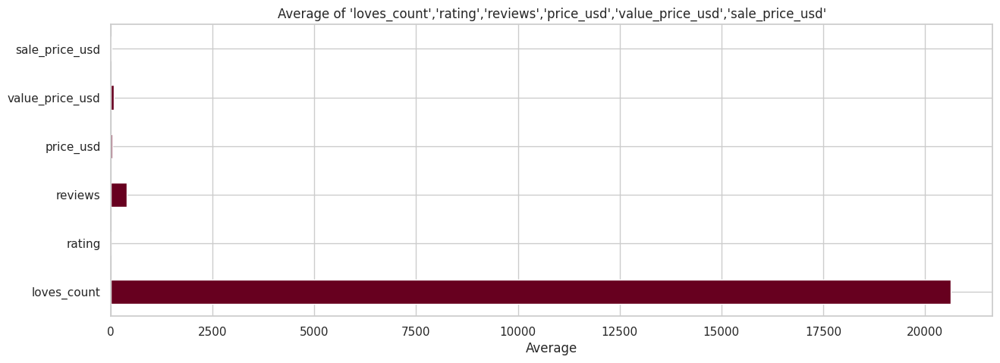

In [45]:
df_mean = df[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(15, 5), cmap="RdGy")
plt.xlabel('Average')
plt.title("Average of 'loves_count','rating','reviews','price_usd','value_price_usd','sale_price_usd'")
plt.show()

<Axes: >

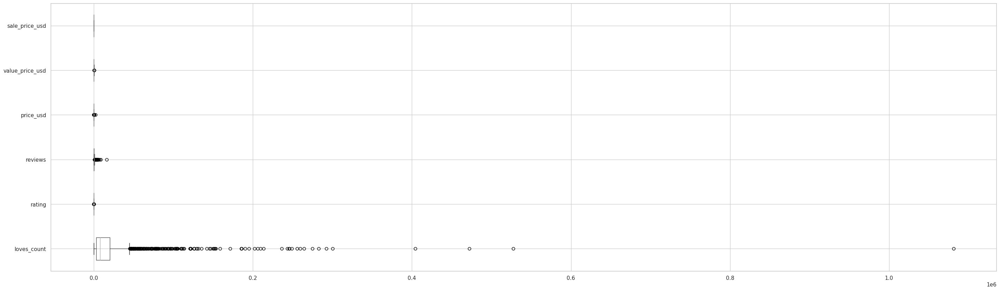

In [46]:
df[ff].boxplot(figsize=(35,10),vert=False)

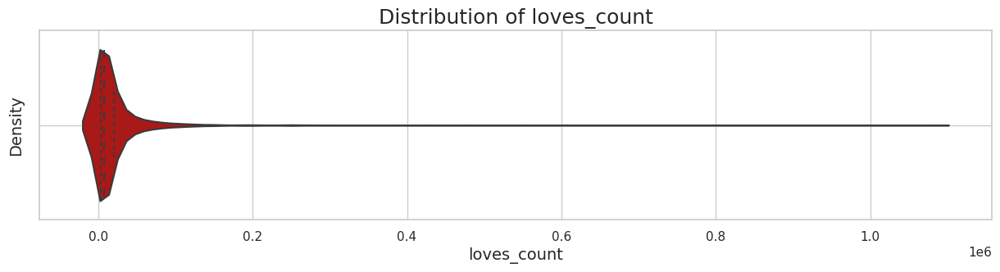

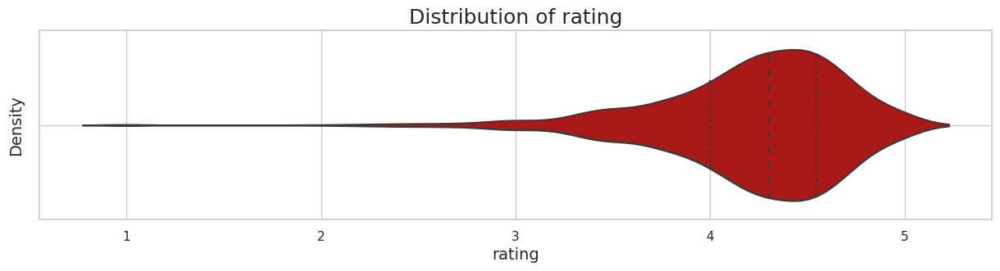

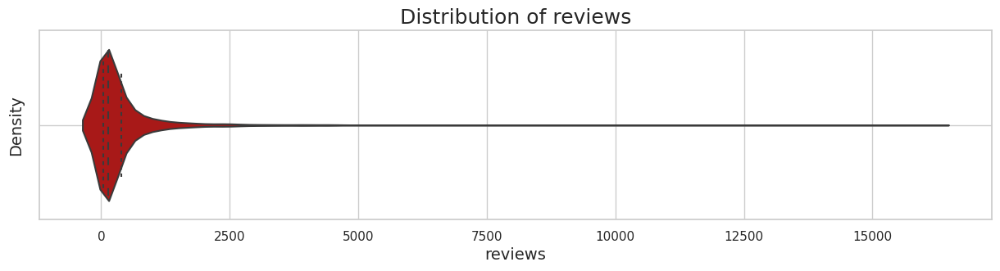

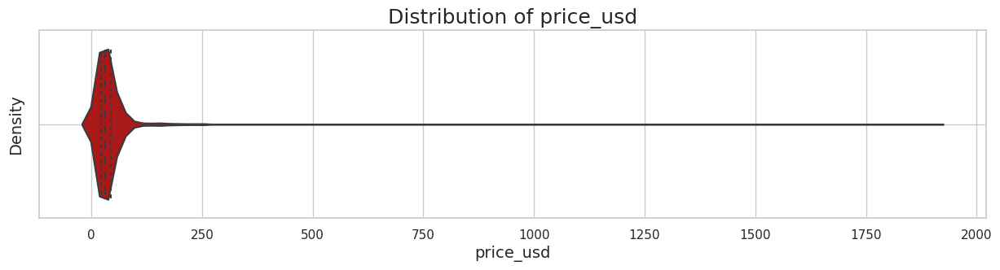

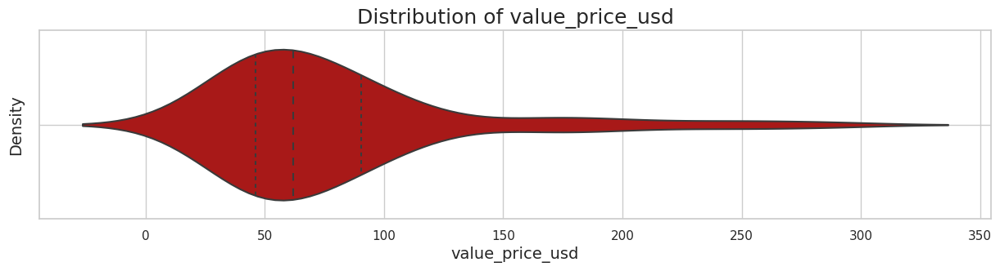

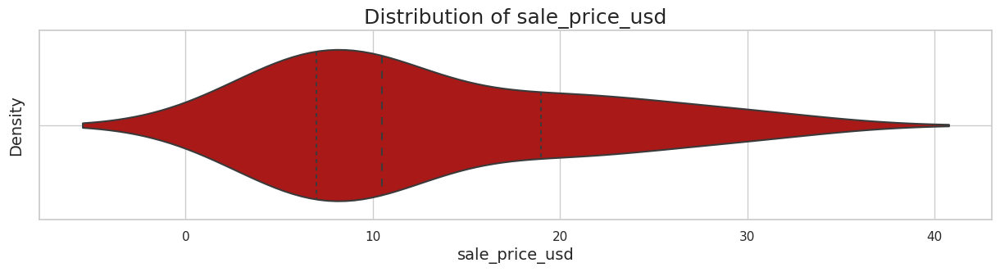

In [47]:
palette = "gist_heat"
for column in ff:
    plt.figure(figsize=(15, 3)) 
    sns.violinplot(x=df[column], palette=palette, inner="quartile")  
    plt.title(f'Distribution of {column}', fontsize=18)
    plt.xlabel(column, fontsize=14)
    plt.ylabel('Density', fontsize=14)
    plt.grid(True)
    plt.show()

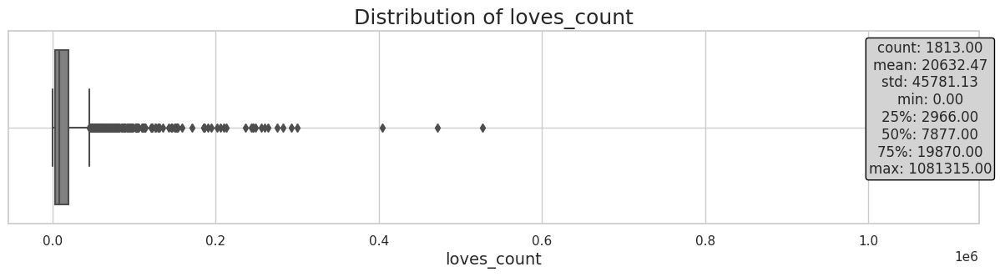

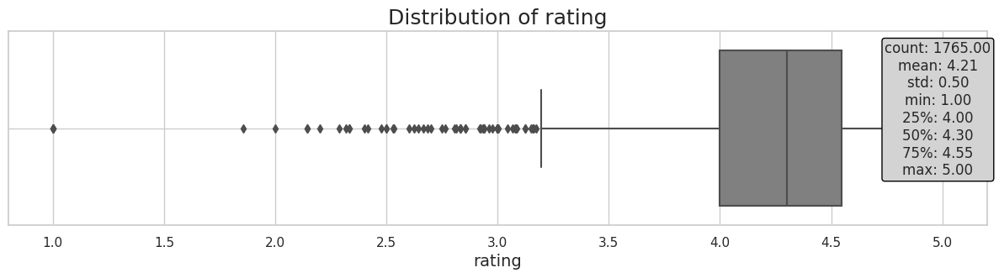

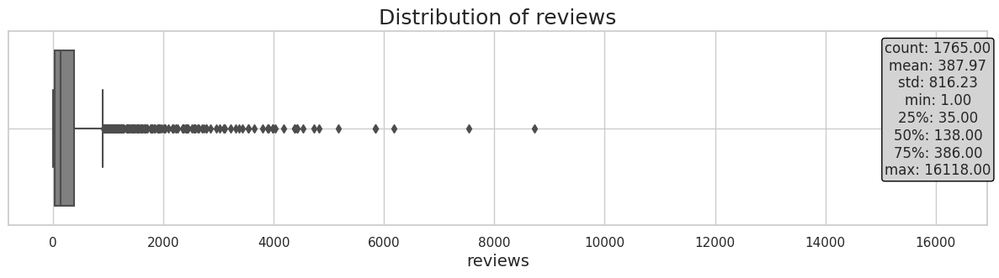

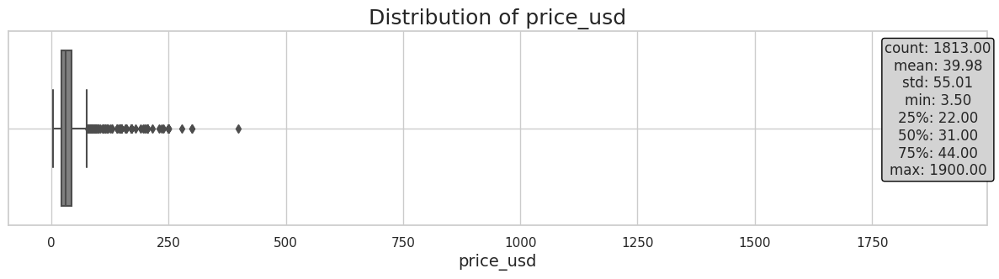

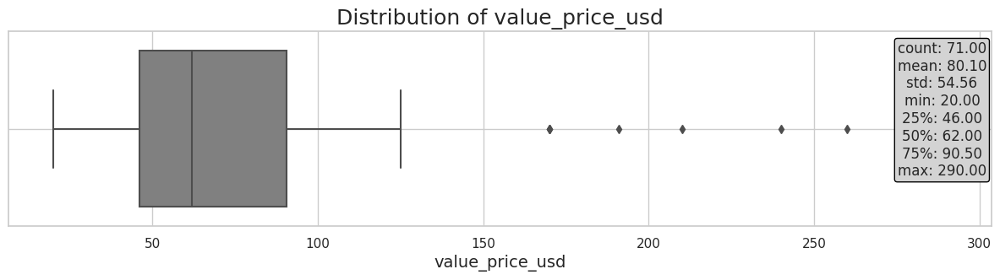

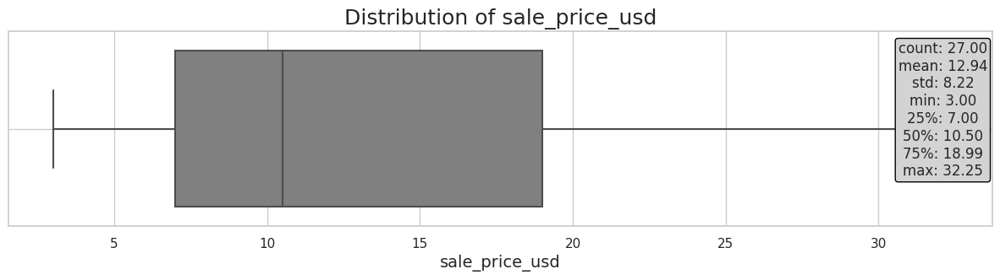

In [48]:
palette = "gray" 
for column in ff:
    plt.figure(figsize=(15, 3)) 
    sns.boxplot(x=df[column], palette=palette)
    plt.title(f'Distribution of {column}', fontsize=18)
    plt.xlabel(column, fontsize=14)
    stats = df[column].describe()
    stats_text = "\n".join([f"{key}: {value:.2f}" for key, value in stats.items()])
    plt.text(0.95, 0.95, stats_text, transform=plt.gca().transAxes, 
             fontsize=12, verticalalignment='top', 
             horizontalalignment='center', bbox=dict(boxstyle='round,pad=0.2', edgecolor='black', facecolor='lightgrey'))
    plt.grid(True) 
    plt.show()

In [49]:
def StDev_method (df,n,features):
    outliers = []
    for column in features:
        data_mean = df[column].mean()
        data_std = df[column].std()
        cut_off = data_std * 3     
        outlier_list_column = df[(df[column] < data_mean - cut_off) | (df[column] > data_mean + cut_off)].index
        outliers.extend(outlier_list_column)
    outliers = Counter(outliers)        
    OUT= list( k for k, v in outliers.items() if v > n )
    df1 = df[df[column] > data_mean + cut_off]
    df2 = df[df[column] < data_mean - cut_off]
    print('Total number of outliers is:', df1.shape[0]+ df2.shape[0])
    
    return OUT  
Outliers_StDev = StDev_method(df,1,ff)
df_out2 = df.drop(Outliers_StDev, axis = 0).reset_index(drop=True)

Total number of outliers is: 0


<Figure size 2700x720 with 0 Axes>

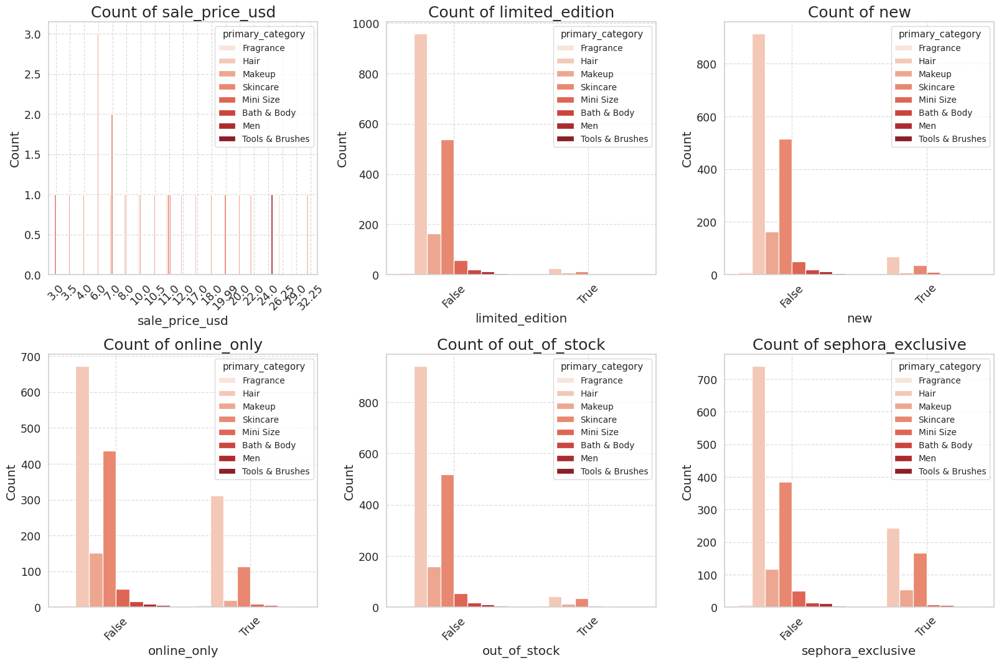

In [50]:
# List of variables for count plots
count_vars = [ 
    'sale_price_usd', 
    'limited_edition', 
    'new', 
    'online_only', 
    'out_of_stock', 
    'sephora_exclusive', ]
# General figure settings
plt.figure(figsize=(30, 8), dpi=90)
# Create a grid of subplots
n_cols = 3  # Number of columns
n_rows = (len(count_vars) + n_cols - 1) // n_cols  # Number of rows
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, 12), dpi=90)
axes = axes.flatten()  # Convert to a 1D array for easy access
palette = "Reds"
# Loop to create count plots
for i, column in enumerate(count_vars):
    sns.countplot(x=column, data=df, palette=palette, hue='primary_category', ax=axes[i])
    axes[i].set_title(f'Count of {column}', fontsize=20)
    axes[i].set_xlabel(column, fontsize=16)
    axes[i].set_ylabel('Count', fontsize=16)
    axes[i].tick_params(axis='x', rotation=45, labelsize=14)
    axes[i].tick_params(axis='y', labelsize=14)
    axes[i].grid(True, linestyle='--', alpha=0.7)
# Remove extra subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout()  # Adjust spacing between subplots
plt.show()

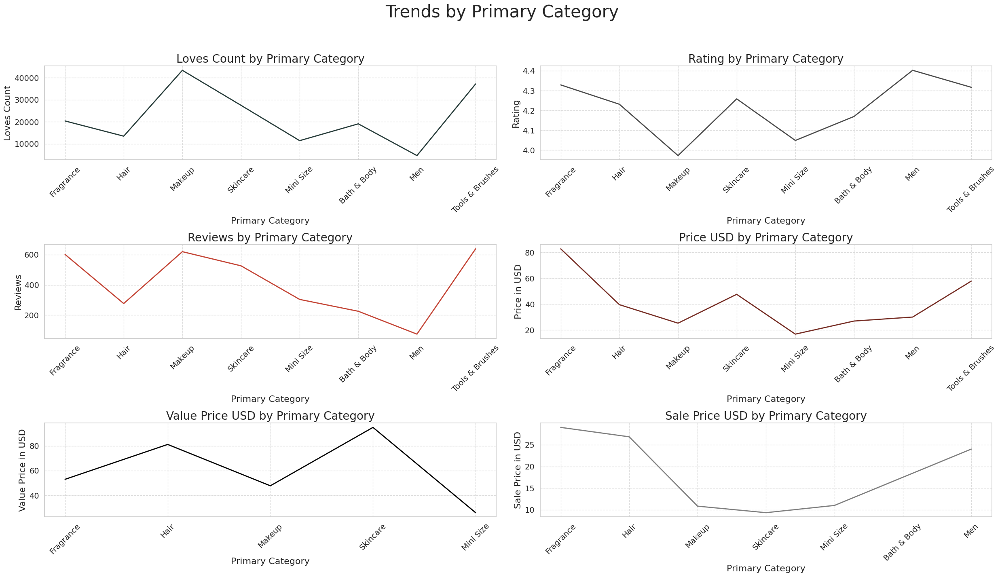

In [51]:
fig, axes = plt.subplots(3, 2, figsize=(25, 15))
fig.suptitle('Trends by Primary Category', fontsize=30)
sns.lineplot(ax=axes[0, 0], x='primary_category', y='loves_count', data=df, ci=None, color='#283D3B', linewidth=2)
axes[0, 0].set_title('Loves Count by Primary Category', fontsize=20)
axes[0, 0].set_xlabel('Primary Category', fontsize=16)
axes[0, 0].set_ylabel('Loves Count', fontsize=16)
sns.lineplot(ax=axes[0, 1], x='primary_category', y='rating', data=df, ci=None, color='#4C4C4C', linewidth=2)
axes[0, 1].set_title('Rating by Primary Category', fontsize=20)
axes[0, 1].set_xlabel('Primary Category', fontsize=16)
axes[0, 1].set_ylabel('Rating', fontsize=16)
sns.lineplot(ax=axes[1, 0], x='primary_category', y='reviews', data=df, ci=None, color='#C44536', linewidth=2)
axes[1, 0].set_title('Reviews by Primary Category', fontsize=20)
axes[1, 0].set_xlabel('Primary Category', fontsize=16)
axes[1, 0].set_ylabel('Reviews', fontsize=16)
sns.lineplot(ax=axes[1, 1], x='primary_category', y='price_usd', data=df, ci=None, color='#772E25', linewidth=2)
axes[1, 1].set_title('Price USD by Primary Category', fontsize=20)
axes[1, 1].set_xlabel('Primary Category', fontsize=16)
axes[1, 1].set_ylabel('Price in USD', fontsize=16)
sns.lineplot(ax=axes[2, 0], x='primary_category', y='value_price_usd', data=df, ci=None, color='#000000', linewidth=2)
axes[2, 0].set_title('Value Price USD by Primary Category', fontsize=20)
axes[2, 0].set_xlabel('Primary Category', fontsize=16)
axes[2, 0].set_ylabel('Value Price in USD', fontsize=16)
sns.lineplot(ax=axes[2, 1], x='primary_category', y='sale_price_usd', data=df, ci=None, color='#7F7F7F', linewidth=2)
axes[2, 1].set_title('Sale Price USD by Primary Category', fontsize=20)
axes[2, 1].set_xlabel('Primary Category', fontsize=16)
axes[2, 1].set_ylabel('Sale Price in USD', fontsize=16)
for ax in axes.flat:
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, fontsize=14)
    ax.tick_params(axis='y', labelsize=14)
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 
plt.show()

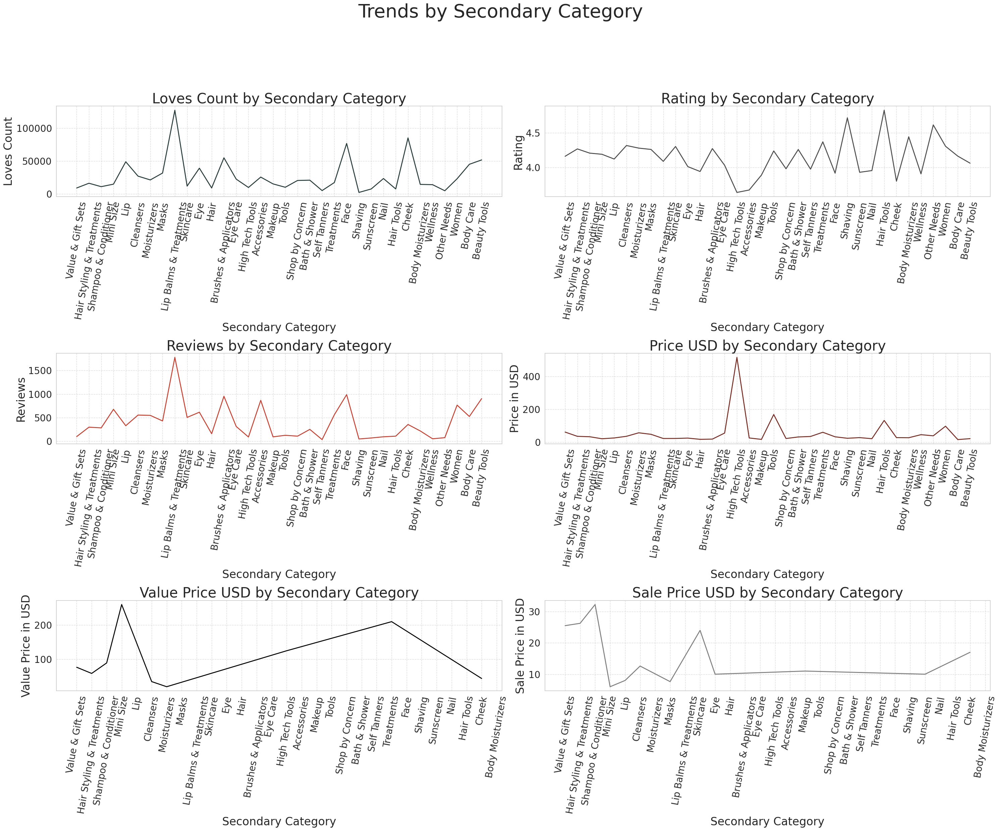

In [52]:
fig, axes = plt.subplots(3, 2, figsize=(30, 25))
fig.suptitle('Trends by Secondary Category', fontsize=40, y=1.02)  
sns.lineplot(ax=axes[0, 0], x='secondary_category', y='loves_count', data=df, ci=None, color='#283D3B', linewidth=2)
axes[0, 0].set_title('Loves Count by Secondary Category', fontsize=30)
axes[0, 0].set_xlabel('Secondary Category', fontsize=24)
axes[0, 0].set_ylabel('Loves Count', fontsize=24)
sns.lineplot(ax=axes[0, 1], x='secondary_category', y='rating', data=df, ci=None, color='#4C4C4C', linewidth=2)
axes[0, 1].set_title('Rating by Secondary Category', fontsize=30)
axes[0, 1].set_xlabel('Secondary Category', fontsize=24)
axes[0, 1].set_ylabel('Rating', fontsize=24)
sns.lineplot(ax=axes[1, 0], x='secondary_category', y='reviews', data=df, ci=None, color='#C44536', linewidth=2)
axes[1, 0].set_title('Reviews by Secondary Category', fontsize=30)
axes[1, 0].set_xlabel('Secondary Category', fontsize=24)
axes[1, 0].set_ylabel('Reviews', fontsize=24)
sns.lineplot(ax=axes[1, 1], x='secondary_category', y='price_usd', data=df, ci=None, color='#772E25', linewidth=2)
axes[1, 1].set_title('Price USD by Secondary Category', fontsize=30)
axes[1, 1].set_xlabel('Secondary Category', fontsize=24)
axes[1, 1].set_ylabel('Price in USD', fontsize=24)
sns.lineplot(ax=axes[2, 0], x='secondary_category', y='value_price_usd', data=df, ci=None, color='#000000', linewidth=2)
axes[2, 0].set_title('Value Price USD by Secondary Category', fontsize=30)
axes[2, 0].set_xlabel('Secondary Category', fontsize=24)
axes[2, 0].set_ylabel('Value Price in USD', fontsize=24)
sns.lineplot(ax=axes[2, 1], x='secondary_category', y='sale_price_usd', data=df, ci=None, color='#7F7F7F', linewidth=2)
axes[2, 1].set_title('Sale Price USD by Secondary Category', fontsize=30)
axes[2, 1].set_xlabel('Secondary Category', fontsize=24)
axes[2, 1].set_ylabel('Sale Price in USD', fontsize=24)
for ax in axes.flat:
    ax.grid(True, linestyle='--', alpha=0.7)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=80, fontsize=20)
    ax.tick_params(axis='y', labelsize=20)
plt.tight_layout(rect=[0, 0.03, 1, 0.95]) 
plt.show()

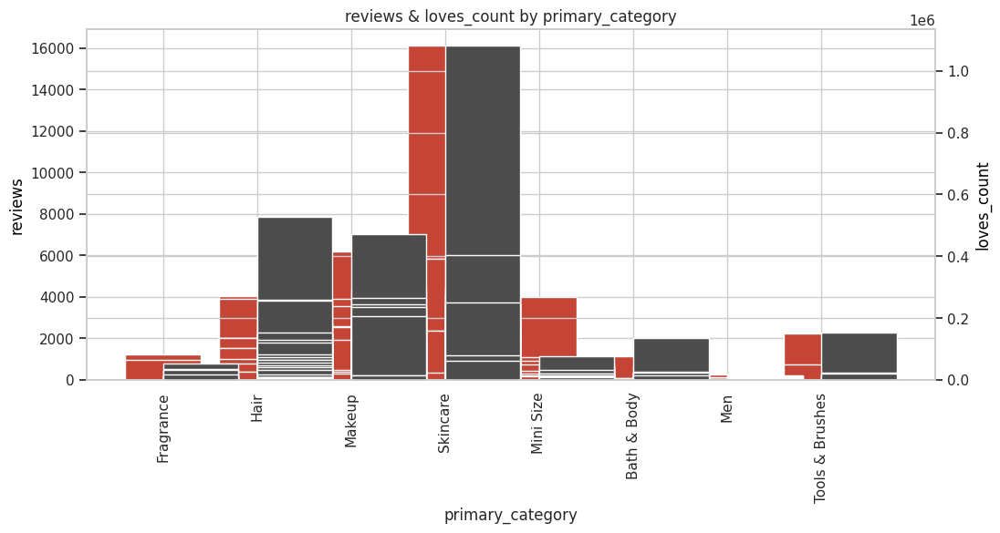

In [53]:
fig, ax1 = plt.subplots(figsize=(12,5))
ax1.bar(df['primary_category'], df['reviews'], color='#C44536', align='center')
ax1.set_ylabel('reviews', color='#000000')
plt.xticks(rotation=90)
plt.xlabel('primary_category')
ax2 = ax1.twinx()
ax2.bar(df['primary_category'], df['loves_count'], color='#4C4C4C', align='edge')
ax2.set_ylabel('loves_count', color='#000000')
plt.title('reviews & loves_count by primary_category')
plt.show()

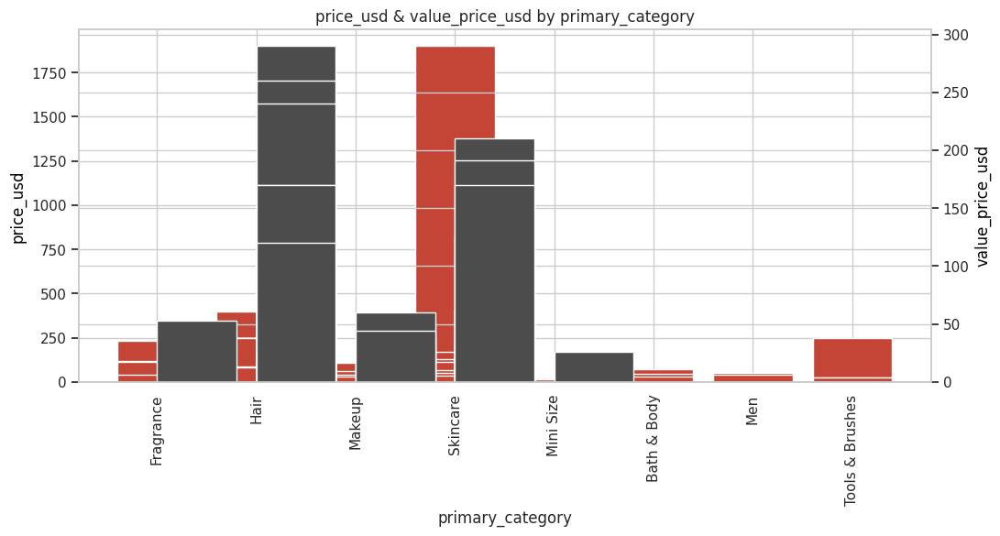

In [54]:
fig, ax1 = plt.subplots(figsize=(12,5))
ax1.bar(df['primary_category'], df['price_usd'], color='#C44536', align='center')
ax1.set_ylabel('price_usd', color='#000000')
plt.xticks(rotation=90)
plt.xlabel('primary_category')
ax2 = ax1.twinx()
ax2.bar(df['primary_category'], df['value_price_usd'], color='#4C4C4C', align='edge')
ax2.set_ylabel('value_price_usd', color='#000000')
plt.title('price_usd & value_price_usd by primary_category')
plt.show()

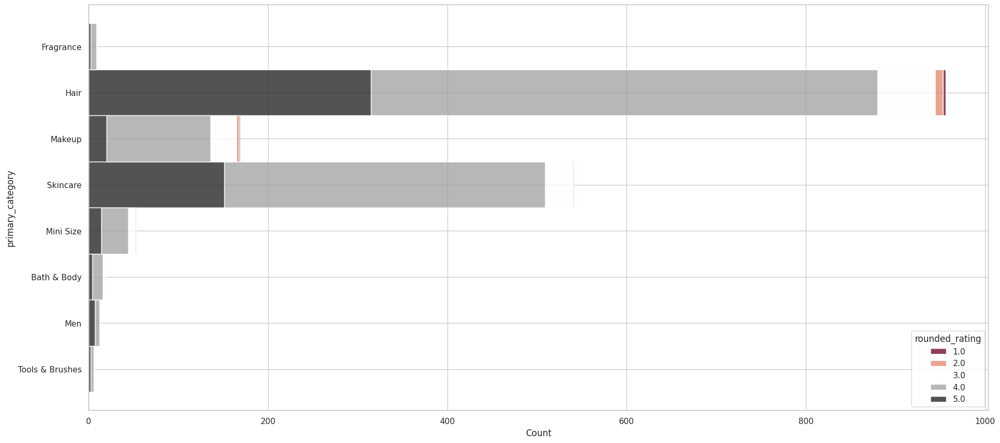

In [55]:
plt.figure(figsize=(22, 10))
sns.histplot(df5, y="primary_category",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

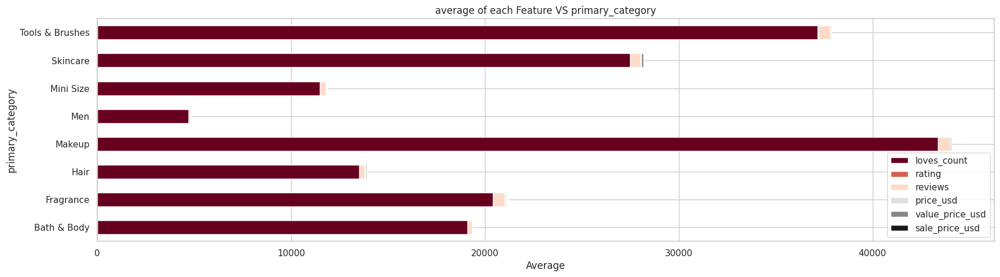

In [56]:
df_mean = df.groupby('primary_category')[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(20, 5), cmap="RdGy")
plt.xlabel('Average')
plt.title('average of each Feature VS primary_category')
plt.legend(loc='lower right')
plt.show()

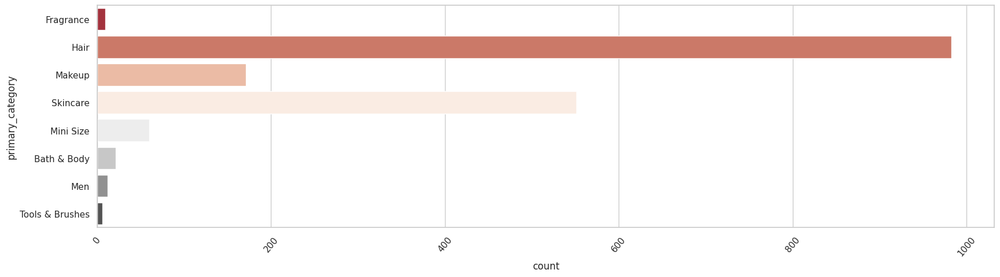

In [57]:
ww = df["primary_category"]
plt.figure(figsize=(20, 5))
plt.xticks(rotation=50)
sns.countplot(y=ww,palette='RdGy')
plt.show()

In [58]:
df.primary_category.value_counts()

primary_category
Hair               983
Skincare           551
Makeup             171
Mini Size           60
Bath & Body         21
Men                 12
Fragrance            9
Tools & Brushes      6
Name: count, dtype: int64

In [59]:
df.secondary_category.value_counts()

secondary_category
Hair Styling & Treatments    458
Shampoo & Conditioner        421
Cleansers                    167
Masks                        162
Eye                           88
Moisturizers                  79
Value & Gift Sets             70
Mini Size                     58
Hair                          38
Tools                         36
Eye Care                      35
Treatments                    29
Skincare                      23
Accessories                   21
Lip                           19
Face                          17
Lip Balms & Treatments        12
Bath & Shower                 12
Nail                           7
Women                          7
Brushes & Applicators          7
Cheek                          6
Makeup                         6
Self Tanners                   6
Sunscreen                      4
High Tech Tools                4
Body Moisturizers              4
Wellness                       4
Beauty Tools                   4
Shaving                 

In [60]:
df.tertiary_category.value_counts()

tertiary_category
Shampoo                     233
Conditioner                 188
Face Wash & Cleansers       156
Face Masks                  131
Hair Styling Products       129
                           ... 
Shaving                       1
Body Lotions & Body Oils      1
Aftershave                    1
BB & CC Creams                1
Eye Palettes                  1
Name: count, Length: 79, dtype: int64

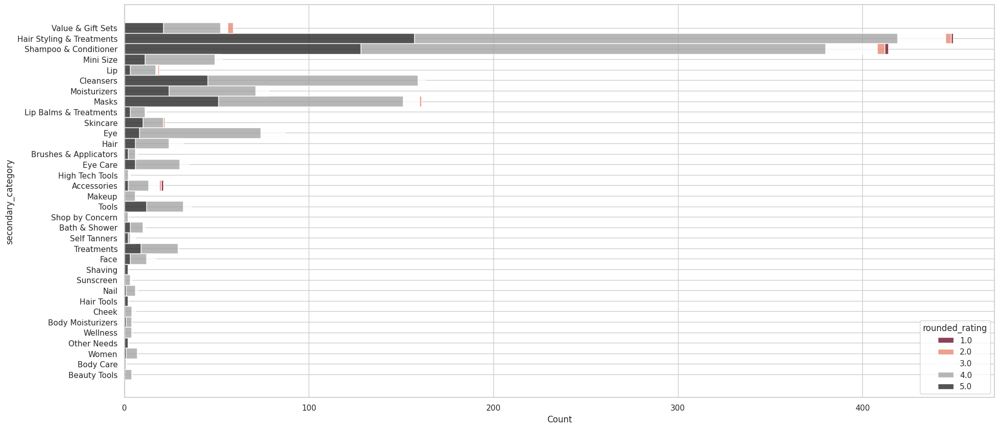

In [61]:
plt.figure(figsize=(22, 10))
sns.histplot(df5, y="secondary_category",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

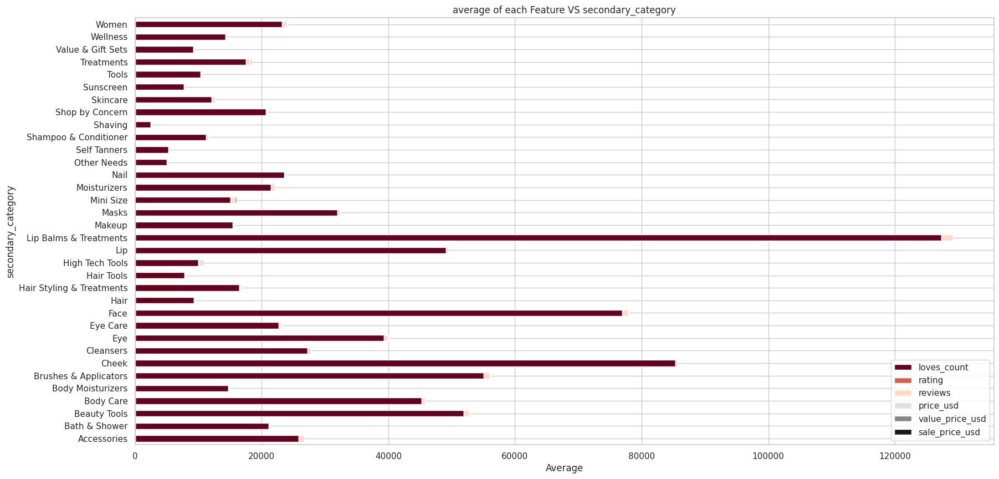

In [62]:
df_mean = df.groupby('secondary_category')[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(20, 10), cmap="RdGy")
plt.xlabel('Average')
plt.title('average of each Feature VS secondary_category')
plt.legend(loc='lower right')
plt.show()

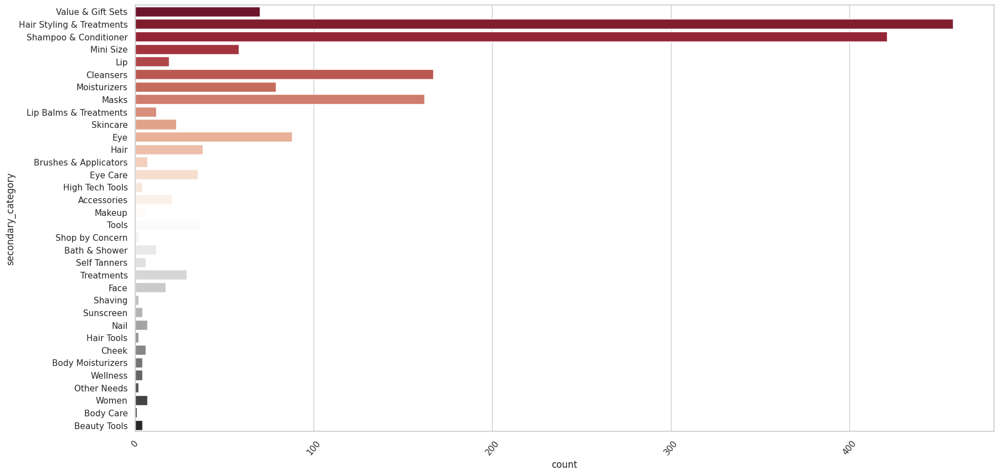

In [63]:
ww = df["secondary_category"]
plt.figure(figsize=(20, 10))
plt.xticks(rotation=50)
sns.countplot(y=ww,palette='RdGy')
plt.show()

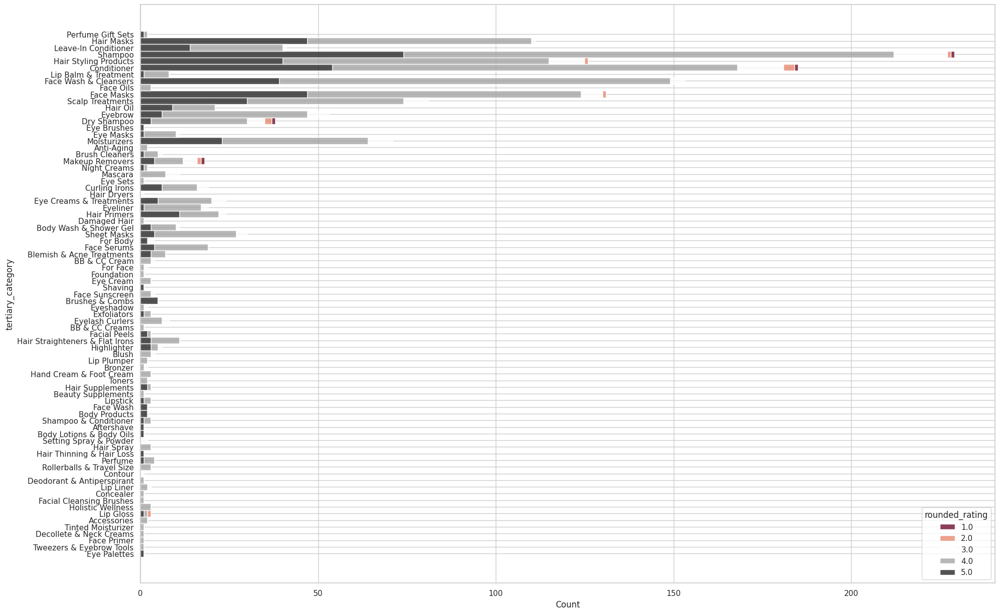

In [64]:
plt.figure(figsize=(22, 15))
sns.histplot(df5, y="tertiary_category",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

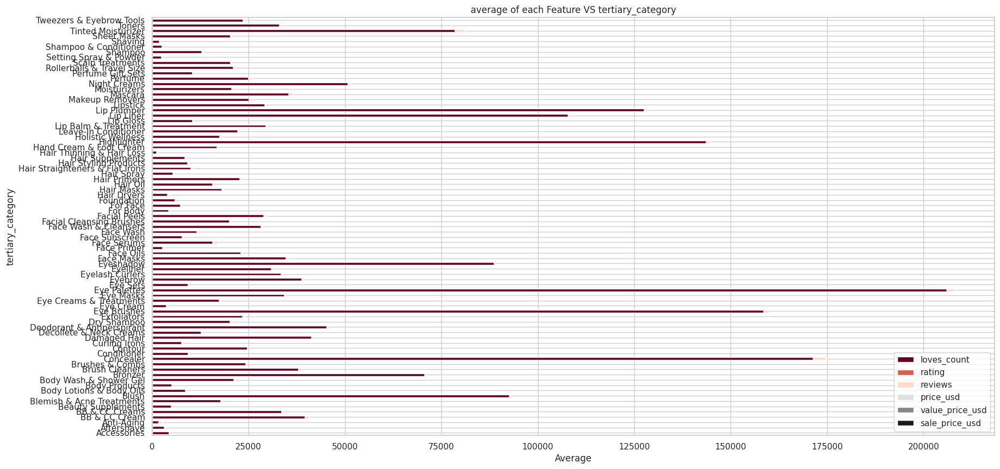

In [65]:
df_mean = df.groupby('tertiary_category')[ff].mean()
df_mean.plot(kind='barh', stacked=True, figsize=(20, 10), cmap="RdGy")
plt.xlabel('Average')
plt.title('average of each Feature VS tertiary_category')
plt.legend(loc='lower right')
plt.show()

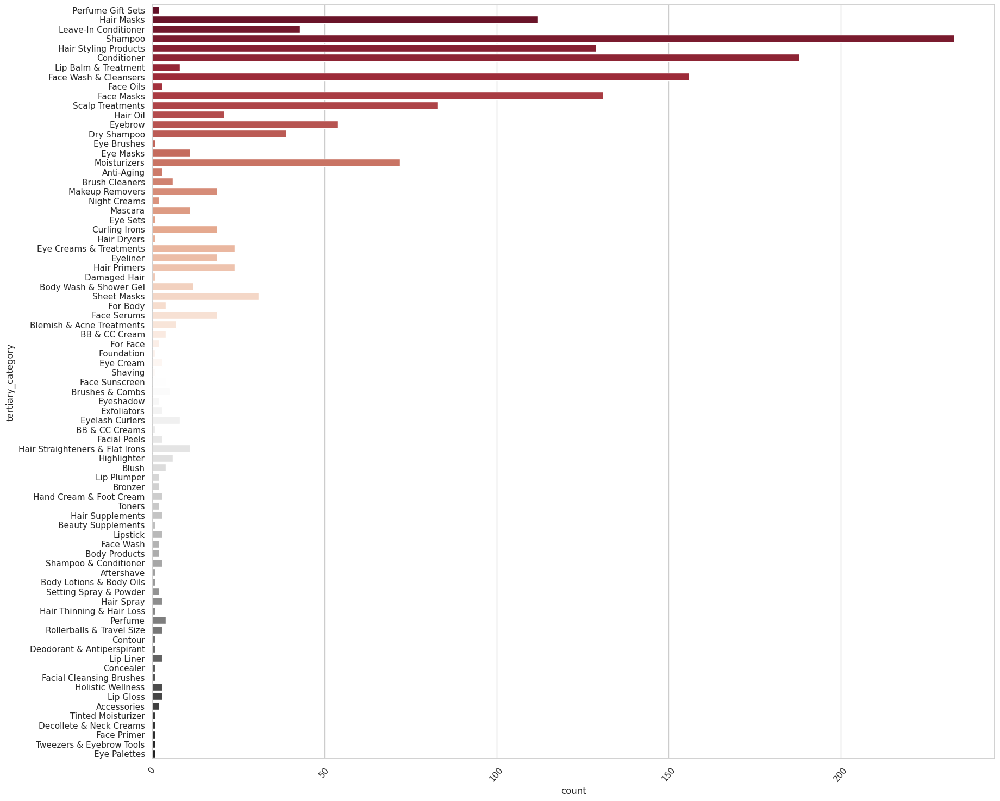

In [66]:
ww = df["tertiary_category"]
plt.figure(figsize=(20, 18))
plt.xticks(rotation=50)
sns.countplot(y=ww,palette='RdGy')
plt.show()

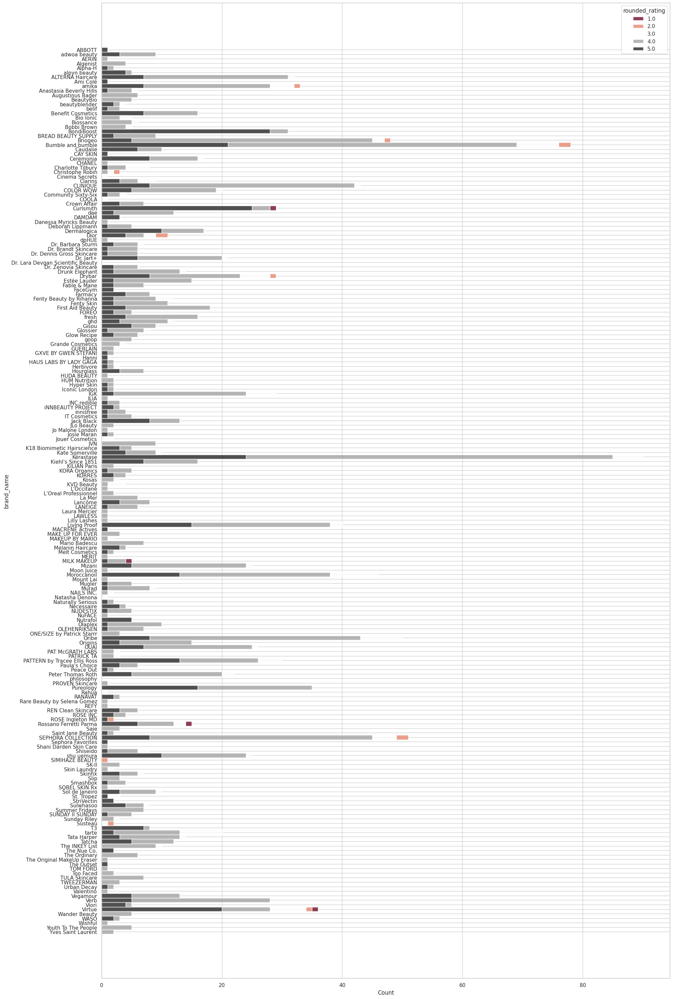

In [67]:
plt.figure(figsize=(22, 38))
sns.histplot(df5, y="brand_name",palette='RdGy',hue="rounded_rating", multiple="stack")
plt.show()

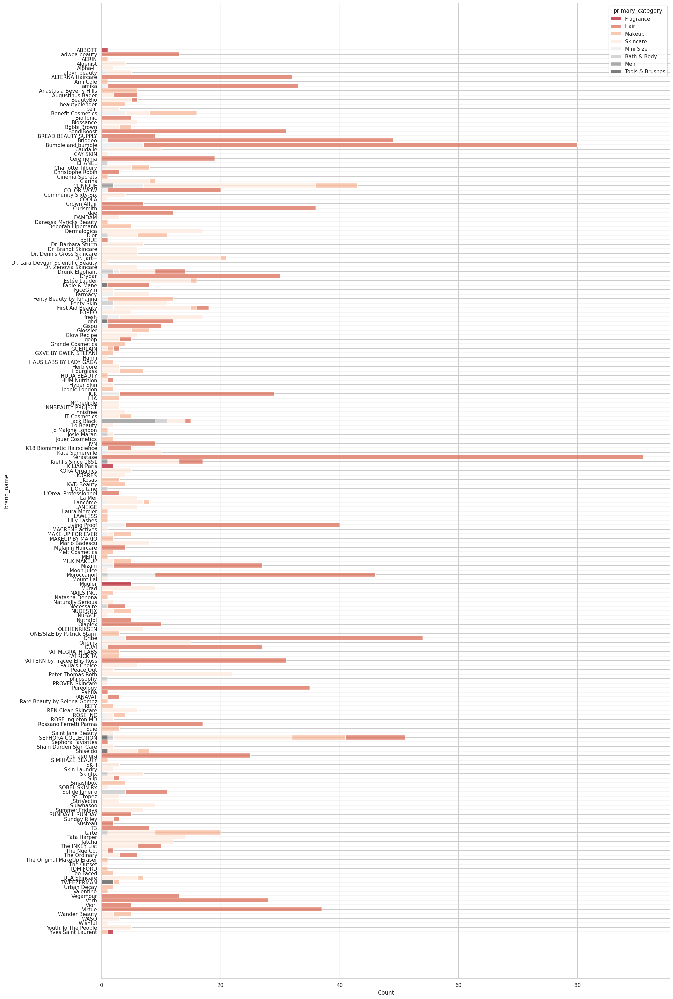

In [68]:
plt.figure(figsize=(22, 38))
sns.histplot(df, y="brand_name",palette='RdGy',hue="primary_category", multiple="stack")
plt.show()

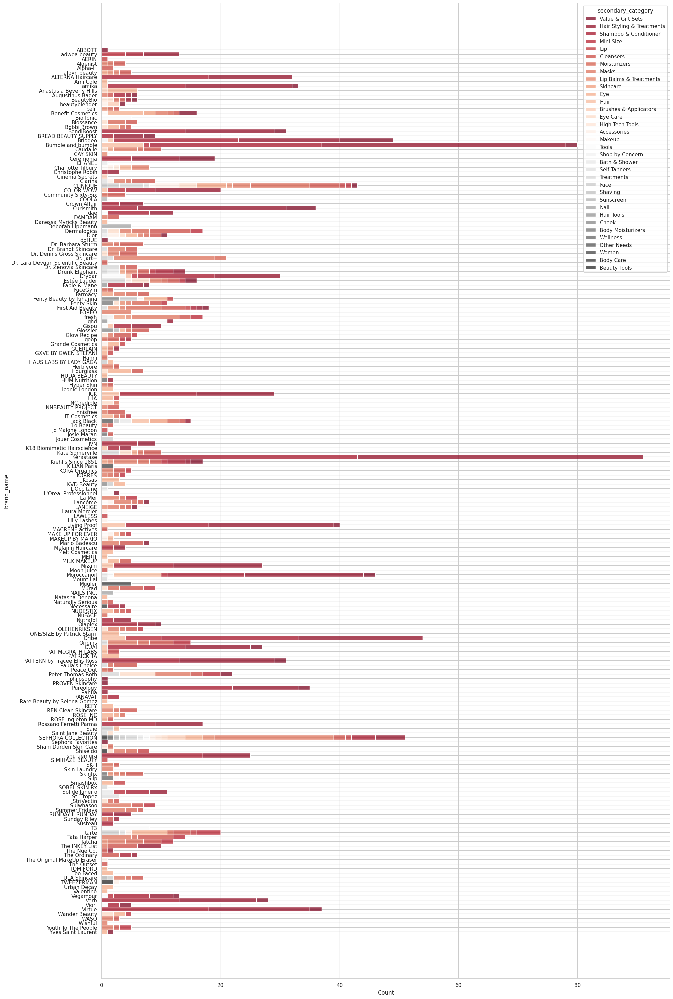

In [69]:
plt.figure(figsize=(22, 38))
sns.histplot(df, y="brand_name",palette='RdGy',hue="secondary_category", multiple="stack")
plt.show()

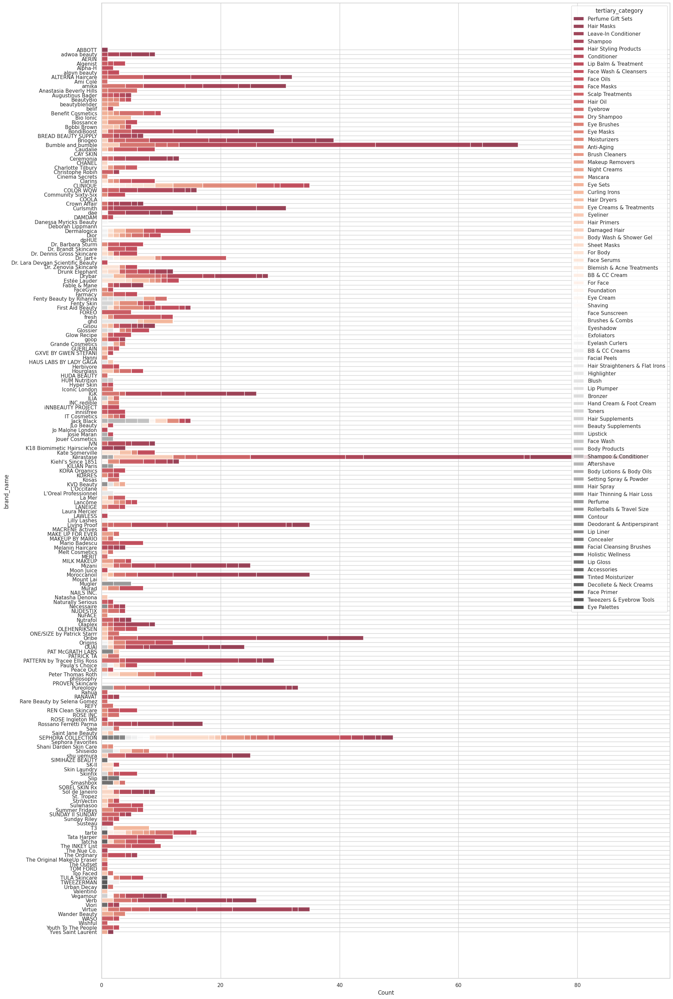

In [70]:
plt.figure(figsize=(22, 38))
sns.histplot(df, y="brand_name",palette='RdGy',hue="tertiary_category", multiple="stack")
plt.show()

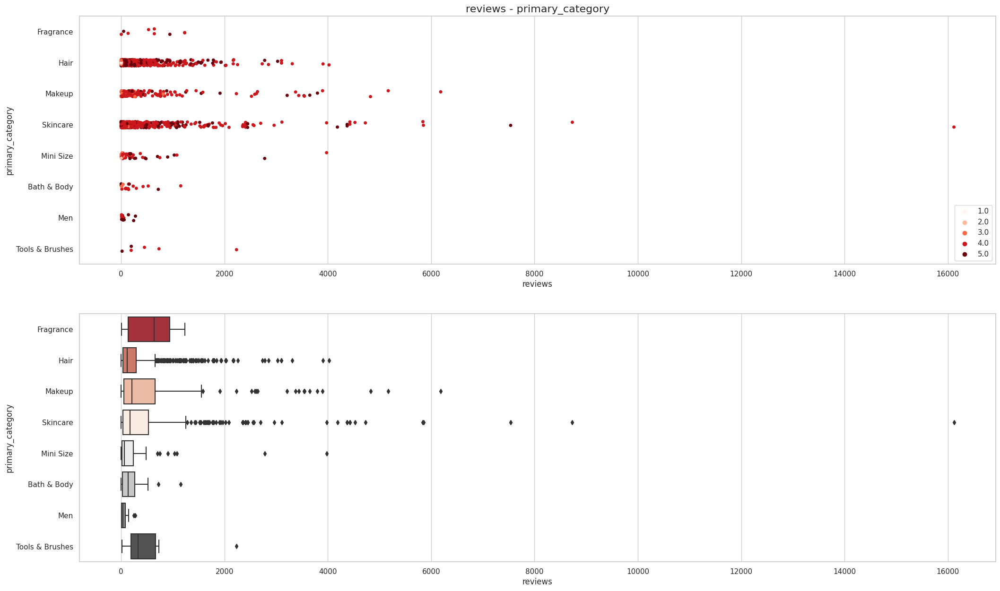

In [71]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='reviews', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('reviews - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='reviews', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

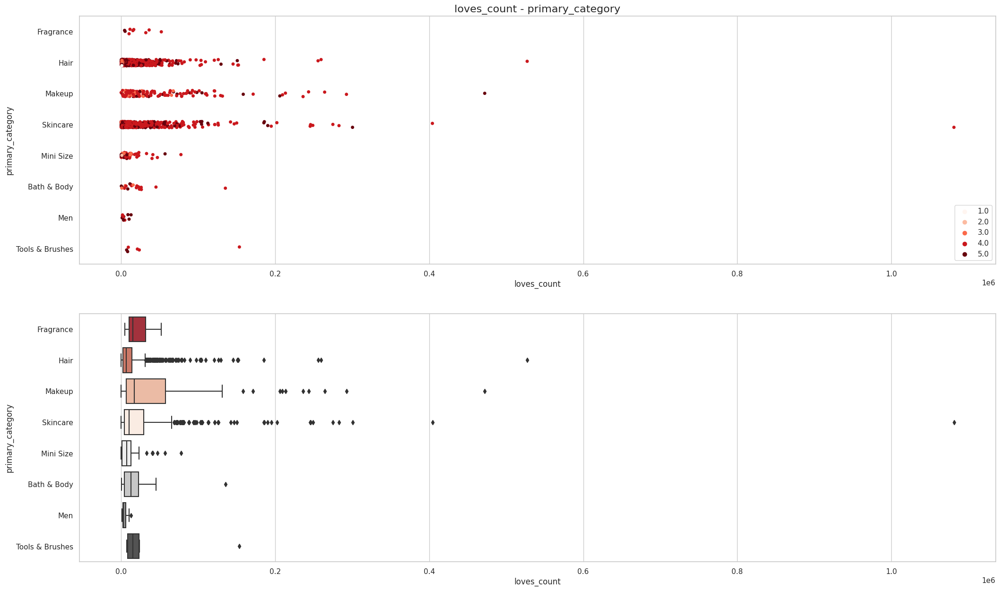

In [72]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='loves_count', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('loves_count - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='loves_count', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

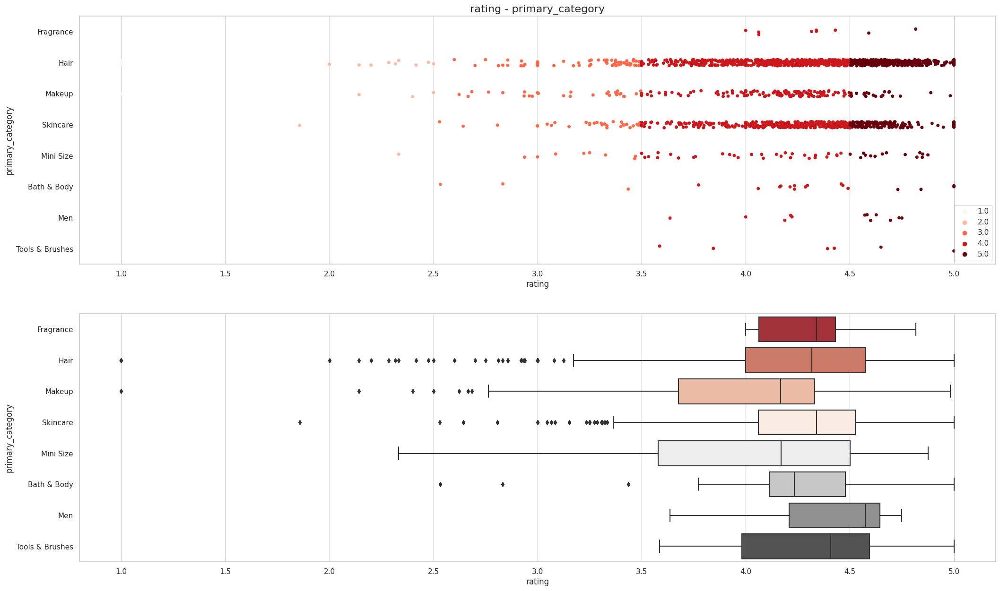

In [73]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='rating', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('rating - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='rating', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

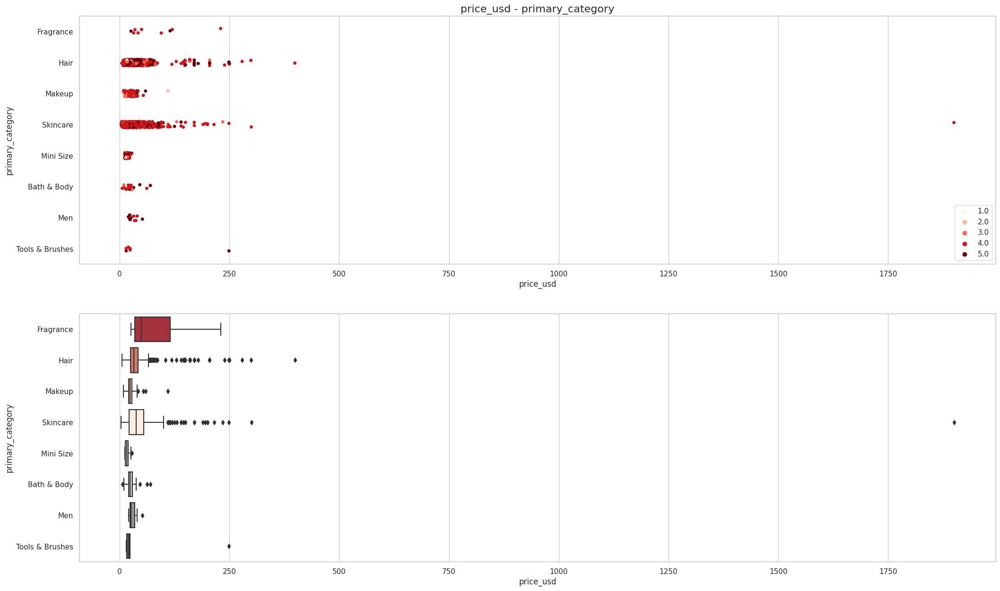

In [74]:
fig, axes = plt.subplots(2,1, figsize=(25,15))
sns.stripplot(data=df5, x='price_usd', palette='Reds', hue='rounded_rating', y='primary_category', orient='h', ax=axes[0])
axes[0].set_title('price_usd - primary_category', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=df5, x='price_usd', palette='RdGy', y='primary_category', orient='h', ax=axes[1])
plt.show()

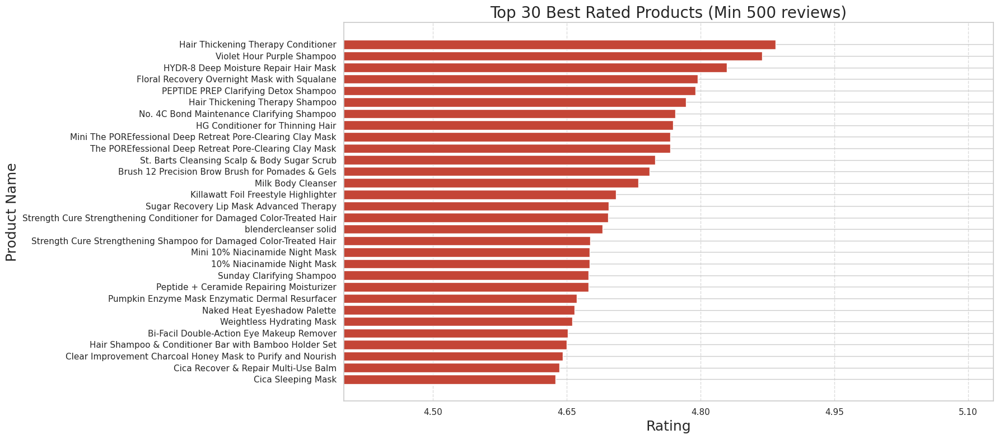

In [75]:
plt.figure(figsize=(18, 8), dpi=100)
brands1 = df[['product_name', 'brand_name', 'reviews', 'rating']].query('reviews > 500').sort_values('rating', ascending=False).head(30)
plt.barh(brands1['product_name'], brands1['rating'], color='#C44536')
plt.title('Top 30 Best Rated Products (Min 500 reviews)', fontsize=20)
plt.xlabel('Rating', fontsize=18)
plt.ylabel('Product Name', fontsize=18)
plt.gca().xaxis.set_major_locator(ticker.MaxNLocator(5))
plt.gca().invert_yaxis()
plt.xlim(4.4)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

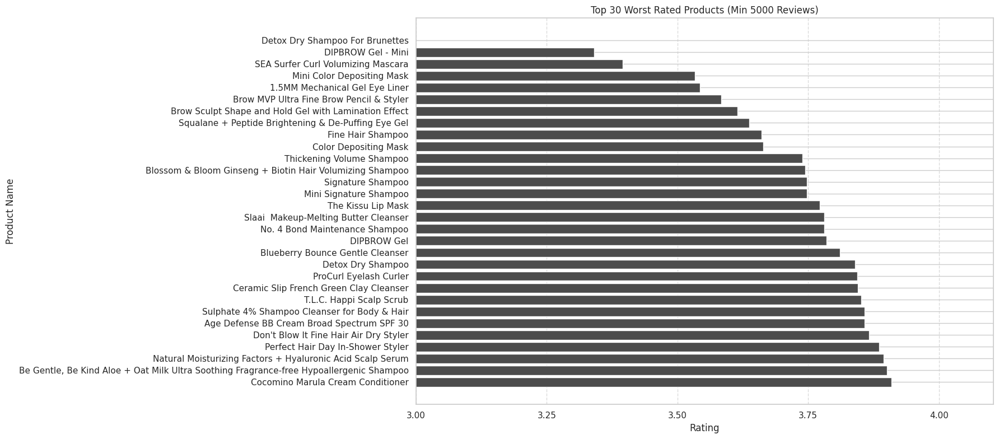

In [76]:
plt.figure(figsize=(18, 8))
brands2 = df[['product_name', 'brand_name', 'reviews', 'rating', ]].query('reviews > 500').reset_index().sort_values('rating', ascending=True).head(30)
plt.barh(brands2['product_name'], brands2['rating'], color='#4C4C4C')
plt.title('Top 30 Worst Rated Products (Min 5000 Reviews)')
plt.xlabel('Rating')
plt.ylabel('Product Name')
plt.gca().xaxis.set_major_locator(ticker.MaxNLocator(5))
plt.gca().invert_yaxis()
plt.xlim(3)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

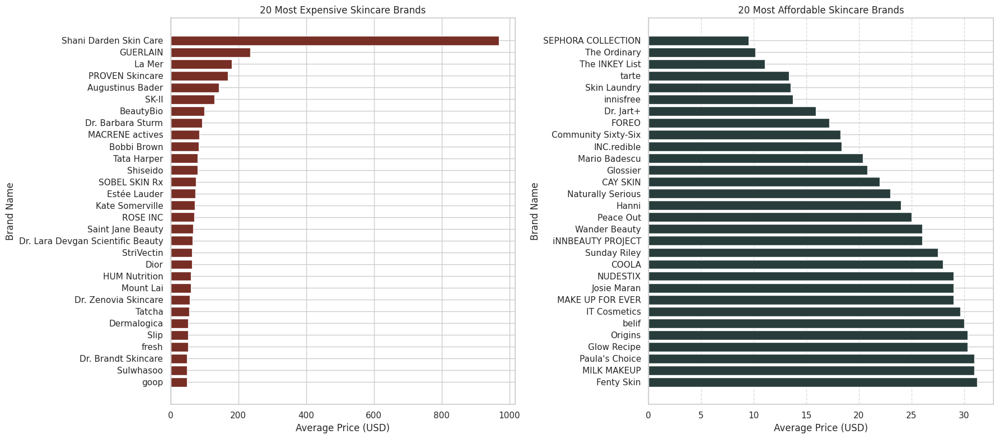

In [77]:
brands3 = df.query('primary_category == "Skincare"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Skincare"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Skincare"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('20 Most Expensive Skincare Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#283D3B')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('20 Most Affordable Skincare Brands')
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

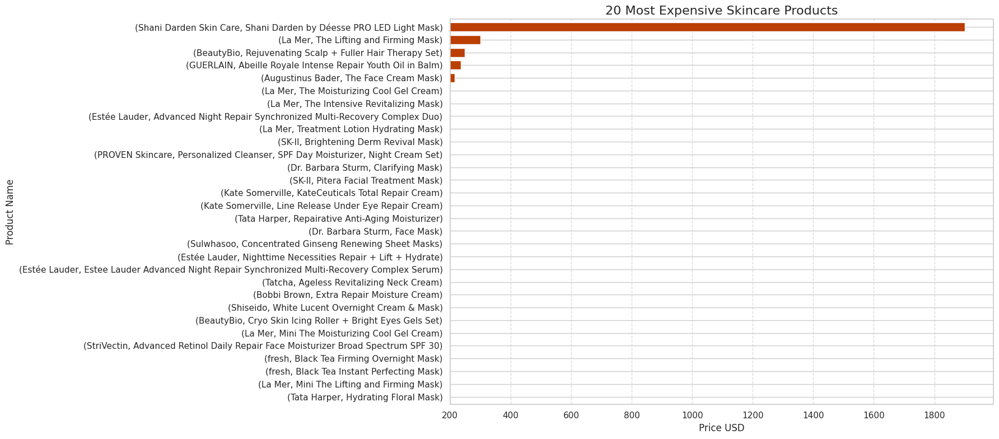

In [78]:
plt.figure(figsize=(18, 8))
makeup_price = df[['product_name', 'brand_name', 'primary_category', 'price_usd', 'secondary_category']].query('primary_category == "Skincare"').nlargest(30, 'price_usd')
prices = makeup_price.drop(columns=['primary_category', 'secondary_category']).groupby(['brand_name', 'product_name'])['price_usd'].max().sort_values(ascending=False).iloc[::-1]
prices.plot(kind='barh', color='#bb3e03', width=0.7)
plt.title('20 Most Expensive Skincare Products', fontdict={'fontsize': 16})
plt.xlabel('Price USD')
plt.ylabel('Product Name')
plt.xlim(200)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

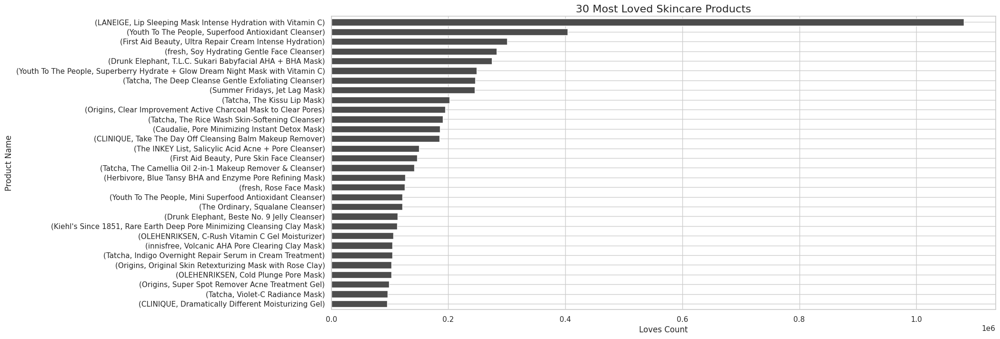

In [79]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Skincare"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('30 Most Loved Skincare Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

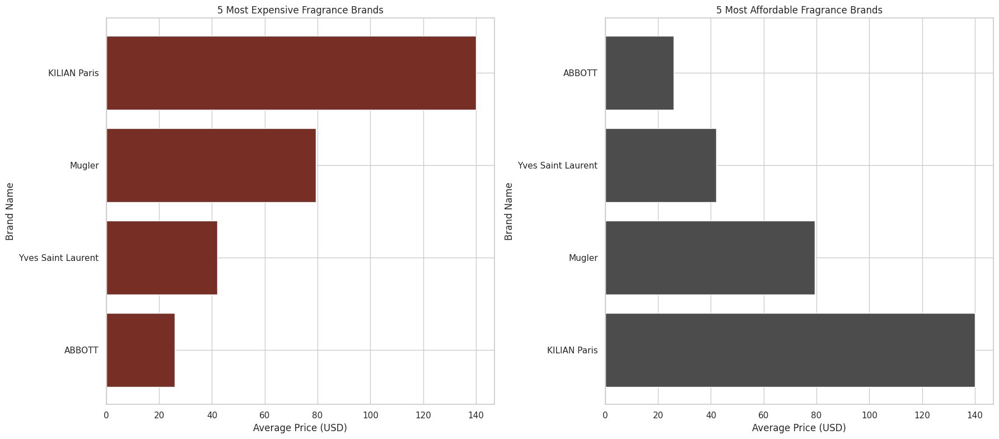

In [80]:
brands3 = df.query('primary_category == "Fragrance"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Fragrance"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Fragrance"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('5 Most Expensive Fragrance Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('5 Most Affordable Fragrance Brands')
plt.tight_layout()
plt.show()

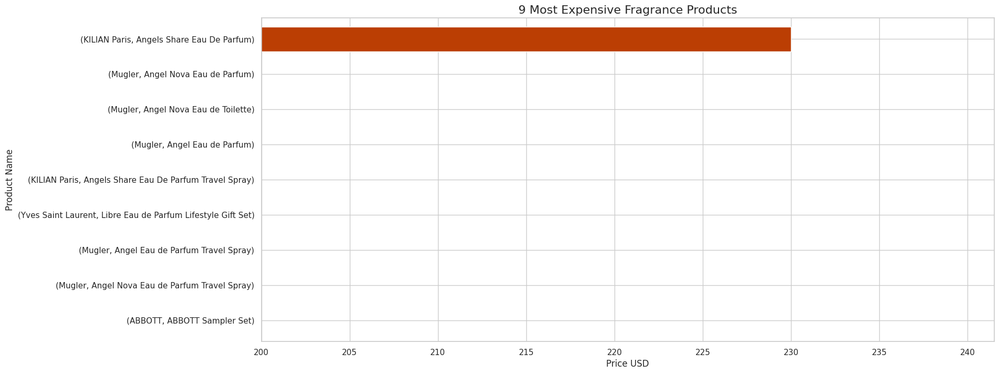

In [81]:
plt.figure(figsize=(18, 8))
makeup_price = df[['product_name', 'brand_name', 'primary_category', 'price_usd', 'secondary_category']].query('primary_category == "Fragrance"').nlargest(30, 'price_usd')
prices = makeup_price.drop(columns=['primary_category', 'secondary_category']).groupby(['brand_name', 'product_name'])['price_usd'].max().sort_values(ascending=False).iloc[::-1]
prices.plot(kind='barh', color='#bb3e03', width=0.7)
plt.title('9 Most Expensive Fragrance Products', fontdict={'fontsize': 16})
plt.xlabel('Price USD')
plt.ylabel('Product Name')
plt.xlim(200)
plt.show()

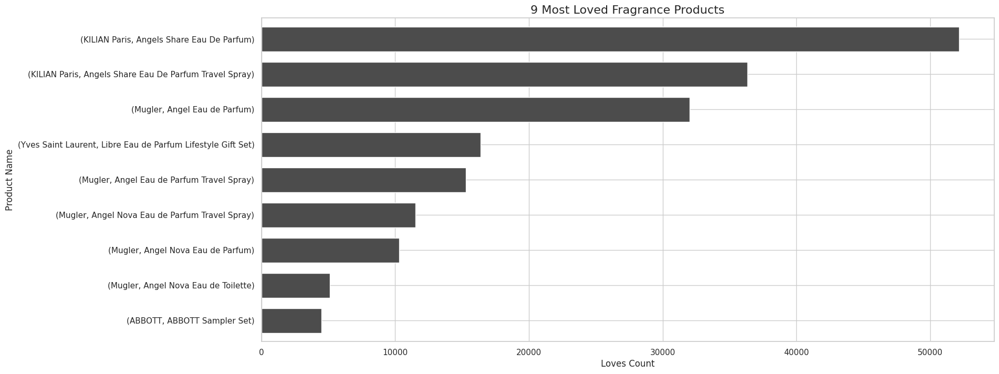

In [82]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Fragrance"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('9 Most Loved Fragrance Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

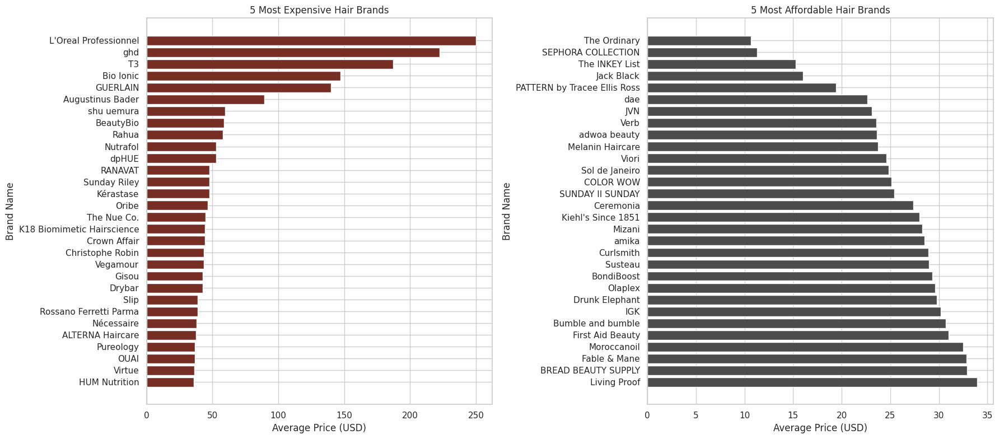

In [83]:
brands3 = df.query('primary_category == "Hair"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Hair"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Hair"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('5 Most Expensive Hair Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('5 Most Affordable Hair Brands')
plt.tight_layout()
plt.show()

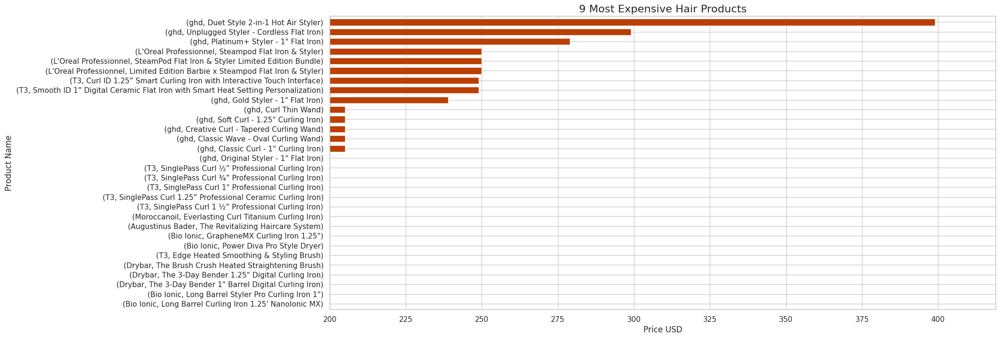

In [84]:
plt.figure(figsize=(18, 8))
makeup_price = df[['product_name', 'brand_name', 'primary_category', 'price_usd', 'secondary_category']].query('primary_category == "Hair"').nlargest(30, 'price_usd')
prices = makeup_price.drop(columns=['primary_category', 'secondary_category']).groupby(['brand_name', 'product_name'])['price_usd'].max().sort_values(ascending=False).iloc[::-1]
prices.plot(kind='barh', color='#bb3e03', width=0.7)
plt.title('9 Most Expensive Hair Products', fontdict={'fontsize': 16})
plt.xlabel('Price USD')
plt.ylabel('Product Name')
plt.xlim(200)
plt.show()

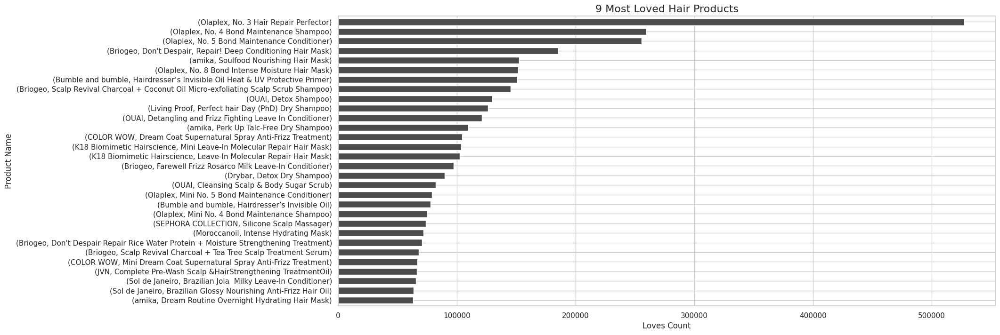

In [85]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Hair"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('9 Most Loved Hair Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

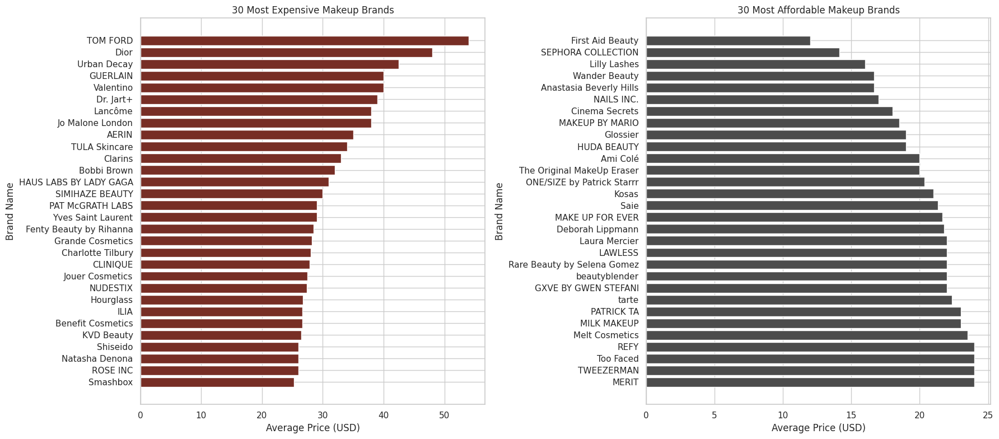

In [86]:
brands3 = df.query('primary_category == "Makeup"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Makeup"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Makeup"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('30 Most Expensive Makeup Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('30 Most Affordable Makeup Brands')
plt.tight_layout()
plt.show()

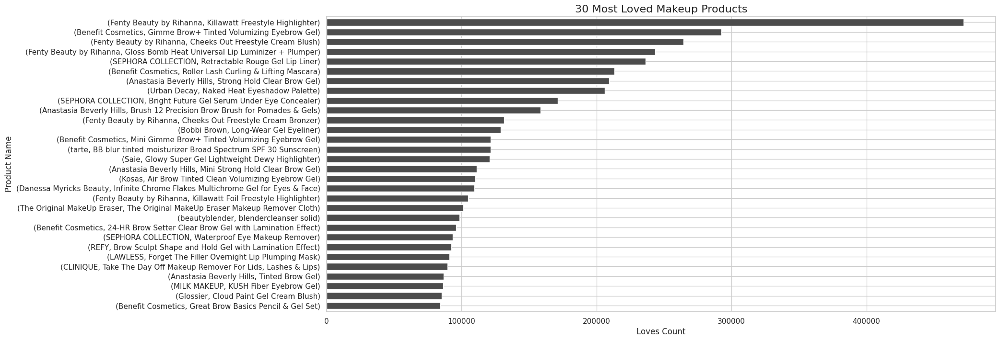

In [87]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Makeup"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('30 Most Loved Makeup Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

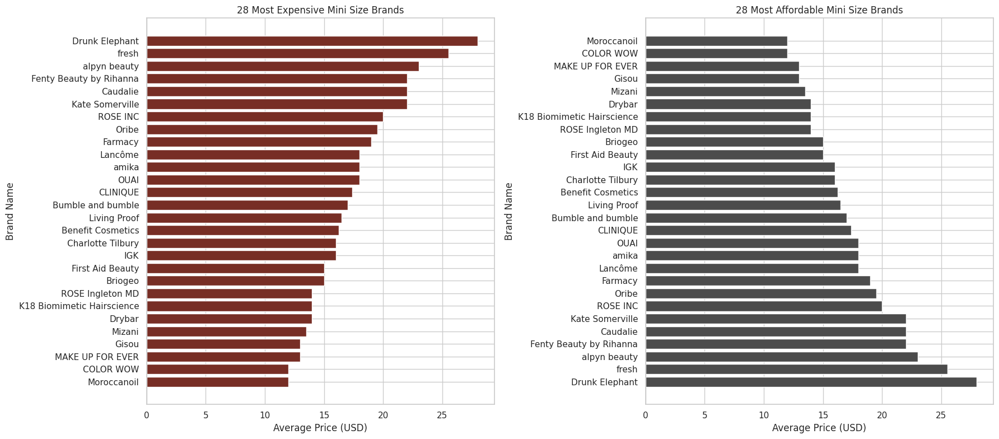

In [88]:
brands3 = df.query('primary_category == "Mini Size"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Mini Size"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Mini Size"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('28 Most Expensive Mini Size Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('28 Most Affordable Mini Size Brands')
plt.tight_layout()
plt.show()

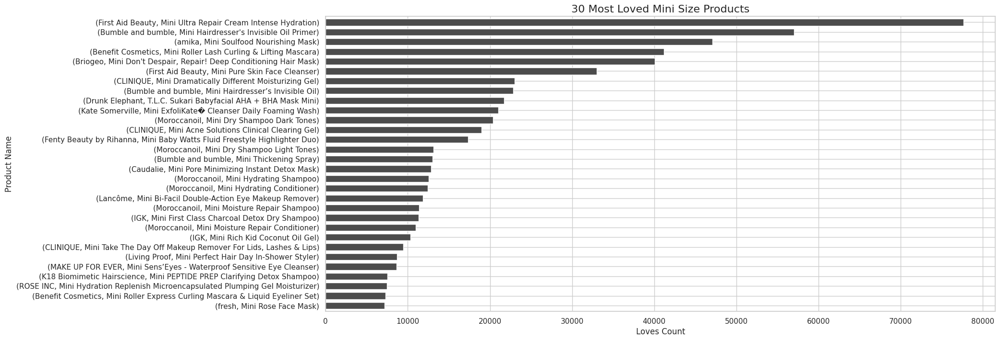

In [89]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Mini Size"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('30 Most Loved Mini Size Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

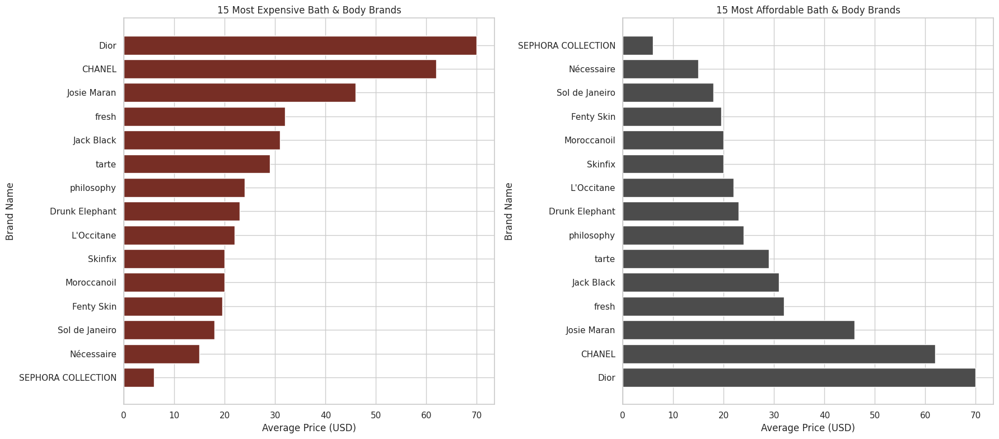

In [90]:
brands3 = df.query('primary_category == "Bath & Body"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Bath & Body"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Bath & Body"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('15 Most Expensive Bath & Body Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('15 Most Affordable Bath & Body Brands')
plt.tight_layout()
plt.show()

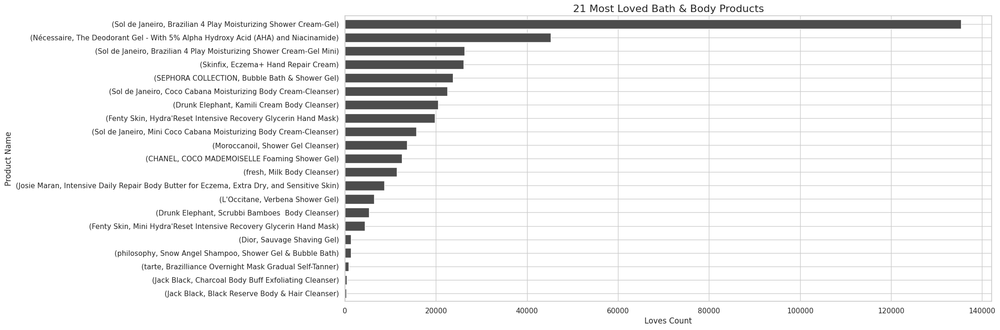

In [91]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Bath & Body"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('21 Most Loved Bath & Body Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

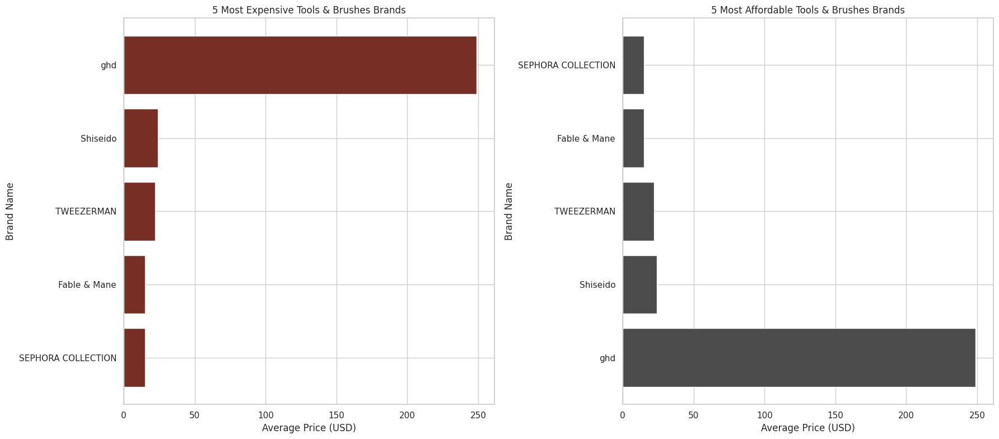

In [92]:
brands3 = df.query('primary_category == "Tools & Brushes"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True)
lowest = df.query('primary_category == "Tools & Brushes"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).head(30)
lowest = lowest.iloc[::-1]
highest = df.query('primary_category == "Tools & Brushes"').groupby(['brand_id', 'brand_name'])['price_usd'].mean().sort_values(ascending=True).tail(30)
fig, axs = plt.subplots(1, 2, figsize=(18, 8))
axs[0].barh(highest.index.get_level_values('brand_name'), highest.values, color='#772E25')
axs[0].set_xlabel('Average Price (USD)')
axs[0].set_ylabel('Brand Name')
axs[0].set_title('5 Most Expensive Tools & Brushes Brands')
axs[1].barh(lowest.index.get_level_values('brand_name'), lowest.values, color='#4C4C4C')
axs[1].set_xlabel('Average Price (USD)')
axs[1].set_ylabel('Brand Name')
axs[1].set_title('5 Most Affordable Tools & Brushes Brands')
plt.tight_layout()
plt.show()

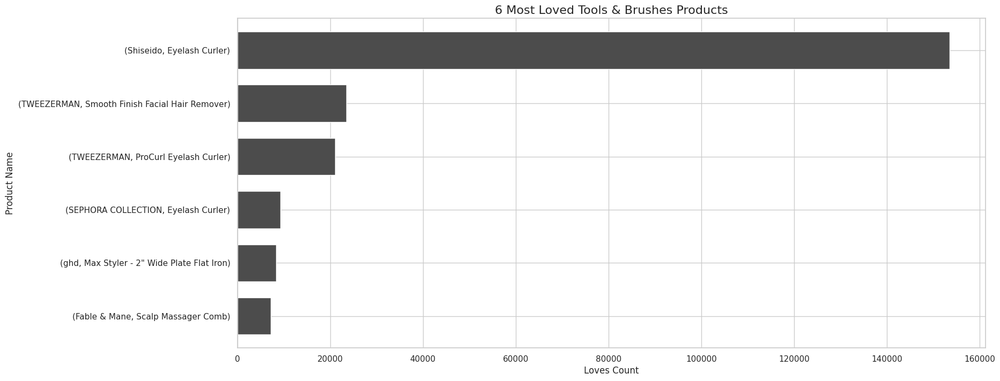

In [93]:
plt.figure(figsize=(18, 8))
brandss = df.query('primary_category == "Tools & Brushes"').groupby(['brand_name', 'product_name'])['loves_count'].sum().sort_values(ascending=False).head(30).iloc[::-1]
brandss.plot(kind='barh',  color='#4C4C4C', width=0.7)
plt.title('6 Most Loved Tools & Brushes Products', fontdict={'fontsize': 16})
plt.xlabel('Loves Count')
plt.ylabel('Product Name')
plt.show()

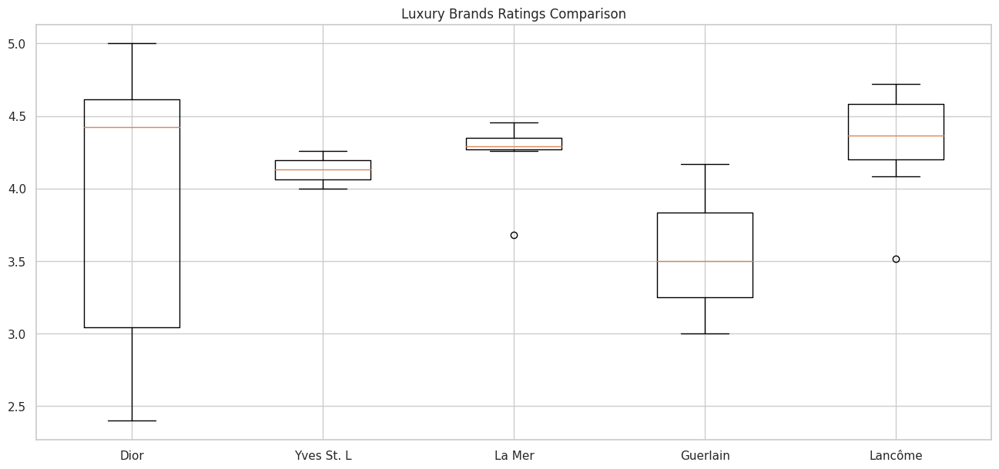

In [94]:
dr = df.query('brand_name == "Dior"')
ysl = df.query('brand_name == "Yves Saint Laurent"')
lm = df.query('brand_name == "La Mer"')
gr = df.query('brand_name == "GUERLAIN"')
lc = df.query('brand_name == "Lancôme"')
dior = dr['rating'].dropna()
ystl = ysl['rating'].dropna()
guerlain = gr['rating'].dropna()
lamer = lm['rating'].dropna()
lancome = lc['rating'].dropna()
labels = ['Dior', 'Yves St. L', 'La Mer', 'Guerlain', 'Lancôme']
plt.figure(figsize=(16, 7))
plt.title('Luxury Brands Ratings Comparison')
plt.boxplot([dior, ystl, lamer, guerlain, lancome], labels=labels)
plt.show()

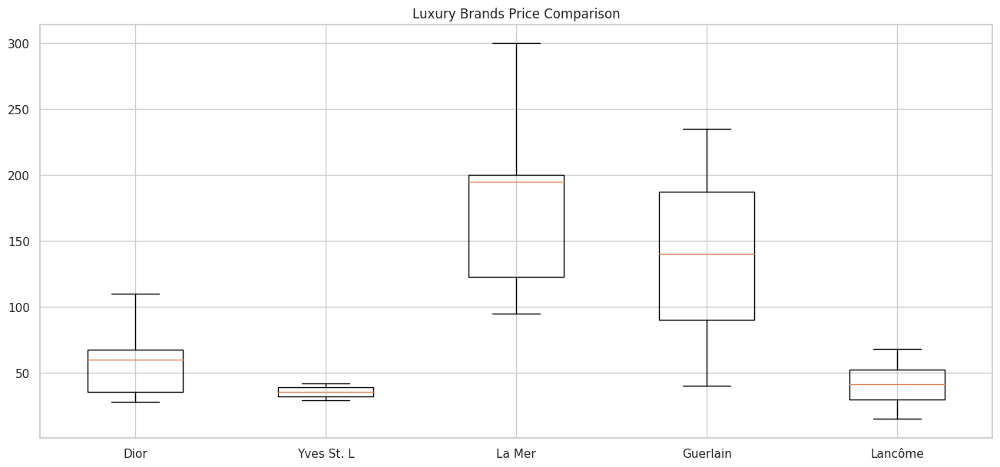

In [95]:
dr = df.query('brand_name == "Dior"')
ysl = df.query('brand_name == "Yves Saint Laurent"')
lm = df.query('brand_name == "La Mer"')
gr = df.query('brand_name == "GUERLAIN"')
lc = df.query('brand_name == "Lancôme"')
dior = dr['price_usd'].dropna()
ystl = ysl['price_usd'].dropna()
guerlain = gr['price_usd'].dropna()
lamer = lm['price_usd'].dropna()
lancome = lc['price_usd'].dropna()
labels = ['Dior', 'Yves St. L', 'La Mer', 'Guerlain', 'Lancôme']
plt.figure(figsize=(16, 7))
plt.title('Luxury Brands Price Comparison')
plt.boxplot([dior, ystl, lamer, guerlain, lancome], labels=labels)
plt.show()

In [96]:
# Getting the files
df1 = pd.read_csv("/kaggle/input/sephora-products-and-skincare-reviews/reviews_0-250.csv", low_memory=False)
df2 = pd.read_csv("/kaggle/input/sephora-products-and-skincare-reviews/reviews_250-500.csv", low_memory=False)
df3 = pd.read_csv("/kaggle/input/sephora-products-and-skincare-reviews/reviews_500-750.csv", low_memory=False)
df4 = pd.read_csv("/kaggle/input/sephora-products-and-skincare-reviews/reviews_750-1250.csv", low_memory=False)
df5 = pd.read_csv("/kaggle/input/sephora-products-and-skincare-reviews/reviews_1250-end.csv", low_memory=False)
# Combining the dfs
dr = pd.concat([df1,df2,df3,df4,df5])
dr.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1094411 entries, 0 to 49976
Data columns (total 19 columns):
 #   Column                    Non-Null Count    Dtype  
---  ------                    --------------    -----  
 0   Unnamed: 0                1094411 non-null  int64  
 1   author_id                 1094411 non-null  object 
 2   rating                    1094411 non-null  int64  
 3   is_recommended            926423 non-null   float64
 4   helpfulness               532819 non-null   float64
 5   total_feedback_count      1094411 non-null  int64  
 6   total_neg_feedback_count  1094411 non-null  int64  
 7   total_pos_feedback_count  1094411 non-null  int64  
 8   submission_time           1094411 non-null  object 
 9   review_text               1092967 non-null  object 
 10  review_title              783757 non-null   object 
 11  skin_tone                 923872 non-null   object 
 12  eye_color                 884783 non-null   object 
 13  skin_type                 982854 n

In [99]:
dr.columns

Index(['Unnamed: 0', 'author_id', 'rating', 'is_recommended', 'helpfulness',
       'total_feedback_count', 'total_neg_feedback_count',
       'total_pos_feedback_count', 'submission_time', 'review_text',
       'review_title', 'skin_tone', 'eye_color', 'skin_type', 'hair_color',
       'product_id', 'product_name', 'brand_name', 'price_usd'],
      dtype='object')

In [100]:
dr.shape

(1094411, 19)

In [101]:
def check_dr(dr: object, head: object = 5) -> object:
    print("\nShape")
    print(dr.shape)
    print("\nTypes")
    print(dr.dtypes)
    print("\nNANs")
    print(dr.isnull().sum())
    print("\nInfo")
    print(dr.info())
check_dr(dr)


Shape
(1094411, 19)

Types
Unnamed: 0                    int64
author_id                    object
rating                        int64
is_recommended              float64
helpfulness                 float64
total_feedback_count          int64
total_neg_feedback_count      int64
total_pos_feedback_count      int64
submission_time              object
review_text                  object
review_title                 object
skin_tone                    object
eye_color                    object
skin_type                    object
hair_color                   object
product_id                   object
product_name                 object
brand_name                   object
price_usd                   float64
dtype: object

NANs
Unnamed: 0                       0
author_id                        0
rating                           0
is_recommended              167988
helpfulness                 561592
total_feedback_count             0
total_neg_feedback_count         0
total_pos_feedback_coun

In [102]:
print('Number of duplicated rows: ' , len(dr[dr.duplicated()]))

Number of duplicated rows:  0


In [103]:
dr_duplicates = dr[dr.duplicated()]
dr_duplicates

,Unnamed: 0,author_id,rating,is_recommended,helpfulness,total_feedback_count,total_neg_feedback_count,total_pos_feedback_count,submission_time,review_text,review_title,skin_tone,eye_color,skin_type,hair_color,product_id,product_name,brand_name,price_usd


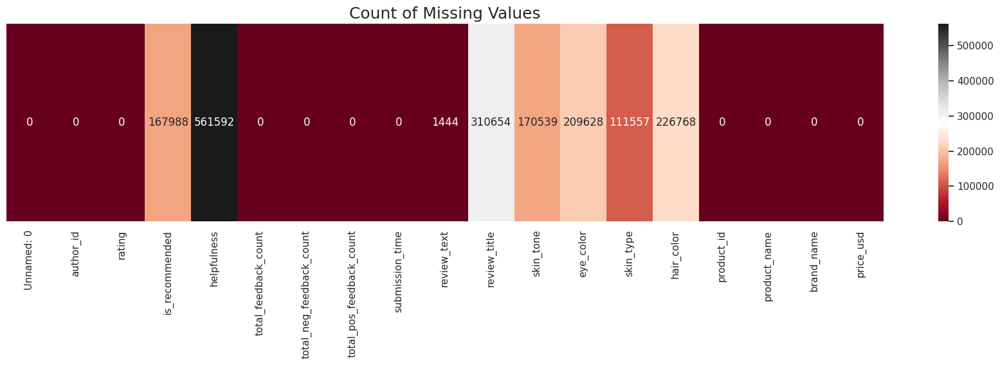

In [104]:
plt.figure(figsize=(22,4))
sns.heatmap((dr.isna().sum()).to_frame(name='').T,cmap='RdGy', annot=True,
             fmt='0.0f').set_title('Count of Missing Values', fontsize=18)
plt.show()

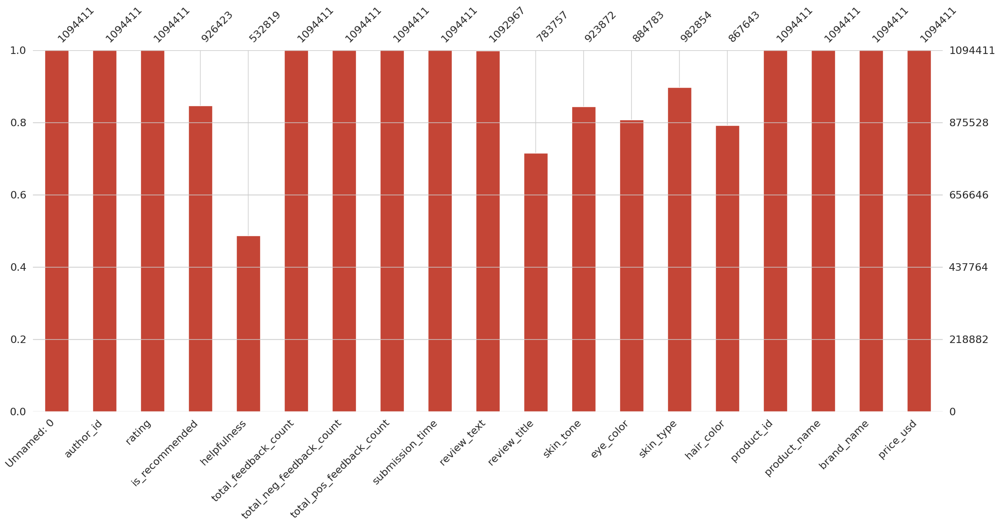

In [105]:
msno.bar(dr, color='#C44536')
plt.show()

In [106]:
pct_missing = dr.isna().mean()
pct_missing

Unnamed: 0                  0.000000
author_id                   0.000000
rating                      0.000000
is_recommended              0.153496
helpfulness                 0.513145
total_feedback_count        0.000000
total_neg_feedback_count    0.000000
total_pos_feedback_count    0.000000
submission_time             0.000000
review_text                 0.001319
review_title                0.283855
skin_tone                   0.155827
eye_color                   0.191544
skin_type                   0.101933
hair_color                  0.207206
product_id                  0.000000
product_name                0.000000
brand_name                  0.000000
price_usd                   0.000000
dtype: float64

<Axes: >

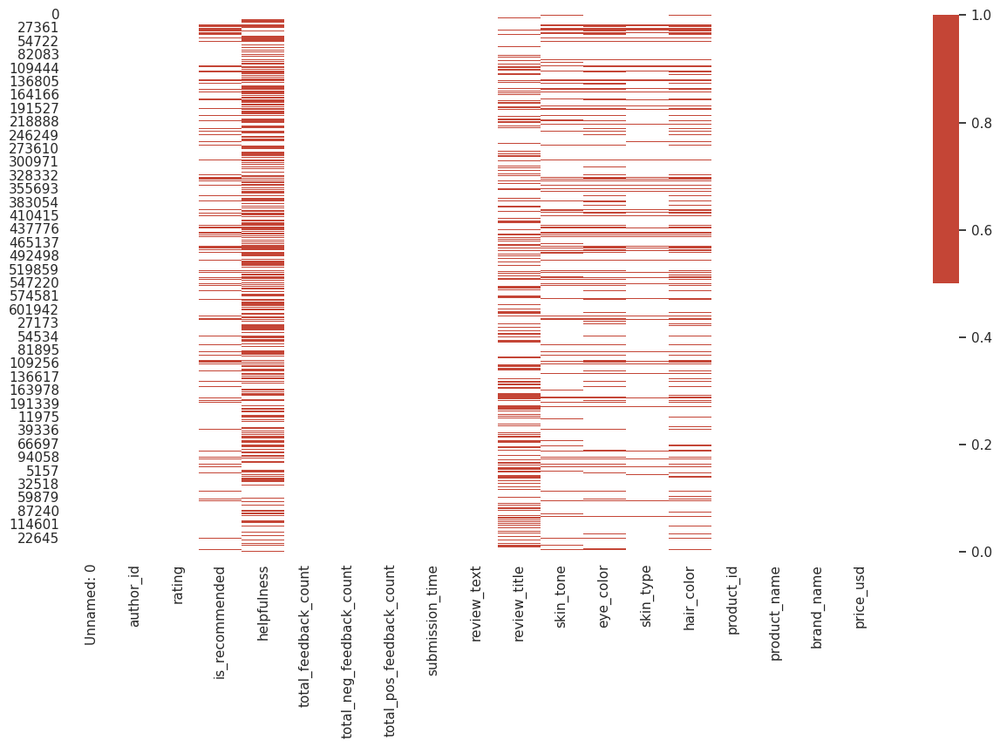

In [107]:
plt.figure(figsize=(15,8))
cols= dr.columns
colors=['#ffffff','#C44536']
sns.heatmap(dr[cols].isna(),cmap=sns.color_palette(colors))

In [108]:
dr.describe().T.style.background_gradient(cmap='RdGy', axis=1)

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,1094411.000000,198986.380700,174988.613205,0.000000,55906.000000,130824.000000,328526.500000,602129.000000
rating,1094411.000000,4.299158,1.149444,1.000000,4.000000,5.000000,5.000000,5.000000
is_recommended,926423.000000,0.839962,0.366642,0.000000,1.000000,1.000000,1.000000,1.000000
helpfulness,532819.000000,0.767782,0.317164,0.000000,0.652174,0.928571,1.000000,1.000000
total_feedback_count,1094411.000000,4.177126,22.715238,0.000000,0.000000,0.000000,3.000000,5464.000000
total_neg_feedback_count,1094411.000000,0.894869,5.288943,0.000000,0.000000,0.000000,1.000000,1159.000000
total_pos_feedback_count,1094411.000000,3.282257,19.674818,0.000000,0.000000,0.000000,3.000000,5050.000000
price_usd,1094411.000000,49.008382,40.043383,3.000000,25.000000,39.000000,62.000000,1900.000000


In [110]:
# finding unique data
dr.apply(lambda x: len(x.unique()))

Unnamed: 0                  602130
author_id                   503216
rating                           5
is_recommended                   3
helpfulness                   3768
total_feedback_count           676
total_neg_feedback_count       259
total_pos_feedback_count       590
submission_time               5317
review_text                 969420
review_title                364106
skin_tone                       15
eye_color                        7
skin_type                        5
hair_color                       8
product_id                    2351
product_name                  2334
brand_name                     142
price_usd                      221
dtype: int64

In [111]:
unique = dr.nunique().sort_values()
unique_values = dr.apply(lambda x: x.unique())
pd.DataFrame({'Number of Unique Values': unique, 'Unique Values': unique_values})

,Number of Unique Values,Unique Values
Unnamed: 0,602130,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,..."
author_id,503216,"[1741593524, 31423088263, 5061282401, 60830388..."
brand_name,142,"[NUDESTIX, LANEIGE, fresh, Josie Maran, First ..."
eye_color,6,"[brown, nan, hazel, blue, green, gray, Grey]"
hair_color,7,"[black, nan, blonde, brown, brunette, gray, au..."
helpfulness,3767,"[1.0, nan, 0.25, 0.4444440007209778, 0.0, 0.72..."
is_recommended,2,"[1.0, 0.0, nan]"
price_usd,221,"[19.0, 24.0, 39.0, 49.0, 38.0, 92.0, 36.0, 60...."
product_id,2351,"[P504322, P420652, P7880, P218700, P248407, P2..."
product_name,2334,"[Gentle Hydra-Gel Face Cleanser, Lip Sleeping ..."


In [112]:
numeric_cols = dr.select_dtypes(include = ['number']).columns
print(numeric_cols)
print(f'{len(numeric_cols)} Numeric Columns in Reviews dataset')

Index(['Unnamed: 0', 'rating', 'is_recommended', 'helpfulness',
       'total_feedback_count', 'total_neg_feedback_count',
       'total_pos_feedback_count', 'price_usd'],
      dtype='object')
8 Numeric Columns in Reviews dataset


In [113]:
non_numeric_cols = dr.select_dtypes(exclude=['number']).columns
print(non_numeric_cols)
print(f'{len(non_numeric_cols)} Non-Numeric Columns in Reviews dataset')

Index(['author_id', 'submission_time', 'review_text', 'review_title',
       'skin_tone', 'eye_color', 'skin_type', 'hair_color', 'product_id',
       'product_name', 'brand_name'],
      dtype='object')
11 Non-Numeric Columns in Reviews dataset


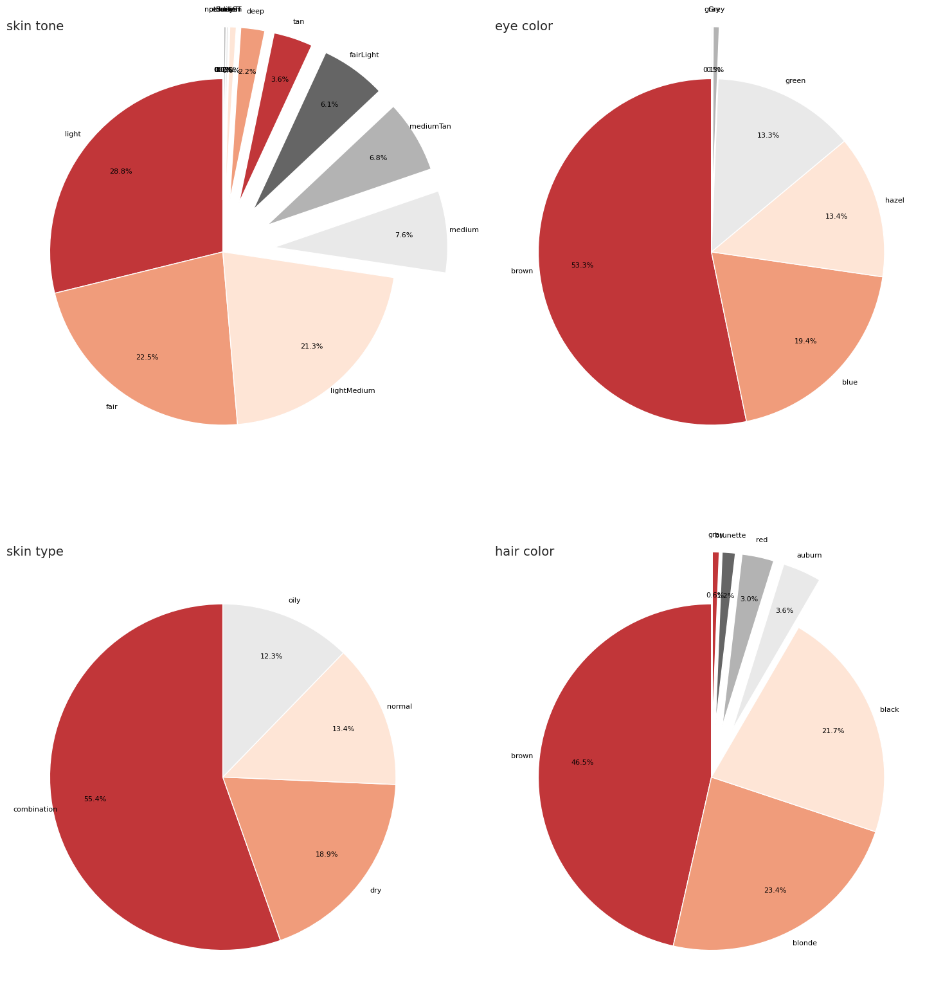

In [114]:
fig, ax = plt.subplots(figsize=(15, 17), nrows=2, ncols=2)
sns.set_palette("RdGy")
columns = ['skin_tone',
       'eye_color', 'skin_type', 'hair_color']
titles = ['skin tone',
       'eye color', 'skin type', 'hair color']
def get_explode(values, threshold=10):
    total = sum(values)
    return [0.3 if (v / total) * 100 < threshold else 0 for v in values]

for i, column in enumerate(columns):
    row = i // 2
    col = i % 2
    values = dr[column].value_counts()
    explode = get_explode(values)
    values.plot.pie(
        autopct='%1.1f%%', ax=ax[row, col], startangle=90,
        textprops={'color': 'black', 'fontsize': 8, 'ha': 'center', 'va': 'center'},
        pctdistance=0.75,
        explode=explode
    )
    ax[row, col].set_title(titles[i], fontsize=14, loc='left')
    ax[row, col].set_ylabel('')
plt.tight_layout(pad=2.0)
plt.show()

In [115]:
# Dropping non-numerical data
hr = dr.drop(columns=['submission_time', 'review_text', 'review_title', 'skin_tone',
       'eye_color', 'skin_type', 'hair_color', 'product_id', 'product_name', 'brand_name'])

In [116]:
hr.corr(numeric_only=True).T.style.background_gradient(cmap='RdGy', axis=1)

,Unnamed: 0,rating,is_recommended,helpfulness,total_feedback_count,total_neg_feedback_count,total_pos_feedback_count,price_usd
Unnamed: 0,1.000000,-0.004117,-0.003129,-0.014650,-0.011044,-0.013497,-0.009122,-0.010150
rating,-0.004117,1.000000,0.845274,0.183906,-0.088634,-0.176603,-0.054857,0.007105
is_recommended,-0.003129,0.845274,1.000000,0.138562,-0.088437,-0.160550,-0.058105,0.019731
helpfulness,-0.014650,0.183906,0.138562,1.000000,0.015220,-0.204209,0.072386,-0.052726
total_feedback_count,-0.011044,-0.088634,-0.088437,0.015220,1.000000,0.652809,0.979047,0.021480
total_neg_feedback_count,-0.013497,-0.176603,-0.160550,-0.204209,0.652809,1.000000,0.484872,0.021083
total_pos_feedback_count,-0.009122,-0.054857,-0.058105,0.072386,0.979047,0.484872,1.000000,0.019132
price_usd,-0.010150,0.007105,0.019731,-0.052726,0.021480,0.021083,0.019132,1.000000


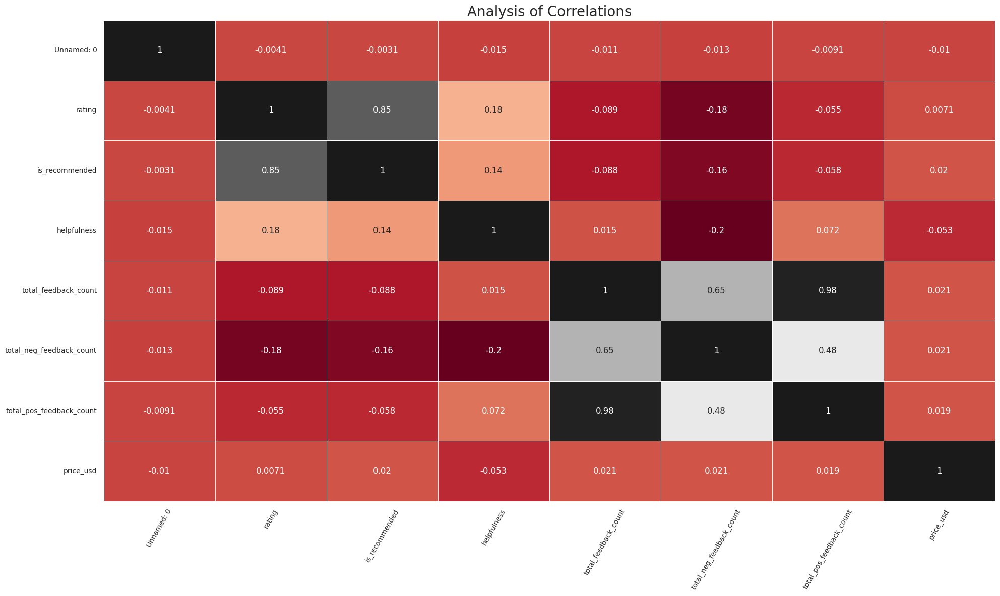

In [117]:
plt.figure(figsize=(20, 12))
sns.heatmap(hr.corr(numeric_only=True), cmap="RdGy", annot=True, linewidths=.6 , cbar = False)
plt.xticks(rotation=60, size=10)
plt.yticks(size=10)
plt.title('Analysis of Correlations', size=20)
plt.tight_layout()
plt.show()

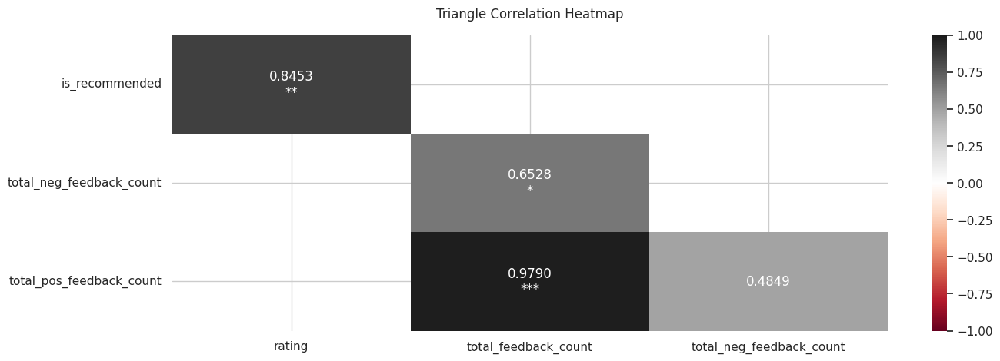

In [118]:
corr = hr.corr(numeric_only=True)
f, ax = plt.subplots(figsize=(15, 5))
mask = np.triu(np.ones_like(corr, dtype=bool))
cut_off = 0.25
extreme_1 = 0.5
extreme_2 = 0.75
extreme_3 = 0.9
mask |= np.abs(corr) < cut_off
corr = corr[~mask]
remove_empty_rows_and_cols = True
if remove_empty_rows_and_cols:
    wanted_cols = np.flatnonzero(np.count_nonzero(~mask, axis=1))
    wanted_rows = np.flatnonzero(np.count_nonzero(~mask, axis=0))
    corr = corr.iloc[wanted_cols, wanted_rows]

annot = [[f"{val:.4f}"
          + ('' if abs(val) < extreme_1 else '\n*')
          + ('' if abs(val) < extreme_2 else '*')
          + ('' if abs(val) < extreme_3 else '*')
          for val in row] for row in corr.to_numpy()]
heatmap = sns.heatmap(corr, vmin=-1, vmax=1, annot=annot, fmt='', cmap='RdGy')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize': 12}, pad=16)
plt.show()

In [ ]:
from wordcloud import WordCloud, STOPWORDS
# Extract the "review_text" column from the data frame
review_text = dr['review_text'].astype(str)

# Define stopwords to be excluded from the word cloud
stopwords = set(STOPWORDS)
stopwords.update(["br", "href", "don t", "didn t", "don't", "doesn'", "didn't" ])  # Add any other stopwords you'd like to exclude

# Create a word cloud
word_cloud = WordCloud(stopwords=stopwords,
                       max_words=150,
                       background_color='white',
                       colormap='RdGy',  # Change the color scheme
                       width=800,
                       height=400).generate(' '.join(review_text))

# Display the generated word cloud
plt.figure(figsize=(12, 6))  # Modify the figure size
plt.imshow(word_cloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [119]:
dr2 = dr.copy()

In [120]:
def create_sentiment_label(rating):
    if rating <= 2:
        return 0
    elif rating == 3:
        return 1
    else:
        return 2

In [121]:
dr2 = dr2[['rating', 'review_text']]

In [122]:
dr2['sentiment'] = dr2['rating'].apply(create_sentiment_label)
dr2

,rating,review_text,sentiment
0,5,I use this with the Nudestix “Citrus Clean Bal...,2
1,1,I bought this lip mask after reading the revie...,0
2,5,My review title says it all! I get so excited ...,2
3,5,I’ve always loved this formula for a long time...,2
4,5,"If you have dry cracked lips, this is a must h...",2
...,...,...,...
49972,5,Consider salicylic acid your secret weapon for...,2
49973,5,I’ve been using this as my only moisturizer fo...,2
49974,5,I got breakouts whenever it’s my time of month...,2
49975,5,I love this!!! I don’t get actual acne just an...,2


In [124]:
# Save the preprocessed data to new CSV files
dr2 = dr2[['review_text', 'sentiment']]
dr2.sample(frac=1).reset_index(drop=True)  # Shuffle the data

,review_text,sentiment
0,I love the infused amethyst! At first it doesn...,2
1,"after stopping the pill, my skin started break...",2
2,This is actually a really nice eye cream! I ha...,2
3,This product worked better for me than other c...,2
4,I’m a huge fan of Origins skin care products -...,1
...,...,...
1094406,"A simple, gentle cleanser with the mild, clean...",2
1094407,I really like some of Naturally Serious’s prod...,0
1094408,This probably is good for ppl with really dry ...,0
1094409,The IT products are extremely effective,1


Class distribution:
 sentiment
2    898340
0    114255
1     81816
Name: count, dtype: int64


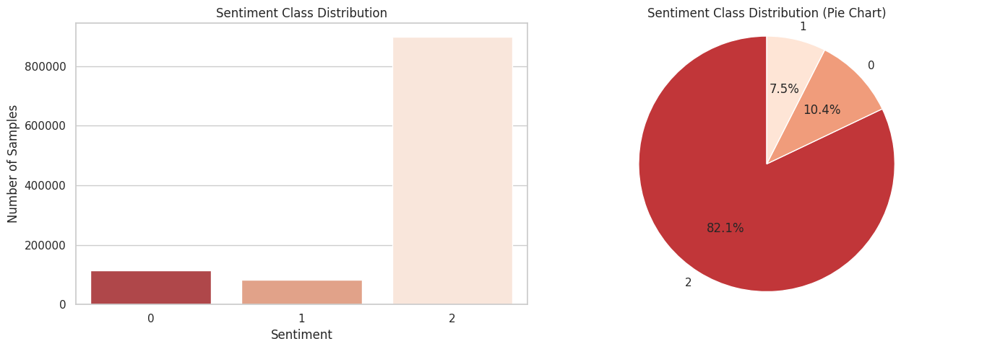

In [125]:
sns.set_palette("RdGy")
class_counts = dr2['sentiment'].value_counts()
print("Class distribution:\n", class_counts)
fig, ax = plt.subplots(1, 2, figsize=(14, 5))
sns.barplot(x=class_counts.index, y=class_counts.values, ax=ax[0])
ax[0].set_title("Sentiment Class Distribution")
ax[0].set_xlabel("Sentiment")
ax[0].set_ylabel("Number of Samples")
ax[1].pie(class_counts, labels=class_counts.index, autopct='%1.1f%%', startangle=90)
ax[1].axis('equal')  
ax[1].set_title("Sentiment Class Distribution (Pie Chart)")
plt.tight_layout() 
plt.show()

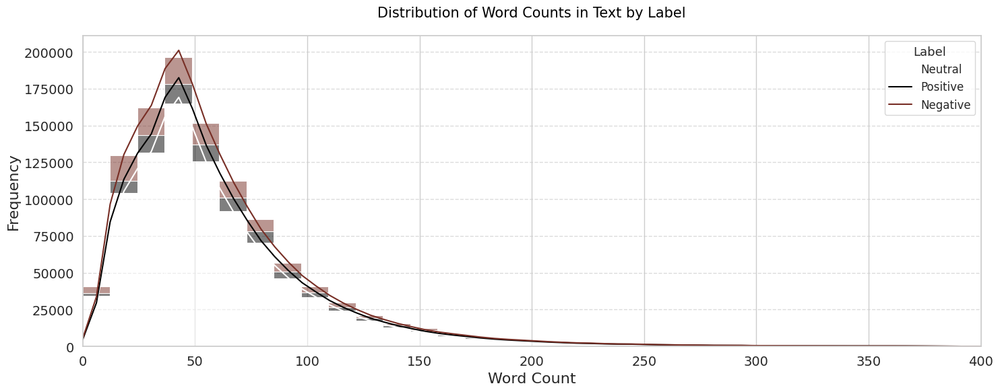

In [126]:
dr2['review_text'] = dr2['review_text'].fillna('')
# Add a new column 'text_word_count' that contains the word count for each text
dr2['text_word_count'] = dr2['review_text'].apply(lambda x: len(x.split()))
# Set the seaborn style
sns.set(style="whitegrid")
# Define custom colors for each class
custom_colors = {0: '#772E25', 1: '#000000', 2: '#ffffff'}  # Red for negative, black for positive
# Plot the distribution of word counts, differentiated by labels
plt.figure(figsize=(15, 6), dpi=100)
sns.histplot(data=dr2, x='text_word_count', bins=100, hue='sentiment', multiple="stack", palette=custom_colors, kde=True)
# Set title and labels
plt.title("Distribution of Word Counts in Text by Label", fontsize=15, pad=20, color='black')
plt.xlabel("Word Count", fontsize=16)
plt.ylabel("Frequency", fontsize=16)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend(title="Label", labels=['Neutral', 'Positive', 'Negative'], fontsize=12, title_fontsize='13')
# Set x-axis limits
plt.xlim(0, 400)  # Set limits for the x-axis
plt.tight_layout()
plt.show()

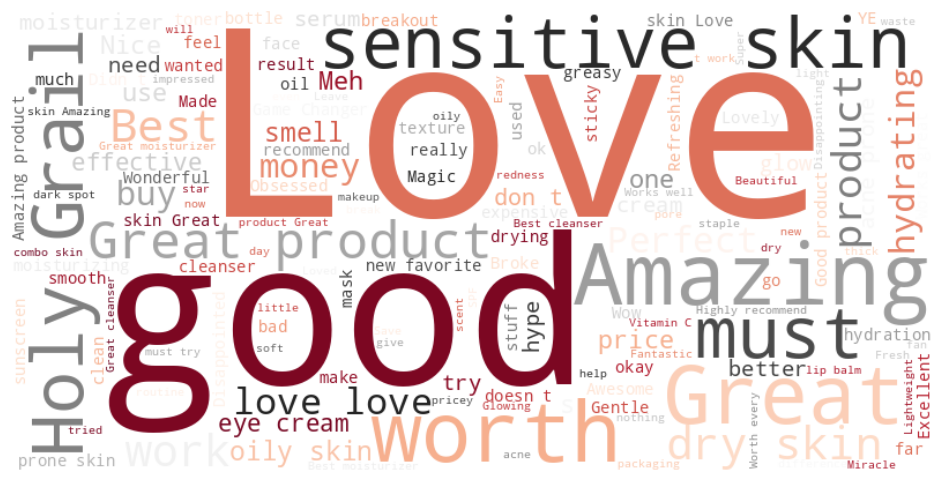

In [127]:
drrr = dr.dropna()
# Extract the "review_text" column from the data frame
review_text = drrr['review_title'].astype(str)
# Define stopwords to be excluded from the word cloud
stopwords = set(STOPWORDS)
stopwords.update(["br", "href", "don t", "didn t", "don't", "doesn'", "didn't" ])  # Add any other stopwords you'd like to exclude
# Create a word cloud
word_cloud = WordCloud(stopwords=stopwords,
                       max_words=150,
                       background_color='white',
                       colormap='RdGy',  # Change the color scheme
                       width=800,
                       height=400).generate(' '.join(review_text))
# Display the generated word cloud
plt.figure(figsize=(12, 6))  # Modify the figure size
plt.imshow(word_cloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [ ]:
dr6 = dr.copy()
dr62 = dr6.drop(columns=['is_recommended','helpfulness','total_feedback_count','total_neg_feedback_count','total_pos_feedback_count','skin_tone','eye_color','skin_type','hair_color'])

In [ ]:
# Ensuring that the reviews and titles are in fact string datatypes
dr62['review_text'] = dr62['review_text'].astype(str)
dr62['review_title'] = dr62['review_title'].astype(str)
# Creating StopWord list
stopwords = set(STOPWORDS)
stopwords.update(['day','night','received','make','week','morning','put','leave'])
# Generating a WordCloud and plotting the results
dt = " ".join(review_title for review_title in dr62.review_text)
wordcloud = WordCloud(stopwords=stopwords, max_words=150,
                       background_color='white',
                       colormap='RdGy',
                       width=800,
                       height=400).generate(' '.join(review_text)).generate(dt)
plt.figure(figsize=(12, 6))  # Modify the figure size
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
wc = dr62[dr62['rating'] !=3]
wc['sentiment']= wc['rating'].apply(lambda rating: +1 if rating >3 else 0)
wc.head(2)

In [ ]:
# Split df into positive and negative
positive = wc[wc['sentiment']==1]
negative = wc[wc['sentiment']==0]

In [ ]:
# Positive
from nltk.corpus import stopwords
# Ensure stopwords are downloaded
nltk.download('stopwords')
# Load English stopwords
stopwords_set = set(stopwords.words('english'))
# Add additional stopwords
stopwords_set.update(['received', 'day', 'make', 'feel', 'leave', 'buy', 'noticed', 'good', 'product', 'great', 'nan', 'work', 'works', 'stuff', 'finally'])
pos = " ".join(review_title for review_title in positive.review_title)

wordcloud2 = WordCloud(stopwords=stopwords_set, max_words=150,
                       background_color='white',
                       colormap='RdGy', 
                       width=800,
                       height=400).generate(pos)

plt.figure(figsize=(12, 6))  # Modify figure size
plt.imshow(wordcloud2, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
# Negative
# Create text for negative word cloud
neg = " ".join(review_title for review_title in negative.review_title)
# Update stopwords for negative word cloud
stopwords_set.update(['work', 'wanted', 'caused', 'made', 'makes', 'buy', 'love'])
# Generate word cloud for negative reviews
wordcloud7 = WordCloud(stopwords=stopwords_set, max_words=150,
                       background_color='white',
                       colormap='RdGy',
                       width=800,
                       height=400).generate(neg)
# Display word cloud
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud7, interpolation='bilinear')
plt.axis("off")
plt.show()

In [ ]:
# Distribution of reviews by sentiment
wc['sentimentanalysis'] = wc['sentiment'].replace({0: 'negative', 1: 'positive'})
fig = px.histogram(wc, x='sentimentanalysis')
fig.update_traces(marker_color='maroon', marker_line_color='black', marker_line_width=1.5)
fig.update_layout(
    title_text='Product Sentiment',
    paper_bgcolor='white',
    plot_bgcolor='white')
fig.show()

In [ ]:
hp = hr.dropna()

In [ ]:
sns.pairplot(data=hp, diag_kind='kde',hue='is_recommended',palette='RdGy',corner=True)
plt.show()

In [ ]:
ff = ['rating', 'is_recommended', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='rating',y=col,hue='is_recommended',data=dr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='total_feedback_count',y=col,hue='is_recommended',data=dr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='total_neg_feedback_count',y=col,hue='is_recommended',data=dr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='total_neg_feedback_count',y=col,hue='is_recommended',data=dr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='total_pos_feedback_count',y=col,hue='is_recommended',data=dr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd']
fig=plt.figure(figsize=(25,18))
for i,col in enumerate(ff):
    ax=fig.add_subplot(3,2,i+1)
    sns.scatterplot(x='price_usd',y=col,hue='is_recommended',data=dr,palette="RdGy")

In [ ]:
fig = plt.figure(figsize=(25, 10))
sns.kdeplot(dr['price_usd'][dr['is_recommended'] == 1], color='#772E25', label='Recommended', linewidth=2, fill=True, alpha=0.3)
sns.kdeplot(dr['price_usd'][dr['is_recommended'] == 0], color='#000000', label='Not Recommended', linewidth=2, fill=True, alpha=0.3)
plt.title("Distribution of price usd by Recommendation Status", fontsize=20)
plt.xlabel("price_usd", fontsize=16)
plt.ylabel("Density", fontsize=16)
plt.legend(title='Recommendation Status', fontsize=14, title_fontsize=16)
plt.show()

In [ ]:
fig = plt.figure(figsize=(25, 10))
sns.kdeplot(dr['helpfulness'][dr['is_recommended'] == 1], color='#772E25', label='Recommended', linewidth=2, fill=True, alpha=0.3)
sns.kdeplot(dr['helpfulness'][dr['is_recommended'] == 0], color='#000000', label='Not Recommended', linewidth=2, fill=True, alpha=0.3)
plt.title("Distribution of Helpfulness by Recommendation Status", fontsize=20)
plt.xlabel("helpfulness", fontsize=16)
plt.ylabel("Density", fontsize=16)
plt.legend(title='Recommendation Status', fontsize=14, title_fontsize=16)
plt.show()

In [ ]:
fig = plt.figure(figsize=(25, 10))
sns.kdeplot(dr['rating'][dr['is_recommended'] == 1], color='#772E25', label='Recommended', linewidth=2, fill=True, alpha=0.3)
sns.kdeplot(dr['rating'][dr['is_recommended'] == 0], color='#000000', label='Not Recommended', linewidth=2, fill=True, alpha=0.3)
plt.title("Distribution of rating by Recommendation Status", fontsize=20)
plt.xlabel("rating Score", fontsize=16)
plt.ylabel("Density", fontsize=16)
plt.legend(title='Recommendation Status', fontsize=14, title_fontsize=16)
plt.show()

In [ ]:
warnings.filterwarnings("ignore")
plt.figure(figsize=(25,15))
plt.subplot(3,3,1)
sns.distplot(dr['rating'],kde=True,color='#772E25')
plt.subplot(3,3,2)
sns.distplot(dr['is_recommended'],kde=True,color='#C44536')
plt.subplot(3,3,3)
sns.distplot(dr['total_feedback_count'],kde=True,color='#772E25')
plt.subplot(3,3,4)
sns.distplot(dr['total_neg_feedback_count'],kde=True,color='#283D3B')
plt.subplot(3,3,5)
sns.distplot(dr['total_pos_feedback_count'],kde=True,color='#197278')
plt.subplot(3,3,6)
sns.distplot(dr['price_usd'],kde=True,color='#283D3B')

In [ ]:
# Measure of skewness
dr[ff].skew(axis = 0, skipna = True) 

In [ ]:
dr_mean = dr[ff].mean()
dr_mean.plot(kind='barh', stacked=True, figsize=(15, 5), cmap="RdGy")
plt.xlabel('Average')
plt.title("Average of 'rating', 'is_recommended', 'total_feedback_count','total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd'")
plt.show()

In [ ]:
dr[ff].boxplot(figsize=(35,10),vert=False)

In [ ]:
palette ="gist_heat"
for column in ff:
    plt.figure(figsize=(15,2))
    sns.violinplot(x=dr[column], palette=palette)
    plt.title(column)
    plt.show()

In [ ]:
palette ="gray"
for column in ff:
    plt.figure(figsize=(15,2))
    sns.boxplot(x=dr[column], palette=palette)
    plt.title(column)
    stats = dr[column].describe()
    stats_text = ", ".join([f"{key}: {value:.2f}" for key, value in stats.items()])
    print(f"\n{column} Statistics:\n{stats_text}")
    plt.show()

In [ ]:
def StDev_method (dr,n,features):
    outliers = []
    for column in features:
        data_mean = dr[column].mean()
        data_std = dr[column].std()
        cut_off = data_std * 3     
        outlier_list_column = dr[(dr[column] < data_mean - cut_off) | (dr[column] > data_mean + cut_off)].index
        outliers.extend(outlier_list_column)
    outliers = Counter(outliers)        
    OUT= list( k for k, v in outliers.items() if v > n )
    dr1 = dr[dr[column] > data_mean + cut_off]
    dr2 = dr[dr[column] < data_mean - cut_off]
    print('Total number of outliers is:', dr1.shape[0]+ dr2.shape[0])
    
    return OUT  
Outliers_StDev = StDev_method(dr,1,ff)
dr_out2 = dr.drop(Outliers_StDev, axis = 0).reset_index(drop=True)

In [ ]:
# Lets check df_product_info which columns that similar with df_reviews
cols = df.columns.difference(dr.columns)
cols = list(cols)
cols.append('product_id')
print(cols)

In [ ]:
d_fr = pd.merge(dr, df[cols], how='outer', on=['product_id', 'product_id'])

In [ ]:
d_fr.columns

In [ ]:
d_fr.shape

In [ ]:
missing = []
unique=[]
type=[]
variables=[]
count = []
for item in d_fr.columns:
    variables.append(item)
    missing.append(d_fr[item].isnull().sum())
    unique.append(d_fr[item].nunique())
    type.append(d_fr[item].dtype)
    count.append(len(d_fr[item]))
output=pd.DataFrame({'variables':variables,'missing':missing,'unique':unique,'dtype':type, 'count':count})
output.sort_values(by='missing',ascending=False)

In [ ]:
def check_d_fr(d_fr: object, head: object = 5) -> object:
    print("\nShape")
    print(d_fr.shape)
    print("\nTypes")
    print(d_fr.dtypes)
    print("\nNANs")
    print(d_fr.isnull().sum())
    print("\nInfo")
    print(d_fr.info())
check_d_fr(d_fr)

In [ ]:
print('Number of duplicated rows: ' , len(d_fr[d_fr.duplicated()]))

In [ ]:
dup=d_fr[d_fr.duplicated]
dup

In [ ]:
plt.figure(figsize=(22,4))
sns.heatmap((df.isna().sum()).to_frame(name='').T,cmap='RdGy', annot=True,
             fmt='0.0f').set_title('Count of Missing Values', fontsize=18)
plt.show()

In [ ]:
msno.bar(d_fr, color='#C44536')
plt.show()

In [ ]:
pt_missing = d_fr.isna().mean()
pt_missing

In [ ]:
plt.figure(figsize=(15,8))
cols= d_fr.columns
colors=['#ffffff','#C44536']
sns.heatmap(d_fr[cols].isna(),cmap=sns.color_palette(colors))

In [ ]:
d_fr.describe().T.style.background_gradient(cmap='RdGy', axis=1)

In [ ]:
# Finding unique data
d_fr.apply(lambda x: len(x.unique()))

In [ ]:
unique = d_fr.nunique().sort_values()
unique_values = d_fr.apply(lambda x: x.unique())
pd.DataFrame({'Number of Unique Values': unique, 'Unique Values': unique_values})

In [ ]:
numeric_cols = d_fr.select_dtypes(include = ['number']).columns
print(numeric_cols)
print(f'{len(numeric_cols)} Numeric Columns in Reviews dataset')

In [ ]:
non_numeric_cols = d_fr.select_dtypes(exclude=['number']).columns
print(non_numeric_cols)
print(f'{len(non_numeric_cols)} Non-Numeric Columns in Reviews dataset')

In [ ]:
# Dropping non-numerical data
hc = d_fr.drop(columns=['submission_time', 'review_text', 'skin_tone',
       'eye_color', 'skin_type', 'hair_color', 'product_id', 'product_name',
       'brand_name', 'highlights', 'ingredients', 'limited_edition', 'new',
       'online_only', 'out_of_stock', 'primary_category', 'secondary_category',
       'sephora_exclusive', 'size', 'tertiary_category',
       'variation_type', 'variation_value'])

In [ ]:
hc.corr(numeric_only=True).T.style.background_gradient(cmap='RdGy', axis=1)

In [ ]:
plt.figure(figsize=(20, 12))
sns.heatmap(hc.corr(numeric_only=True), cmap="RdGy", annot=True, linewidths=.6 , cbar = False)
plt.xticks(rotation=60, size=10)
plt.yticks(size=10)
plt.title('Analysis of Correlations', size=20)
plt.tight_layout()
plt.show()

In [ ]:
corr = hc.corr(numeric_only=True)
f, ax = plt.subplots(figsize=(15, 5))
mask = np.triu(np.ones_like(corr, dtype=bool))
cut_off = 0.25
extreme_1 = 0.5
extreme_2 = 0.75
extreme_3 = 0.9
mask |= np.abs(corr) < cut_off
corr = corr[~mask]
remove_empty_rows_and_cols = True
if remove_empty_rows_and_cols:
    wanted_cols = np.flatnonzero(np.count_nonzero(~mask, axis=1))
    wanted_rows = np.flatnonzero(np.count_nonzero(~mask, axis=0))
    corr = corr.iloc[wanted_cols, wanted_rows]

annot = [[f"{val:.4f}"
          + ('' if abs(val) < extreme_1 else '\n*')
          + ('' if abs(val) < extreme_2 else '*')
          + ('' if abs(val) < extreme_3 else '*')
          for val in row] for row in corr.to_numpy()]
heatmap = sns.heatmap(corr, vmin=-1, vmax=1, annot=annot, fmt='', cmap='RdGy')
heatmap.set_title('Triangle Correlation Heatmap', fontdict={'fontsize': 12}, pad=16)
plt.show()

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['rating']].sort_values (by = 'rating', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with rating', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['child_max_price']].sort_values (by = 'child_max_price', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with child_max_price', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['child_min_price']].sort_values (by = 'child_min_price', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with child_min_price', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['child_count']].sort_values (by = 'child_count', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with child_count', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['helpfulness']].sort_values (by = 'helpfulness', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with helpfulness', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['total_feedback_count']].sort_values (by = 'total_feedback_count', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with total_feedback_count', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['reviews']].sort_values (by = 'reviews', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with reviews', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['is_recommended']].sort_values (by = 'is_recommended', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with is_recommended', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['total_pos_feedback_count']].sort_values (by = 'total_pos_feedback_count', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with total_pos_feedback_count', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['total_neg_feedback_count']].sort_values (by = 'total_neg_feedback_count', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with total_neg_feedback_count', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['loves_count']].sort_values (by = 'loves_count', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with loves_count', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['rating']].sort_values (by = 'rating', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with rating', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['price_usd']].sort_values (by = 'price_usd', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with price_usd', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
plt.figure (figsize = (15 , 3) , dpi = 100)
heatmap = sns.heatmap (hc.corr(numeric_only=True)[['sale_price_usd']].sort_values (by = 'sale_price_usd', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'RdGy')
heatmap.set_title ('Features Correlating with sale_price_usd', fontdict = {'fontsize':12} , pad = 18);

In [ ]:
# Dropping non-numerical data
hc2 = d_fr.drop(columns=['submission_time', 'review_text', 'skin_tone',
       'eye_color', 'skin_type', 'hair_color', 'product_id', 'product_name',
       'brand_name', 'highlights', 'ingredients', 'limited_edition', 'new',
       'online_only', 'out_of_stock', 'primary_category', 'secondary_category',
       'sephora_exclusive', 'size', 'tertiary_category',
       'variation_type', 'variation_value','brand_id'])

In [ ]:
sns.pairplot(data=hc2, diag_kind='kde',hue='is_recommended',palette='RdGy',corner=True)
plt.show()

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='rating',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='helpfulness',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='total_feedback_count',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='total_neg_feedback_count',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='total_pos_feedback_count',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='price_usd',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='child_count',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='child_max_price',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='child_min_price',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='loves_count',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='reviews',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='sale_price_usd',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x='value_price_usd',y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
d_fr['submission_time'] = pd.to_datetime(d_fr['submission_time'])
d_fr['year']= d_fr['submission_time'].dt.year
d_fr['month']= d_fr['submission_time'].dt.month
d_fr['day']= d_fr['submission_time'].dt.day
d_fr['weekday']= d_fr['submission_time'].dt.weekday
dw_mapping={
    0: 'Monday', 
    1: 'Tuesday', 
    2: 'Wednesday', 
    3: 'Thursday', 
    4: 'Friday',
    5: 'Saturday', 
    6: 'Sunday'} 
d_fr['dayofweek']= d_fr['submission_time'].dt.weekday.map(dw_mapping)

In [ ]:
# Define formatter for displaying numbers in thousands on the y-axis
def thousands_formatter(x, pos):
    return f'{int(x / 1000)}K'
# Set Seaborn style
sns.set(style="whitegrid")
# Create subplot
fig, ax1 = plt.subplots(figsize=(15, 5))
# Total feedback data
total_feedback = d_fr.groupby('year').sum(numeric_only=True)['total_feedback_count'].reset_index()
total_pos_feedback = d_fr.groupby('year').sum(numeric_only=True)['total_pos_feedback_count'].reset_index()
total_neg_feedback = d_fr.groupby('year').sum(numeric_only=True)['total_neg_feedback_count'].reset_index()
# Plot the data
sns.pointplot(data=total_feedback, x='year', y='total_feedback_count', color="red", label="Total Feedback", ax=ax1)
sns.pointplot(data=total_pos_feedback, x='year', y='total_pos_feedback_count', color="gray", label="Positive Feedback", ax=ax1)
sns.pointplot(data=total_neg_feedback, x='year', y='total_neg_feedback_count', color="black", label="Negative Feedback", ax=ax1)
# Axis settings
ax1.yaxis.set_major_formatter(FuncFormatter(thousands_formatter))
ax1.set_ylabel("Total Feedback (in Thousands)", fontsize=14)
ax1.set_xlabel("Year", fontsize=14)
ax1.grid(True, which='both', linestyle='--', linewidth=0.5)
ax1.legend(title='Feedback Type', fontsize=12, title_fontsize=14)
ax1.set_title("Yearly Feedback Overview", fontsize=16)
plt.show()

In [ ]:
# Create subplots with 2 rows and 1 column
fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(20, 10))
fig.subplots_adjust(hspace=0.5)
# Color palette
palette = 'RdGy'
# Most expensive products data
most_expensive = d_fr.groupby(['product_id', 'product_name', 'price_usd']).sum(numeric_only=True).reset_index().sort_values('price_usd', ascending=True).head(10).sort_values('price_usd', ascending=False)
# Cheapest products data
cheapest = d_fr.groupby(['product_id', 'product_name', 'price_usd']).sum(numeric_only=True).reset_index().sort_values('price_usd', ascending=False).head(10)
# Function to plot the charts
def plot_top_products(products, ax, title):
    sns.barplot(data=products, x='price_usd', y='product_name', ax=ax, palette=palette)
    ax.set_title(title, fontsize=16)
    ax.set_xlabel("Price in USD", fontsize=14)
    ax.set_ylabel("Product Name", fontsize=14)
    ax.grid(True, which='both', linestyle='--', linewidth=0.5)
    for container in ax.containers:
        ax.bar_label(container, fontsize=12, padding=3)
# Plot the charts
plot_top_products(most_expensive, ax1, "Top 10 Most Expensive Products")
plot_top_products(cheapest, ax2, "Top 10 Cheapest Products")
# Main title settings
fig.suptitle("Top 10 Products Based on Price", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

In [ ]:
sns.set(style="whitegrid")
# Create subplots with 2 rows and 1 column
fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(20, 10))
fig.subplots_adjust(hspace=0.5)
palette = 'RdGy'
# Most recommended products data
most_recommended = d_fr.groupby(['product_id', 'product_name', 'brand_name']).sum(numeric_only=True)['is_recommended'].reset_index().sort_values('is_recommended', ascending=False).head(10)
# Most helpful products data
most_helpfulness = d_fr.groupby(['product_id', 'product_name', 'brand_name']).sum(numeric_only=True)['helpfulness'].reset_index().sort_values('helpfulness', ascending=False).head(10)
# Function to plot the charts
def plot_top_products(products, x_col, y_col, ax, title, xlabel):
    sns.barplot(data=products, x=x_col, y=y_col, ax=ax, palette=palette)
    ax.set_title(title, fontsize=16)
    ax.set_xlabel(xlabel, fontsize=14)
    ax.set_ylabel("Product Name", fontsize=14)
    ax.grid(True, which='both', linestyle='--', linewidth=0.5)
    for container in ax.containers:
        ax.bar_label(container, fontsize=12, padding=3)
# Plot the charts
plot_top_products(most_recommended, 'is_recommended', 'product_name', ax1, "Top 10 Most Recommended Products", "Total Recommended")
plot_top_products(most_helpfulness, 'helpfulness', 'product_name', ax2, "Top 10 Most Helpful Products", "Total Helpfulness")
# Main title settings
fig.suptitle("Top 10 Products", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

In [ ]:
# Set Seaborn style
sns.set(style="whitegrid")
# Create subplots with 4 rows and 1 column
fig, axs = plt.subplots(nrows=4, ncols=1, figsize=(20, 20))
fig.subplots_adjust(hspace=0.5)
# Color palette
palette = 'RdGy'
# Group and sort products by skin type and rating
product_skin = d_fr.groupby(['skin_type', 'product_id', 'product_name', 'price_usd']).mean(numeric_only=True)['rating'].reset_index().sort_values('rating', ascending=False)
def plot_top_products(skin_type, ax):
    top_products = product_skin[product_skin['skin_type'] == skin_type].sort_values('price_usd', ascending=True).sort_values(['rating'], ascending=False).head(10).sort_values('price_usd', ascending=True)
    sns.barplot(data=top_products, x='price_usd', y='product_name', ax=ax, palette=palette)
    ax.set_title(f"Top 10 Products Based on Rating and Price for {skin_type.capitalize()} Skin Type", fontsize=16)
    ax.set_xlabel("Price (USD)", fontsize=14)
    ax.set_ylabel("Product Name", fontsize=14)
    ax.grid(True, which='both', linestyle='--', linewidth=0.5)
    for container in ax.containers:
        ax.bar_label(container, fontsize=12, padding=3)
# Plot charts for each skin type
plot_top_products('normal', axs[0])
plot_top_products('dry', axs[1])
plot_top_products('oily', axs[2])
plot_top_products('combination', axs[3])
fig.suptitle("Most Recommended Products for Each Skin Type", fontsize=20)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

In [ ]:
# Lets see the relationship between loves_count and the price_usd of the product
def remove_outliers(data, lower_quantile=0.25, upper_quantile=0.75):
    lower_bound = np.quantile(data, lower_quantile)
    upper_bound = np.quantile(data, upper_quantile)
    cleaned_data = data[(data >= lower_bound) & (data <= upper_bound)]
    return cleaned_data
# Remove outliers using quantiles (5th percentile to 95th percentile)
cleaned_data = remove_outliers(d_fr['loves_count'], lower_quantile=0.25, upper_quantile=0.75)
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
sns.set(style="whitegrid")
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x=cleaned_data,y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
# Lets see the relationship between loves_count and the price_usd of the product
def remove_outliers(data, lower_quantile=0.25, upper_quantile=0.75):
    lower_bound = np.quantile(data, lower_quantile)
    upper_bound = np.quantile(data, upper_quantile)
    cleaned_data = data[(data >= lower_bound) & (data <= upper_bound)]
    return cleaned_data
# Remove outliers using quantiles (5th percentile to 95th percentile)
cleaned_data = remove_outliers(d_fr['loves_count'], lower_quantile=0.25, upper_quantile=0.75)
ff = ['rating', 'is_recommended', 'helpfulness', 'total_feedback_count',
       'total_neg_feedback_count', 'total_pos_feedback_count', 'price_usd',
       'child_count', 'child_max_price', 'child_min_price',
       'loves_count', 'reviews', 'sale_price_usd', 'value_price_usd']
fig=plt.figure(figsize=(25,28))
for i,col in enumerate(ff):
    ax=fig.add_subplot(7,2,i+1)
    sns.scatterplot(x=cleaned_data,y=col,hue='is_recommended',data=d_fr,palette="RdGy")

In [ ]:
# define constants
RANDOM_STATE = 42
dr3 = dr.copy()

In [ ]:
missing = []
unique=[]
type=[]
variables=[]
count = []
for item in dr3.columns:
    variables.append(item)
    missing.append(dr3[item].isnull().sum())
    unique.append(dr3[item].nunique())
    type.append(dr3[item].dtype)
    count.append(len(dr3[item]))
output=pd.DataFrame({'variables':variables,'missing':missing,'unique':unique,'type':type, 'count':count})
output.sort_values(by='missing',ascending=False)

In [ ]:
# Lets check df_product_info which columns that similar with df_reviews
cols_to_use = df.columns.difference(dr.columns)
cols_to_use = list(cols_to_use)
cols_to_use.append('product_id')
print(cols_to_use)

In [ ]:
# Check the number of occurrences of each unique value in the 'rating' column
rating_counts = dr3['rating'].value_counts()
# Print the number of occurrences of each rating
print("Number of occurrences of each rating:")
print(rating_counts)

In [ ]:
# Check the number of occurrences of each unique value in the 'rating' column
is_recommended_counts = dr3['is_recommended'].value_counts()
# Print the number of occurrences of each rating
print("Number of occurrences of each is_recommended	:")
print(is_recommended_counts)

In [ ]:
dr3 = dr3[['review_text' , 'is_recommended' , 'rating']]
# change column names
dr3.rename(columns={'review_text':'text', 'is_recommended':'label'},  inplace=True)
dr3.head()

In [ ]:
def check_dr3(dr3: object, head: object = 5) -> object:
    print("\nShape")
    print(dr3.shape)
    print("\nTypes")
    print(dr3.dtypes)
    print("\nNANs")
    print(dr3.isnull().sum())
    print("\nInfo")
    print(dr3.info())
check_dr3(dr3)

In [ ]:
dr3['label'].value_counts()

In [ ]:
#Percentage of Positive/Negative
print("Positive: ", round(dr3.label.value_counts()[1]/len(dr3)*100 , 2 ),"%")
print("Negative: ", round(dr3.label.value_counts()[0]/len(dr3)*100, 2 ),"%")

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(15, 4))
sns.countplot(x='label', data=dr3,hue='rating',palette='gray')
plt.title('Distribution of Reviews')
plt.xlabel('Review')
plt.ylabel('Count')
plt.show()

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(15, 4))
sns.countplot(x='label', data=dr3,palette='gray')
plt.title('Distribution of Reviews')
plt.xlabel('Review')
plt.ylabel('Count')
plt.show()

In [ ]:
# Sample equal number of instances for each class
dr3_neg=  dr3[dr3['label'] == 0]
print('No. of Negtive class:' , len(dr3_neg))
dr3_pos=  dr3[dr3['label'] == 1].sample(len(dr3_neg))
print('No. of taken samples of Positive class', len(dr3_pos))

In [ ]:
dr3_neg['label'].value_counts()

In [ ]:
dr3_pos['label'].value_counts()

In [ ]:
# Merge the positive and negative class samples into a single DataFrame
dr4= pd.concat([dr3_pos, dr3_neg], axis=0) 
# Shuffle the rows of the merged DataFrame
dr4 = shuffle(dr4)
dr4.head()

In [ ]:
# Percentage of Positive/Negative in the balanced DataFrame
print("Positive: ", round(dr4.label.value_counts()[1]/len(dr4)*100 , 2 ),"%")
print("Negative: ", round(dr4.label.value_counts()[0]/len(dr4)*100, 2 ),"%")

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(15, 4))
sns.countplot(x='label', data=dr4,hue='rating',palette='Reds')
plt.title('Distribution of Reviews')
plt.xlabel('Review')
plt.ylabel('Count')
plt.show()

In [ ]:
sns.set(style="whitegrid")
plt.figure(figsize=(15, 4))
sns.countplot(x='label', data=dr4,palette='Reds')
plt.title('Distribution of Reviews')
plt.xlabel('Review')
plt.ylabel('Count')
plt.show()

In [ ]:
sns.set(style="whitegrid")
fig, axs = plt.subplots(1, 2, figsize=(15, 7))
colors = ['#C20000', '#7F7F7F']
dr3_counts = dr3['label'].value_counts()
axs[0].pie(dr3_counts, labels=['Positive', 'Negative'], autopct='%.2f%%', explode=[0.05, 0.05], colors=colors, startangle=90, wedgeprops={'edgecolor': 'white'})
axs[0].set_title('Distribution of Target (Original)', fontsize=16)
dr4_counts = dr4['label'].value_counts()
axs[1].pie(dr4_counts, labels=['Positive', 'Negative'], autopct='%.2f%%', explode=[0.05, 0.05], colors=colors, startangle=90, wedgeprops={'edgecolor': 'white'})
axs[1].set_title('Distribution of Target (Balanced)', fontsize=16)
for ax in axs:
    ax.axis('equal') 
plt.suptitle('Sentiment Distribution Comparison', fontsize=18)
plt.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [ ]:
# Checking null values
dr4.isnull().sum()

In [ ]:
# drop rows with nullable values
shape_before = df4.shape[0]
print('shape before :', df4.shape)
df4 = df4.dropna()
shape_after = df4.shape[0]
df4 = df4.reset_index(drop=True)
print('shape after :', df4.shape)

print (shape_before-shape_after , ' rows were dropped')

In [ ]:
# Ensure that there are no null values in the DataFrame and display general information
def check_dataframe(df):
    # Display the number of null values in each column
    null_counts = df.isnull().sum()
    print('Nullable Values:\n', null_counts, '\n\n')
    # Display general information about the DataFrame
    print('DataFrame Info:')
    df.info()
    # Display the distribution of null values as a percentage
    total_cells = df.size
    total_missing = null_counts.sum()
    missing_percentage = (total_missing / total_cells) * 100
    print(f'\nPercentage of missing values: {missing_percentage:.2f}%')
    # Display statistics for numeric columns
    print('\nStatistical Summary of Numeric Columns:')
    print(df.describe())
check_dataframe(dr4)

In [ ]:
# Convert label column to int 
dr4['label'] = dr4['label'].astype('int')

In [ ]:
pd.set_option('display.max_colwidth', None)
dr4.head(10)

In [ ]:
# Display a series of comments based on random indexes
def display_review(index_lst):
    style = """
    <style>
        .review-container {
            background-color: #f9f9f9;
            border-radius: 8px;
            padding: 15px;
            margin: 10px 0;
            box-shadow: 0 0 10px rgba(0, 0, 0, 0.1);
        }
        .review-header {
            color: #4C4C4C;
            font-size: 1.2em;
            font-weight: bold;
        }
        .review-text {
            color: #333;
            font-size: 1em;
            margin: 10px 0;
        }
        .review-label {
            color: #4C4C4C;
            font-size: 1em;
            margin: 5px 0;
        }
        .review-rating {
            color: #4C4C4C;
            font-size: 1em;
            margin: 5px 0;
        }
    </style>
    """
    display(HTML(style))
    for i in index_lst:
        review_html = f"""
        <div class="review-container">
            <div class="review-header">Review:</div>
            <div class="review-text">{dr4['text'].iloc[i]}</div>
            <div class="review-label"><b>Target:</b> {"negative" if dr4['label'].iloc[i] == 0 else "positive"}</div>
            <div class="review-rating"><b>Rating:</b> {dr4['rating'].iloc[i]}</div>
        </div>
        """
        display(HTML(review_html))
        
# Create an array of random integers
index_lst = np.random.randint(0, len(dr4), 20)
display_review(index_lst)

In [ ]:
# Sentiment count 
dr4['label'].value_counts()

In [ ]:
# Fill in empty values in the 'text' column
dr4['text'] = dr4['text'].fillna('')
# Add a new column 'text_word_count' that contains the word count for each text
dr4['text_word_count'] = dr4['text'].apply(lambda x: len(x.split()))
# Set the seaborn style
sns.set(style="whitegrid")
# Plot the distribution of word counts
plt.figure(figsize=(12, 6), dpi=100)
sns.histplot(data=dr4, x='text_word_count', bins=50, color='#772E25', kde=True)
# Set title and labels
plt.title("Distribution of Word Counts in Text", fontsize=15, pad=20, color='black')
plt.xlabel("Word Count", fontsize=16)
plt.ylabel("Frequency", fontsize=16)
# Improve display and readability
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Display the plot
plt.tight_layout()
plt.show()

In [ ]:
# Add a new column 'text_word_count' that contains the word count for each text
dr4['text_word_count'] = dr4['text'].apply(lambda x: len(x.split()))
# Set the seaborn style
sns.set(style="whitegrid")
# Define custom colors for each class
custom_colors = {0: '#772E25', 1: '#000000'}  # Red for negative, black for positive
# Plot the distribution of word counts, differentiated by labels
plt.figure(figsize=(12, 6), dpi=100)
sns.histplot(data=dr4, x='text_word_count', bins=50, hue='label', multiple="stack", palette=custom_colors, kde=True)
# Set title and labels
plt.title("Distribution of Word Counts in Text by Label", fontsize=15, pad=20, color='black')
plt.xlabel("Word Count", fontsize=16)
plt.ylabel("Frequency", fontsize=16)
# Adjust axis settings
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
# Adjust legend settings
plt.legend(title="Label", labels=['Negative', 'Positive'], fontsize=12, title_fontsize='13')
# Display the plot
plt.tight_layout()
plt.show()

In [ ]:
print("Before Preprocessing:")
print(dr4.iloc[10])

In [ ]:
# Remove extra characters
dr4['text']=dr4['text'].str.replace('[^\w\s]','')

In [ ]:
# Tokenizer
tokenizer = ToktokTokenizer()  # Initializes a tokenizer, which is used to break down text into individual tokens (words or phrases) for further processing.

# Set the stopword list
stopword_list = nltk.corpus.stopwords.words('english')  # Retrieves a list of common English stopwords from the NLTK library.
stop = set(stopword_list)  # Converts the list of stopwords into a set for faster lookup when filtering.

# Remove HTML tags
def strip_html(text):
    soup = BeautifulSoup(text, "html.parser")  # Parses the input text to handle HTML tags.
    return soup.get_text()  # Extracts and returns the plain text, stripping away any HTML formatting.

# Remove square brackets
def remove_between_square_brackets(text):
    return re.sub(r'\[.*?\]', '', text)  # Uses regex to find and remove any content between square brackets, as this often contains irrelevant information.

# Remove noise from text
def denoise_text(text):
    text = strip_html(text)  # First, strip HTML tags from the text.
    text = remove_between_square_brackets(text)  # Then, remove any content within square brackets to clean the text.
    return text  # Returns the cleaned text free of HTML and bracketed content.

# Remove special characters
def remove_special_characters(text, remove_digits=True):
    if remove_digits:
        pattern = r'[^a-zA-Z\s]'  # Creates a regex pattern to match any character that is not a letter or whitespace, effectively removing special characters and digits.
    else:
        pattern = r'[^a-zA-Z0-9\s]'  # This pattern allows numbers to remain in the text while still removing special characters.
    text = re.sub(pattern, '', text)  # Applies the regex pattern to the text, removing unwanted characters.
    return text  # Returns the cleaned text.

# Stem the text
def simple_stemmer(text):
    ps = nltk.porter.PorterStemmer()  # Initializes the Porter Stemmer, which reduces words to their base or root form.
    text = ' '.join([ps.stem(word) for word in text.split()])  # Applies stemming to each word in the text and rejoins them into a single string.
    return text  # Returns the stemmed text.

# Remove stopwords
def remove_stopwords(text, is_lower_case=False):
    tokens = tokenizer.tokenize(text)  # Tokenizes the input text into individual words or tokens.
    tokens = [token.strip() for token in tokens]  # Strips whitespace from each token.
    if is_lower_case:
        # If the input text is already in lowercase, filter out stopwords without converting.
        filtered_tokens = [token for token in tokens if token not in stop]  
    else:
        # If the input text is not in lowercase, convert tokens to lowercase for stopword comparison.
        filtered_tokens = [token for token in tokens if token.lower() not in stop]  
    filtered_text = ' '.join(filtered_tokens)  # Joins the filtered tokens back into a single string.
    return filtered_text  # Returns the cleaned text with stopwords removed.

In [ ]:
# Create a Console object
console = Console()
# Apply function on review column
# HTML strips & square brackets were removed from the original text
console.print(Text('BEFORE (denoise_text)..', style='bold red'))  # Title changed to dark red
original_text = str(dr4['text'].iloc[2])  # Text changed to black on grey
wrapped_original_text = '\n'.join(textwrap.wrap(original_text, width=80))
console.print(Text(wrapped_original_text, style='black on grey'))
# Process the text
dr4['text'] = dr4['text'].apply(denoise_text)
# Print after processing
console.print(Text('\nAFTER (denoise_text)..', style='bold red'))  # Title changed to dark red
denoised_text = str(dr4['text'].iloc[2])
wrapped_denoised_text = '\n'.join(textwrap.wrap(denoised_text, width=80))
console.print(Text(wrapped_denoised_text, style='black on grey'))
plt.figure(figsize=(12, 6), dpi=100)
plt.style.use('seaborn-whitegrid')
wordcloud_before = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud for before processing
plt.subplot(1, 2, 1)
plt.imshow(wordcloud_before, interpolation='bilinear')
plt.axis('off')
plt.title("Before Denoising", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red
# Create WordCloud for after processing
wordcloud_after = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud for after processing
plt.subplot(1, 2, 2)
plt.imshow(wordcloud_after, interpolation='bilinear')
plt.axis('off')
plt.title("After Denoising", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
# Remove digits
# Regex (regular expressions)
dr4['text'] = dr4['text'].str.replace(r'\d+', '', regex=True)
# Remove leading and trailing spaces
dr4['text'] = dr4['text'].str.replace(r'^\s+|\s+$', '', regex=True)
# Make the text lowercase
dr4['text'] = dr4['text'].str.lower()

In [ ]:
# Create a Console object
console = Console()
console.print(Text('BEFORE (remove_special_characters)..', style='bold red'))  # Title changed to dark red
original_text = str(dr4['text'].iloc[2])  # The text is set to black on grey background
wrapped_original_text = '\n'.join(textwrap.wrap(original_text, width=80))
console.print(Text(wrapped_original_text, style='black on grey'))
# Process the text
dr4['text'] = dr4['text'].apply(remove_special_characters)
console.print(Text('\nAFTER (remove_special_characters)..', style='bold red'))  # Title changed to dark red
processed_text = str(dr4['text'].iloc[2])
wrapped_processed_text = '\n'.join(textwrap.wrap(processed_text, width=80))
console.print(Text(wrapped_processed_text, style='black on grey'))
plt.figure(figsize=(12, 6), dpi=100)
plt.style.use('seaborn-whitegrid')
wordcloud_before = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud before removing special characters
plt.subplot(1, 2, 1)
plt.imshow(wordcloud_before, interpolation='bilinear')
plt.axis('off')
plt.title("Before Removing Special Characters", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red
# Create WordCloud for after processing
wordcloud_after = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud after removing special characters
plt.subplot(1, 2, 2)
plt.imshow(wordcloud_after, interpolation='bilinear')
plt.axis('off')
plt.title("After Removing Special Characters", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
# Create a Console object
console = Console()
console.print(Text('BEFORE (simple_stemmer)..', style='bold red'))  # Title changed to dark red
original_text = str(dr4['text'].iloc[2])  # Text changed to black on grey
wrapped_original_text = '\n'.join(textwrap.wrap(original_text, width=80))
console.print(Text(wrapped_original_text, style='black on grey'))

# Process the text
dr4['text'] = dr4['text'].apply(simple_stemmer)
console.print(Text('\nAFTER (simple_stemmer)..', style='bold red'))  # Title changed to dark red
processed_text = str(dr4['text'].iloc[2])
wrapped_processed_text = '\n'.join(textwrap.wrap(processed_text, width=80))
console.print(Text(wrapped_processed_text, style='black on grey'))
plt.figure(figsize=(12, 6), dpi=100)
plt.style.use('seaborn-whitegrid')
wordcloud_before = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud for before processing
plt.subplot(1, 2, 1)
plt.imshow(wordcloud_before, interpolation='bilinear')
plt.axis('off')
plt.title("Before Simple Stemming", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red
# Create WordCloud for after processing
wordcloud_after = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud for after processing
plt.subplot(1, 2, 2)
plt.imshow(wordcloud_after, interpolation='bilinear')
plt.axis('off')
plt.title("After Simple Stemming", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red

# Show the plot
plt.tight_layout()
plt.show()


In [ ]:
# Create a Console object
console = Console()
console.print(Text('BEFORE (remove_stopwords)..', style='bold red'))  # Title changed to dark red
original_text = str(dr4['text'].iloc[2])  # Text changed to black on grey
wrapped_original_text = '\n'.join(textwrap.wrap(original_text, width=80))
console.print(Text(wrapped_original_text, style='black on grey'))

# Process the text by removing stopwords
dr4['text'] = dr4['text'].apply(remove_stopwords)
console.print(Text('\nAFTER (remove_stopwords)..', style='bold red'))  # Title changed to dark red
processed_text = str(dr4['text'].iloc[2])
wrapped_processed_text = '\n'.join(textwrap.wrap(processed_text, width=80))
console.print(Text(wrapped_processed_text, style='black on grey'))
plt.figure(figsize=(12, 6), dpi=100)
plt.style.use('seaborn-whitegrid')
wordcloud_before = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud before processing
plt.subplot(1, 2, 1)
plt.imshow(wordcloud_before, interpolation='bilinear')
plt.axis('off')
plt.title("Before Removing Stopwords", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red
wordcloud_after = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud after processing
plt.subplot(1, 2, 2)
plt.imshow(wordcloud_after, interpolation='bilinear')
plt.axis('off')
plt.title("After Removing Stopwords", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red

# Display the plot
plt.tight_layout()
plt.show()

In [ ]:
# Define the remove_repeated_chars function
def remove_repeated_chars(text):
    # Define the regex pattern to match consecutive repeated characters
    pattern = re.compile(r'(.)\1{2,}')  # Matches 2 or more consecutive repetitions of the same character
    # Replace consecutive repeated characters with a single occurrence
    cleaned_text = pattern.sub(r'\1', text)
    return cleaned_text
# Apply the remove_repeated_chars function to the 'text' column
dr4['text'] = dr4['text'].apply(remove_repeated_chars)

In [ ]:
# Create a Console object
console = Console()
# Process the text and calculate the word count after processing
dr4['text'] = dr4['text'].apply(remove_stopwords)
dr4['text_word_count'] = dr4['text'].apply(lambda x: len(x.split()))
console.print(Text('\nAFTER (remove_stopwords)..', style='bold red'))  # Title changed to dark red
# Fetch the specific row for better formatting
row = dr4.iloc[10]
# Format the output for readability
formatted_text = f"Text: {row['text']}\n"
formatted_text += f"Label: {row['label']}\n"
formatted_text += f"Rating: {row['rating']}\n"
formatted_text += f"Word Count: {row['text_word_count']}\n"

# Print the formatted text
console.print(Text(formatted_text, style='black on grey'))  # Display in black on grey
plt.figure(figsize=(12, 6), dpi=100)
plt.style.use('seaborn-whitegrid')
# Create WordCloud for the processed text
wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='RdGy').generate(' '.join(dr4['text']))

# Display WordCloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Word Cloud After Preprocessing", fontsize=18, fontweight='bold', color='darkred')  # Title changed to dark red

# Display the plot
plt.tight_layout()
plt.show()

In [ ]:
from rich.table import Table
# Create a Console object
console = Console()
# Create a table with custom styles
table = Table(header_style="black", row_styles=["black", "red"], width=115)  # Add styles to the rows
# Add columns to the table with center alignment
table.add_column("Index", style="cyan", justify="center")
table.add_column("Text", style="cyan", justify="center")
table.add_column("Label", style="red", justify="center")
table.add_column("Rating", style="yellow", justify="center")
# Add rows to the table
for index, row in dr4.head(10).iterrows():
    table.add_row(str(index), row['text'], str(row['label']), str(row['rating']))
# Print the table
console.print(table)

In [ ]:
# Set random seed for reproducibility
RANDOM_STATE = 42

# Split data into train, validation, and test sets (set aside 20% of data for test)
dr4_train, dr4_test = train_test_split(dr4, test_size=0.20, shuffle=True, random_state=RANDOM_STATE)
dr4_train, dr4_validation = train_test_split(dr4_train, test_size=0.15, random_state=RANDOM_STATE)

# Function to display titles in bold red within a light gray box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))

# Display the sizes of the datasets in styled boxes
display_in_box("Training data size:", len(dr4_train))
display_in_box("Validation data size:", len(dr4_validation))
display_in_box("Test data size:", len(dr4_test))

In [ ]:
# Split data into (Features and Target)
def split_data (DATA_SET):
    # Initialize sentences and labels lists
    sentences = []
    labels = []
    # Loop over all  examples and save the sentences and labels
    for s,l in DATA_SET:
      sentences.append(s)
      labels.append(l)
    # Convert labels lists to numpy array
    labels_final = np.array(labels)
    return sentences, labels_final


# Split data into features and labels
train_sentences, train_labels = split_data(dr4_train[['text', 'label']].values)
validation_sentences, validation_labels = split_data(dr4_validation[['text', 'label']].values)
test_sentences, test_labels = split_data(dr4_test[['text', 'label']].values)

# Tokenizer parameters )Build & train model()
# Vocabulary size of the tokenizer
vocab_size = 15000  # Increase to 15,000 for broader vocabulary coverage
# Maximum length of the padded sequences
max_length = 64  # Increase to 64 for better coverage of longer texts
# Output dimensions of the Embedding layer
embedding_dim = 128  # Increase to 128 for better feature learning
# Dimensions of the LSTM layer
lstm_dim = 64  # Increase to 64 for increased model capacity
# Dimensions of the Dense layer
dense_dim = 32  # Increase to 32 for better pattern learning
NUM_EPOCHS = 30  # Number of epochs can be suitable, but you can control better with EarlyStopping
BATCH_SIZE = 128  # Decrease to 128 for more stable learning
# Parameters for padding and OOV tokens
trunc_type='post'
padding_type='post'
oov_tok = "<OOV>"

In [ ]:
from IPython.display import display, HTML

# Function to display data in a styled box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))

# Display the sizes of the datasets in styled boxes
display_in_box("Original set:", str(dr4.shape))
display_in_box("Training set:", f"{len(train_sentences)}, {len(train_labels)}")
display_in_box("Validation set:", f"{len(validation_sentences)}, {len(validation_labels)}")
display_in_box("Testing set:", str(dr4_test.shape))

In [ ]:
# Initialize the Tokenizer class
tokenizer = Tokenizer(num_words=vocab_size, oov_token=oov_tok)
# Fit the tokenizer on the training sentences to generate the word index dictionary
tokenizer.fit_on_texts(train_sentences)
word_index = tokenizer.word_index # Generate word index
# Generate and pad the training sequences (Tokenize and pad the sequences)
training_sequences = tokenizer.texts_to_sequences(train_sentences)
training_padded = pad_sequences(training_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)
# Generate and pad the validation sequences
validation_sequences = tokenizer.texts_to_sequences(validation_sentences)
validation_padded = pad_sequences(validation_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)
test_sequences = tokenizer.texts_to_sequences(test_sentences)
test_padded = pad_sequences(test_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)

# Convert labels to numpy arrays
training_labels = np.array(train_labels)
validation_labels = np.array(validation_labels)
test_labels = np.array(test_labels)

# Get the tokenized sequence
tokenized_sequence = training_sequences[0]
# Map the tokenized sequence back to words
tokenized_words = [word for word, index in word_index.items() if index in tokenized_sequence]

# Display a sample from the training data and its tokenized and padded version
sample_index = 0  # Change this index to view different samples
original_text = train_sentences[sample_index]
tokenized_sequence = training_sequences[sample_index]
padded_sequence = training_padded[sample_index]

# Display the results with styled output
display_in_box("Original Text:", original_text)
display_in_box("Tokenized Words:", tokenized_words)
display_in_box("Tokenized Sequence:", tokenized_sequence)
display_in_box("Padded Sequence:", padded_sequence)

In [ ]:
# Set the training parameters
# Build the LSTM model
model_lstm = tf.keras.Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    SpatialDropout1D(0.4),
    Bidirectional(LSTM(lstm_dim, return_sequences=True)),
    Bidirectional(LSTM(lstm_dim)),
    Dense(dense_dim, activation='relu', kernel_regularizer=regularizers.l1_l2(l1=0.01, l2=0.01)),  # L1 and L2 regularization
    Dropout(0.5),
    Dense(1, activation='sigmoid')])

# Create a dummy input
sample_input = np.random.randint(1, vocab_size, size=(1, max_length))
# Call the model with the dummy input
model_lstm.predict(sample_input)

# Plot the model
tf.keras.utils.plot_model(model_lstm, show_shapes=True)
# Display the model summary with a title
print("### Model Summary ###")
try:
    model_lstm.summary()  # Display model summary
except Exception as e:
    print(f"Error displaying model summary: {e}")

# Plot the model architecture and save as an image
try:
    tf.keras.utils.plot_model(model_lstm, show_shapes=True, to_file='model_lstm.png')
    print("Model architecture saved as 'model_lstm.png'.")
except Exception as e:
    print(f"Error plotting model architecture: {e}")

# Print the number of parameters
try:
    num_params = model_lstm.count_params()  # Count the parameters
    print(f"\nNumber of parameters: {num_params}")
except Exception as e:
    print(f"Error counting model parameters: {e}")


In [ ]:
# Set random seed for reproducibility
RANDOM_STATE = 42

# Split data into train, validation, and test sets (set aside 20% of data for test)
dr4_train, dr4_test = train_test_split(dr4, test_size=0.20, shuffle=True, random_state=RANDOM_STATE)
dr4_train, dr4_validation = train_test_split(dr4_train, test_size=0.15, random_state=RANDOM_STATE)

# Function to display titles in bold red within a light gray box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))

# Display the sizes of the datasets in styled boxes
display_in_box("Training data size:", len(dr4_train))
display_in_box("Validation data size:", len(dr4_validation))
display_in_box("Test data size:", len(dr4_test))

# Split data into (Features and Target)
def split_data (DATA_SET):
    # Initialize sentences and labels lists
    sentences = []
    labels = []
    # Loop over all  examples and save the sentences and labels
    for s,l in DATA_SET:
      sentences.append(s)
      labels.append(l)
    # Convert labels lists to numpy array
    labels_final = np.array(labels)
    return sentences, labels_final


# Split data into features and labels
train_sentences, train_labels = split_data(dr4_train[['text', 'label']].values)
validation_sentences, validation_labels = split_data(dr4_validation[['text', 'label']].values)
test_sentences, test_labels = split_data(dr4_test[['text', 'label']].values)

# Tokenizer parameters )Build & train model()
# Vocabulary size of the tokenizer
vocab_size = 15000  # Increase to 15,000 for broader vocabulary coverage
# Maximum length of the padded sequences
max_length = 64  # Increase to 64 for better coverage of longer texts
# Output dimensions of the Embedding layer
embedding_dim = 128  # Increase to 128 for better feature learning
# Dimensions of the LSTM layer
lstm_dim = 64  # Increase to 64 for increased model capacity
# Dimensions of the Dense layer
dense_dim = 32  # Increase to 32 for better pattern learning
NUM_EPOCHS = 30  # Number of epochs can be suitable, but you can control better with EarlyStopping
BATCH_SIZE = 128  # Decrease to 128 for more stable learning
# Parameters for padding and OOV tokens
trunc_type='post'
padding_type='post'
oov_tok = "<OOV>"

# Function to display data in a styled box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))

# Display the sizes of the datasets in styled boxes
display_in_box("Original set:", str(dr4.shape))
display_in_box("Training set:", f"{len(train_sentences)}, {len(train_labels)}")
display_in_box("Validation set:", f"{len(validation_sentences)}, {len(validation_labels)}")
display_in_box("Testing set:", str(dr4_test.shape))

# Initialize the Tokenizer class
tokenizer = Tokenizer(num_words=vocab_size, oov_token=oov_tok)
# Fit the tokenizer on the training sentences to generate the word index dictionary
tokenizer.fit_on_texts(train_sentences)
word_index = tokenizer.word_index # Generate word index
# Generate and pad the training sequences (Tokenize and pad the sequences)
training_sequences = tokenizer.texts_to_sequences(train_sentences)
training_padded = pad_sequences(training_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)
# Generate and pad the validation sequences
validation_sequences = tokenizer.texts_to_sequences(validation_sentences)
validation_padded = pad_sequences(validation_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)
test_sequences = tokenizer.texts_to_sequences(test_sentences)
test_padded = pad_sequences(test_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)

# Convert labels to numpy arrays
training_labels = np.array(train_labels)
validation_labels = np.array(validation_labels)
test_labels = np.array(test_labels)

# Get the tokenized sequence
tokenized_sequence = training_sequences[0]
# Map the tokenized sequence back to words
tokenized_words = [word for word, index in word_index.items() if index in tokenized_sequence]

# Display a sample from the training data and its tokenized and padded version
sample_index = 0  # Change this index to view different samples
original_text = train_sentences[sample_index]
tokenized_sequence = training_sequences[sample_index]
padded_sequence = training_padded[sample_index]

# Display the results with styled output
display_in_box("Original Text:", original_text)
display_in_box("Tokenized Words:", tokenized_words)
display_in_box("Tokenized Sequence:", tokenized_sequence)
display_in_box("Padded Sequence:", padded_sequence)

# Set the training parameters
# Build the LSTM model
model_lstm = tf.keras.Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    SpatialDropout1D(0.4),
    Bidirectional(LSTM(lstm_dim, return_sequences=True)),
    Bidirectional(LSTM(lstm_dim)),
    Dense(dense_dim, activation='relu', kernel_regularizer=regularizers.l1_l2(l1=0.01, l2=0.01)),  # L1 and L2 regularization
    Dropout(0.5),
    Dense(1, activation='sigmoid')])

# Create a dummy input
sample_input = np.random.randint(1, vocab_size, size=(1, max_length))
# Call the model with the dummy input
model_lstm.predict(sample_input)

# Plot the model
tf.keras.utils.plot_model(model_lstm, show_shapes=True)
# Display the model summary with a title
print("### Model Summary ###")
try:
    model_lstm.summary()  # Display model summary
except Exception as e:
    print(f"Error displaying model summary: {e}")

# Plot the model architecture and save as an image
try:
    tf.keras.utils.plot_model(model_lstm, show_shapes=True, to_file='model_lstm.png')
    print("Model architecture saved as 'model_lstm.png'.")
except Exception as e:
    print(f"Error plotting model architecture: {e}")

# Print the number of parameters
try:
    num_params = model_lstm.count_params()  # Count the parameters
    print(f"\nNumber of parameters: {num_params}")
except Exception as e:
    print(f"Error counting model parameters: {e}")


# Compile the model
model_lstm.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
# Train the model with callbacks
history_lstm = model_lstm.fit(
    training_padded,
    training_labels, 
    epochs=NUM_EPOCHS, 
    validation_data=(validation_padded, validation_labels),
    verbose=2,
    callbacks=[early_stopping, lr_scheduler])  # Include both callbacks)

In [ ]:
# Compile the model
model_lstm.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
# Train the model with callbacks
history_lstm = model_lstm.fit(
    training_padded,
    training_labels, 
    epochs=NUM_EPOCHS, 
    validation_data=(validation_padded, validation_labels),
    verbose=2,
    callbacks=[early_stopping, lr_scheduler])  # Include both callbacks)

In [ ]:
# Save the model
model_lstm.save('lstm_model.keras')

# Plotting training history
def plot_loss_curves(history):
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    train_accuracy = history.history['accuracy']
    val_accuracy = history.history['val_accuracy']
    epochs = range(1, len(train_loss) + 1)
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_loss, label="Training Loss", color='red', marker='o', linestyle='--')
    plt.plot(epochs, val_loss, label="Validation Loss", color='black', marker='x', linestyle='-')
    plt.title("Loss Curves", fontsize=20)
    plt.xlabel('Epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    plt.legend(fontsize=15)
    plt.grid(True)
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracy, label="Training Accuracy", color='Red', marker='o', linestyle='--')
    plt.plot(epochs, val_accuracy, label="Validation Accuracy", color='Black', marker='x', linestyle='-')
    plt.title("Accuracy Curves", fontsize=20)
    plt.xlabel('Epochs', fontsize=15)
    plt.ylabel('Accuracy', fontsize=15)
    plt.legend(fontsize=15)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.suptitle('Model Performance Curves', fontsize=22, y=1.05)
    plt.show()
    
plot_loss_curves(history_lstm)

# Predict the labels for the test data
test_predictions = model_lstm.predict(test_padded)
test_predictions = (test_predictions > 0.5).astype(int).flatten()

# Compute the confusion matrix
cm = confusion_matrix(test_labels, test_predictions)

# Define the ConfusionMatrixPlotter class
class ConfusionMatrixPlotter:
    def __init__(self, true_labels, predicted_labels, labels):
        self.true_labels = true_labels
        self.predicted_labels = predicted_labels
        self.labels = labels

    def plot(self):
        cm = confusion_matrix(self.true_labels, self.predicted_labels)
        plt.figure(figsize=(15, 5))
        sns.heatmap(cm, annot=True, fmt='d', cmap='RdGy', xticklabels=self.labels, yticklabels=self.labels)
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()

# Define the labels
labels = ["negative", "positive"]

# Create an instance of ConfusionMatrixPlotter
cm_plotter = ConfusionMatrixPlotter(test_labels, test_predictions, labels)

# Plot the confusion matrix
cm_plotter.plot()

In [ ]:
def review_test(index, test_dr4):
    style = """
    <style>
        .test-review-container {
            background-color: #f9f9f9;
            border-radius: 8px;
            padding: 15px;
            margin: 10px 0;
            box-shadow: 0 0 10px rgba(0, 0, 0, 0.1);
        }
        .test-review-header {
            color: #4C4C4C;
            font-size: 1.2em;
            font-weight: bold;
        }
        .test-review-text {
            color: #333;
            font-size: 1em;
            margin: 10px 0;
        }
        .test-review-label {
            color: #4C4C4C;
            font-size: 1em;
            margin: 5px 0;
        }
        .test-review-prediction {
            color: #4C4C4C;
            font-size: 1em;
            margin: 5px 0;
        }
    </style>
    """
    display(HTML(style))
    
    text = test_dr4['text'].values[index]
    display(HTML(f"""
        <div class="test-review-container">
            <div class="test-review-header">Text:</div>
            <div class="test-review-text">{text}</div>
        </div>
    """))

    true_label = test_dr4['label'].values[index]
    true_val = "negative" if true_label == 0 else "positive"
    display(HTML(f"""
        <div class="test-review-container">
            <div class="test-review-header">Actual:</div>
            <div class="test-review-label"><b>{true_val}</b></div>
        </div>
    """))

    # Vectorizing the text by the pre-fitted tokenizer instance
    text_sequence = tokenizer.texts_to_sequences([text])  # Wrap text in a list
    # Padding the text to have exactly the same shape as embedding input
    text_padded = pad_sequences(text_sequence, maxlen=max_length, dtype='int32', value=0)

    sentiment = model_lstm.predict(text_padded, batch_size=1, verbose=2)[0]
    pred_val = "negative" if sentiment < 0.5 else "positive"  # Adjust threshold based on model output
    display(HTML(f"""
        <div class="test-review-container">
            <div class="test-review-header">Predicted:</div>
            <div class="test-review-prediction"><b>{pred_val}</b></div>
        </div>
    """))


In [ ]:
review_test(100,dr4_test)

In [ ]:
review_test(150,dr4_test)

In [ ]:
review_test(200,dr4_test)

In [ ]:
# Set random seed for reproducibility
RANDOM_STATE = 42

# Split data into train, validation, and test sets (set aside 20% of data for test)
dr4_train, dr4_test = train_test_split(dr4, test_size=0.15, shuffle=True, random_state=RANDOM_STATE)
dr4_train, dr4_validation = train_test_split(dr4_train, test_size=0.10, random_state=RANDOM_STATE)

# Function to display titles in bold red within a light gray box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))

# Display the sizes of the datasets in styled boxes
display_in_box("Training data size:", len(dr4_train))
display_in_box("Validation data size:", len(dr4_validation))
display_in_box("Test data size:", len(dr4_test))

# Split data into (Features and Target)
def split_data (DATA_SET):
    # Initialize sentences and labels lists
    sentences = []
    labels = []
    # Loop over all  examples and save the sentences and labels
    for s,l in DATA_SET:
      sentences.append(s)
      labels.append(l)
    # Convert labels lists to numpy array
    labels_final = np.array(labels)
    return sentences, labels_final


# Split data into features and labels
train_sentences, train_labels = split_data(dr4_train[['text', 'label']].values)
validation_sentences, validation_labels = split_data(dr4_validation[['text', 'label']].values)
test_sentences, test_labels = split_data(dr4_test[['text', 'label']].values)

# Tokenizer parameters )Build & train model()
# Vocabulary size of the tokenizer
vocab_size = 15000  # Increase to 15,000 for broader vocabulary coverage
# Maximum length of the padded sequences
max_length = 64  # Increase to 64 for better coverage of longer texts
# Output dimensions of the Embedding layer
embedding_dim = 128  # Increase to 128 for better feature learning
# Dimensions of the LSTM layer
lstm_dim = 64  # Increase to 64 for increased model capacity
# Dimensions of the Dense layer
dense_dim = 32  # Increase to 32 for better pattern learning
NUM_EPOCHS = 30  # Number of epochs can be suitable, but you can control better with EarlyStopping
BATCH_SIZE = 128  # Decrease to 128 for more stable learning
# Parameters for padding and OOV tokens
trunc_type='post'
padding_type='post'
oov_tok = "<OOV>"

# Function to display data in a styled box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))

# Display the sizes of the datasets in styled boxes
display_in_box("Original set:", str(dr4.shape))
display_in_box("Training set:", f"{len(train_sentences)}, {len(train_labels)}")
display_in_box("Validation set:", f"{len(validation_sentences)}, {len(validation_labels)}")
display_in_box("Testing set:", str(dr4_test.shape))

# Initialize the Tokenizer class
tokenizer = Tokenizer(num_words=vocab_size, oov_token=oov_tok)
# Fit the tokenizer on the training sentences to generate the word index dictionary
tokenizer.fit_on_texts(train_sentences)
word_index = tokenizer.word_index # Generate word index
# Generate and pad the training sequences (Tokenize and pad the sequences)
training_sequences = tokenizer.texts_to_sequences(train_sentences)
training_padded = pad_sequences(training_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)
# Generate and pad the validation sequences
validation_sequences = tokenizer.texts_to_sequences(validation_sentences)
validation_padded = pad_sequences(validation_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)
test_sequences = tokenizer.texts_to_sequences(test_sentences)
test_padded = pad_sequences(test_sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)

# Convert labels to numpy arrays
training_labels = np.array(train_labels)
validation_labels = np.array(validation_labels)
test_labels = np.array(test_labels)

# Get the tokenized sequence
tokenized_sequence = training_sequences[0]
# Map the tokenized sequence back to words
tokenized_words = [word for word, index in word_index.items() if index in tokenized_sequence]

# Display a sample from the training data and its tokenized and padded version
sample_index = 0  # Change this index to view different samples
original_text = train_sentences[sample_index]
tokenized_sequence = training_sequences[sample_index]
padded_sequence = training_padded[sample_index]

# Display the results with styled output
display_in_box("Original Text:", original_text)
display_in_box("Tokenized Words:", tokenized_words)
display_in_box("Tokenized Sequence:", tokenized_sequence)
display_in_box("Padded Sequence:", padded_sequence)

# Set the training parameters
# Build the LSTM model
model_lstm = tf.keras.Sequential([
    Embedding(vocab_size, embedding_dim, input_length=max_length),
    SpatialDropout1D(0.4),
    Bidirectional(LSTM(lstm_dim, return_sequences=True)),
    Bidirectional(LSTM(lstm_dim)),
    Dense(dense_dim, activation='relu', kernel_regularizer=regularizers.l1_l2(l1=0.01, l2=0.01)),  # L1 and L2 regularization
    Dropout(0.5),
    Dense(1, activation='sigmoid')])

# Create a dummy input
sample_input = np.random.randint(1, vocab_size, size=(1, max_length))
# Call the model with the dummy input
model_lstm.predict(sample_input)

# Plot the model
tf.keras.utils.plot_model(model_lstm, show_shapes=True)
# Display the model summary with a title
print("### Model Summary ###")
try:
    model_lstm.summary()  # Display model summary
except Exception as e:
    print(f"Error displaying model summary: {e}")

# Plot the model architecture and save as an image
try:
    tf.keras.utils.plot_model(model_lstm, show_shapes=True, to_file='model_lstm.png')
    print("Model architecture saved as 'model_lstm.png'.")
except Exception as e:
    print(f"Error plotting model architecture: {e}")

# Print the number of parameters
try:
    num_params = model_lstm.count_params()  # Count the parameters
    print(f"\nNumber of parameters: {num_params}")
except Exception as e:
    print(f"Error counting model parameters: {e}")


# Compile the model
model_lstm.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=2, restore_best_weights=True)
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3)
# Train the model with callbacks
history_lstm = model_lstm.fit(
    training_padded,
    training_labels, 
    epochs=NUM_EPOCHS, 
    validation_data=(validation_padded, validation_labels),
    verbose=2,
    callbacks=[early_stopping, lr_scheduler])  # Include both callbacks)

In [ ]:
# Save the model
model_lstm.save('lstm_model.keras')

# Plotting training history
def plot_loss_curves(history):
    train_loss = history.history['loss']
    val_loss = history.history['val_loss']
    train_accuracy = history.history['accuracy']
    val_accuracy = history.history['val_accuracy']
    epochs = range(1, len(train_loss) + 1)
    plt.figure(figsize=(20, 5))
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_loss, label="Training Loss", color='red', marker='o', linestyle='--')
    plt.plot(epochs, val_loss, label="Validation Loss", color='black', marker='x', linestyle='-')
    plt.title("Loss Curves", fontsize=20)
    plt.xlabel('Epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    plt.legend(fontsize=15)
    plt.grid(True)
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracy, label="Training Accuracy", color='Red', marker='o', linestyle='--')
    plt.plot(epochs, val_accuracy, label="Validation Accuracy", color='Black', marker='x', linestyle='-')
    plt.title("Accuracy Curves", fontsize=20)
    plt.xlabel('Epochs', fontsize=15)
    plt.ylabel('Accuracy', fontsize=15)
    plt.legend(fontsize=15)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.suptitle('Model Performance Curves', fontsize=22, y=1.05)
    plt.show()
    
plot_loss_curves(history_lstm)

# Predict the labels for the test data
test_predictions = model_lstm.predict(test_padded)
test_predictions = (test_predictions > 0.5).astype(int).flatten()

# Compute the confusion matrix
cm = confusion_matrix(test_labels, test_predictions)

# Define the ConfusionMatrixPlotter class
class ConfusionMatrixPlotter:
    def __init__(self, true_labels, predicted_labels, labels):
        self.true_labels = true_labels
        self.predicted_labels = predicted_labels
        self.labels = labels

    def plot(self):
        cm = confusion_matrix(self.true_labels, self.predicted_labels)
        plt.figure(figsize=(15, 5))
        sns.heatmap(cm, annot=True, fmt='d', cmap='RdGy', xticklabels=self.labels, yticklabels=self.labels)
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()

# Define the labels
labels = ["negative", "positive"]

# Create an instance of ConfusionMatrixPlotter
cm_plotter = ConfusionMatrixPlotter(test_labels, test_predictions, labels)

# Plot the confusion matrix
cm_plotter.plot()

In [ ]:
review_test(100,dr4_test)

In [ ]:
review_test(150,dr4_test)

In [ ]:
review_test(250,dr4_test)

In [ ]:
comments = [
    {"text": "This moisturizer is amazing! It made my skin so soft and hydrated.", "label": 1},  # Positive
    {"text": "I love this face wash. It cleared up my acne within a week!", "label": 1},  # Positive
    {"text": "Best sunscreen I've ever used. It doesn't leave a white cast.", "label": 1},  # Positive
    {"text": "This product broke me out terribly. My skin has never been worse.", "label": 0},  # Negative
    {"text": "The serum is overpriced and did nothing for my skin.", "label": 0},  # Negative
    {"text": "I hate the smell of this cream. It also made my skin oily.", "label": 0}   # Negative
]
comments_df = pd.DataFrame(comments)
comments_df

In [ ]:
tokenizer = ToktokTokenizer()
stopword_list = stopwords.words('english')
stop = set(stopword_list)
def strip_html(text):
    soup = BeautifulSoup(text, "html.parser")
    return soup.get_text()
def remove_between_square_brackets(text):
    return re.sub(r'\[.*?\]', '', text)
def denoise_text(text):
    text = strip_html(text)
    text = remove_between_square_brackets(text)
    return text
def remove_special_characters(text, remove_digits=True):
    pattern = r'[^a-zA-Z\s]' if remove_digits else r'[^a-zA-Z0-9\s]'
    text = re.sub(pattern, '', text)
    return text
def simple_stemmer(text):
    ps = nltk.porter.PorterStemmer()
    text = ' '.join([ps.stem(word) for word in text.split()])
    return text
def remove_stopwords(text, is_lower_case=False):
    tokens = tokenizer.tokenize(text)
    tokens = [token.strip() for token in tokens]
    if is_lower_case:
        filtered_tokens = [token for token in tokens if token not in stop]
    else:
        filtered_tokens = [token for token in tokens if token.lower() not in stop]
    filtered_text = ' '.join(filtered_tokens)
    return filtered_text
def remove_repeated_chars(text):
    pattern = re.compile(r'(.)\1{2,}')
    cleaned_text = pattern.sub(r'\1', text)
    return cleaned_text
def preprocess_text(text):
    text = denoise_text(text)
    text = remove_special_characters(text)
    text = simple_stemmer(text)
    text = remove_stopwords(text)
    text = remove_repeated_chars(text)
    text = re.sub(r'\d+', '', text)
    text = re.sub(r'^\s+|\s+$', '', text)
    text = text.lower()
    return text
comments_df['text'] = comments_df['text'].apply(preprocess_text)

In [ ]:
vocab_size = 15000
max_length = 64
embedding_dim = 128
lstm_dim = 64
dense_dim = 32
NUM_EPOCHS = 30
BATCH_SIZE = 128
trunc_type='post'
padding_type='post'
oov_tok = "<OOV>"
tokenizer = Tokenizer(num_words=vocab_size, oov_token=oov_tok)
tokenizer.fit_on_texts(comments_df['text'])
def tokenize_and_pad(sentences):
    sequences = tokenizer.texts_to_sequences(sentences)
    padded = pad_sequences(sequences, maxlen=max_length, padding=padding_type, truncating=trunc_type)
    return padded
comments_padded = tokenize_and_pad(comments_df['text'])
comments_labels = np.array(comments_df['label'])

In [ ]:
predictions = model_lstm.predict(comments_padded)
predicted_labels = (predictions > 0.5).astype(int)
for i in range(len(comments_df)):
    print(f"Comment: {comments_df['text'][i]}")
    print(f"Actual Sentiment: {comments_labels[i]}")
    print(f"Predicted Sentiment: {predicted_labels[i][0]}\n")

In [ ]:
warnings.filterwarnings('ignore')
# Early Stopping Class
class EarlyStopping:
    def __init__(self, patience=3, verbose=False):
        self.patience = patience
        self.verbose = verbose
        self.counter = 0
        self.best_loss = None
    def __call__(self, val_loss):
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss < self.best_loss:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                if self.verbose:
                    print("Early stopping triggered!")
                return True
        return False
# Function to plot loss and accuracy curves
def plot_loss_accuracy(train_losses, val_losses, train_accuracies, val_accuracies):
    epochs = range(1, len(train_losses) + 1)
    plt.figure(figsize=(20, 5))
    # Plot loss
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, label="Training Loss", color='red', marker='o', linestyle='--')
    plt.plot(epochs, val_losses, label="Validation Loss", color='black', marker='x', linestyle='-')
    plt.title("Loss Curves", fontsize=20, color='red')
    plt.xlabel('Epochs', fontsize=15)
    plt.ylabel('Loss', fontsize=15)
    plt.legend(fontsize=15)
    plt.grid(True)
    # Plot accuracy
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, label="Training Accuracy", color='Red', marker='o', linestyle='--')
    plt.plot(epochs, val_accuracies, label="Validation Accuracy", color='Black', marker='x', linestyle='-')
    plt.title("Accuracy Curves", fontsize=20, color='red')
    plt.xlabel('Epochs', fontsize=15)
    plt.ylabel('Accuracy', fontsize=15)
    plt.legend(fontsize=15)
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.suptitle('Model Performance Curves', fontsize=22, y=1.05, color='red')
    plt.show()
# Function to display titles in bold red within a light gray box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))
# Split the dataset into training and validation sets
train_data, test_data = train_test_split(dr4, test_size=0.15, random_state=42)
train_data, validation_data = train_test_split(train_data, test_size=0.10, random_state=42)
# Display the sizes of the datasets in styled boxes
display_in_box("Training data size:", len(train_data))
display_in_box("Validation data size:", len(validation_data))
display_in_box("Test data size:", len(test_data))
# Load pre-trained BERT model and tokenizer
model_name = "prajjwal1/bert-tiny"
tokenizer = BertTokenizer.from_pretrained(model_name)
# Set num_labels to 2 for binary classification
model = BertForSequenceClassification.from_pretrained(model_name, num_labels=2)
# Hyperparameters
batch_size = 128
learning_rate = 2e-5
epochs = 20
max_length = 64
# Tokenize the input data
train_inputs = tokenizer(train_data['text'].tolist(), padding=True, truncation=True, max_length=max_length, return_tensors="pt")
train_labels = torch.tensor(train_data['label'].tolist())
validation_inputs = tokenizer(validation_data['text'].tolist(), padding=True, truncation=True, max_length=max_length, return_tensors="pt")
validation_labels = torch.tensor(validation_data['label'].tolist())
# Create DataLoader for training and validation sets
train_dataset = TensorDataset(train_inputs['input_ids'], train_inputs['attention_mask'], train_labels)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
validation_dataset = TensorDataset(validation_inputs['input_ids'], validation_inputs['attention_mask'], validation_labels)
validation_dataloader = DataLoader(validation_dataset, batch_size=batch_size)
# Define the optimizer
optimizer = AdamW(model.parameters(), lr=learning_rate)
# Initialize EarlyStopping
early_stopping = EarlyStopping(patience=3, verbose=True)
# Variables to store training and validation losses and accuracies
train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []
# Training loop
for epoch in range(epochs):
    # Training
    model.train()
    train_loss = 0
    num_batches = len(train_dataloader)
    correct_predictions = 0
    total_predictions = 0
    with tqdm(total=num_batches, desc=f'Epoch {epoch + 1}/{epochs}', unit='batch') as pbar:
        for batch in train_dataloader:
            input_ids, attention_mask, labels = batch
            optimizer.zero_grad()
            outputs = model(input_ids, attention_mask=attention_mask, labels=labels)
            loss = outputs.loss
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
            pbar.update(1)  # Update progress bar
            pbar.set_postfix({'loss': train_loss / (pbar.n + 1)})  # Update loss in progress bar
            logits = outputs.logits
            predictions = torch.argmax(logits, dim=1)
            correct_predictions += (predictions == labels).sum().item()
            total_predictions += labels.size(0)
    avg_train_loss = train_loss / num_batches
    train_accuracy = correct_predictions / total_predictions
    train_losses.append(avg_train_loss)
    train_accuracies.append(train_accuracy)
    # Validation
    model.eval()
    val_loss = 0
    correct_predictions = 0
    total_predictions = 0
    with torch.no_grad():
        for batch in validation_dataloader:
            input_ids, attention_mask, labels = batch
            outputs = model(input_ids, attention_mask=attention_mask, labels=labels)
            val_loss += outputs.loss.item()
            logits = outputs.logits
            predictions = torch.argmax(logits, dim=1)
            correct_predictions += (predictions == labels).sum().item()
            total_predictions += labels.size(0)
    
    avg_val_loss = val_loss / len(validation_dataloader)
    val_accuracy = correct_predictions / total_predictions
    val_losses.append(avg_val_loss)
    val_accuracies.append(val_accuracy)
    print(f'Validation Loss: {avg_val_loss}, Validation Accuracy: {val_accuracy}')
    # Check for early stopping
    if early_stopping(avg_val_loss):
        break
# Plot training and validation loss and accuracy
plot_loss_accuracy(train_losses, val_losses, train_accuracies, val_accuracies)
# After training, save the model
model.save_pretrained('bert_model')
# Load the saved model's state dictionary
model = BertForSequenceClassification.from_pretrained('bert_model')
# Set the model to evaluation mode
model.eval()

# Tokenize test_data
test_inputs = tokenizer(test_data['text'].tolist(), padding=True, truncation=True, return_tensors="pt")
test_labels = torch.tensor(test_data['label'].tolist())
# Create a PyTorch DataLoader for the test dataset
test_dataset = TensorDataset(test_inputs['input_ids'], test_inputs['attention_mask'], test_labels)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size)
# Lists to store true labels and predicted labels
y_true = []
y_pred = []
# Iterate over batches of test data
for batch in test_dataloader:
    input_ids, attention_mask, labels = batch
    with torch.no_grad():
        # Forward pass
        outputs = model(input_ids, attention_mask=attention_mask)
        logits = outputs.logits
        # Convert logits to predicted labels
        batch_predictions = torch.argmax(logits, dim=1)
        # Append true and predicted labels to lists
        y_true.extend(labels.cpu().numpy())
        y_pred.extend(batch_predictions.cpu().numpy())
# Compute evaluation metrics
accuracy = accuracy_score(y_true, y_pred)
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')
# Function to display titles in bold red within a light gray box
def display_in_box(title, value):
    display(HTML(f"""
    <div style='background-color: #f9f9f9; padding: 15px; border-radius: 5px; margin: 10px 0; box-shadow: 0 4px 8px rgba(0, 0, 0, 0.2);'>
        <p style='color: #c00; font-weight: bold; margin: 0; font-size: 1.2em;'>{title}</p>
        <p style='color: black; margin-top: 5px; font-size: 1.1em;'>{value}</p>
    </div>
    """))
# Print evaluation metrics in styled boxes
display_in_box("Accuracy:", accuracy)
display_in_box("Precision:", precision)
display_in_box("Recall:", recall)
display_in_box("F1 Score:", f1)
# Function to display a specific text record from the test data with predictions
def review_test(index, test_data):
    style = """
    <style>
        .test-review-container {
            background-color: #f9f9f9;
            border-radius: 8px;
            padding: 15px;
            margin: 10px 0;
            box-shadow: 0 0 10px rgba(0, 0, 0, 0.1);
        }
        .test-review-header {
            color: #D32F2F;
            font-size: 1.2em;
            font-weight: bold;
        }
        .test-review-text {
            color: #333;
            font-size: 1em;
            margin: 10px 0;
        }
        .test-review-label {
            color: #4C4C4C;
            font-size: 1em;
            margin: 5px 0;
        }
        .test-review-prediction {
            color: #4C4C4C;
            font-size: 1em;
            margin: 5px 0;
        }
    </style>
    """
    display(HTML(style))
    text = test_data['text'].iloc[index]
    display(HTML(f"""
        <div class="test-review-container">
            <div class="test-review-header">Text:</div>
            <div class="test-review-text">{text}</div>
        </div>
    """))
    true_label = test_data['label'].iloc[index]
    true_val = "negative" if true_label == 0 else "positive"
    display(HTML(f"""
        <div class="test-review-container">
            <div class="test-review-header">Actual:</div>
            <div class="test-review-label"><b>{true_val}</b></div>
        </div>
    """))
    # Tokenize the text
    inputs = tokenizer(text, return_tensors="pt")
    # Perform inference
    with torch.no_grad():
        outputs = model(**inputs)
    # Get the predicted label
    predicted_label = torch.argmax(outputs.logits, dim=1).item()
    pred_val = "negative" if predicted_label == 0 else "positive"
    display(HTML(f"""
        <div class="test-review-container">
            <div class="test-review-header">Predicted:</div>
            <div class="test-review-prediction"><b>{pred_val}</b></div>
        </div>
    """))

In [ ]:
class ConfusionMatrixPlotter:
    def __init__(self, true_labels, predicted_labels, labels):
        self.true_labels = true_labels
        self.predicted_labels = predicted_labels
        self.labels = labels
    def plot(self):
        cm = confusion_matrix(self.true_labels, self.predicted_labels)
        plt.figure(figsize=(15, 5))
        sns.heatmap(cm, annot=True, fmt='d', cmap='RdGy', xticklabels=self.labels, yticklabels=self.labels)
        plt.xlabel('Predicted')
        plt.ylabel('True')
        plt.title('Confusion Matrix')
        plt.show()
# Assuming y_true and y_pred are already defined
labels = ["negative", "positive"]
cm_plotter = ConfusionMatrixPlotter(y_true, y_pred, labels)
cm_plotter.plot()

In [ ]:
# Example usage of the review_test function
index_test = 1
review_test(index_test, test_data)

In [ ]:
# Function to display a specific text record from the test data with predictions
def display_test_record(index, test_data):
    text = test_data["text"].iloc[index]
    actual_label = test_data["label"].iloc[index]
    # Display the text and actual label in styled boxes
    display_in_box("Test Data Record - Text:", text)
    display_in_box("Test Data Record - Actual Label:", "Positive" if actual_label == 1 else "Negative")
    # Tokenize the text
    inputs = tokenizer(text, return_tensors="pt")
    # Perform inference
    with torch.no_grad():
        outputs = model(**inputs)
    # Get the predicted label
    predicted_label = torch.argmax(outputs.logits, dim=1).item()
    pred_val = "Positive" if predicted_label == 1 else "Negative"
    # Display the predicted label in styled box
    display_in_box("Predicted Label:", pred_val)
# Example usage of the display_test_record function
index_test = 1
display_test_record(index_test, test_data)

In [ ]:
torch.save(model.state_dict(), 'model_checkpoint1.pth')
# Ignore warnings
warnings.filterwarnings('ignore')
# Function to display text and predictions in styled boxes
def display_prediction(text, predicted_label):
    display_in_box("Test Text:", text)
    pred_val = "Positive" if predicted_label == 1 else "Negative"
    display_in_box("Predicted Label:", pred_val)
# Load the pretrained tokenizer and model
model_name = "prajjwal1/bert-tiny"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name)
# Load the saved model's state dictionary
state_dict = torch.load('model_checkpoint1.pth')
# Load the state dictionary into the model
model.load_state_dict(state_dict)
# Set the model to evaluation mode
model.eval()
# Example test data
test_text = "love moistur much make skin feel hydrat smooth clog pore caus breakout kept skin soft nourish day long would definit recommend"
# Tokenize the test text
inputs = tokenizer(test_text, return_tensors="pt")
# Perform inference
with torch.no_grad():
    outputs = model(**inputs)
# Get the predicted label
predicted_label = torch.argmax(outputs.logits, dim=1).item()
# Display the prediction
display_prediction(test_text, predicted_label)